# Duplicated Notebook 02/03/2023
- more notes on duplication, change tracking in Obsidian
- updates
    - addition of FAP

# Basic Figures for Each Source
- I and V band LCs with rspline plotted on top
- color-mag with time stamps (another option that I've tried is also putting the interpolated I points, with time colors, onto the LC)
    - or plot V-I vs. time
- three basic periodograms with fixed bounds for each source
    - can inset periodogram searching closer to established orbital period
    - searches each OGLE epoch
- two more searches closer to established period, if there is one
    - one without detrending, one with
    - can add (or add option) to separate into years or parts with good sampling
    

In [1]:
from uncertainties import ufloat
from uncertainties.umath import *
import math
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from astropy.stats import LombScargle
from scipy import signal
%matplotlib inline
import warnings
warnings.filterwarnings("ignore")
import scipy.optimize
import glob
from astropy.table import Table,join,vstack,unique
from importlib import reload
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
import seaborn as sb
import scipy.stats as st
import wotan
import matplotlib as mpl

import ogle as o #module

blue = 'cornflowerblue'
navy = 'navy'
purple = 'rebeccapurple'
pink = '#CF6275'
maroon = 'maroon'
teal = '#439590'

In [2]:
cross = Table.read('sourcefiles.csv')
full = Table.read('smc_x_m03_zar_match_OGLE_v2.ascii',format='ascii')

In [3]:
full[:3]

src_n,OGLE,RA_OGLE,DEC_OGLE,ra_deg,dec_deg,perr,period,Porb,_RAJ2000_1,_DEJ2000_1,__M2002_,Vmag_1,Separation_1,_RAJ2000_2,_DEJ2000_2,Vmag_2,recno,Separation
int64,str38,str11,str11,float64,float64,float64,float64,float64,float64,float64,int64,float64,float64,float64,float64,float64,int64,float64
1,OGLE,RA,DEC,19.271511,-73.443405,0.5,0.717,3.892,19.27120833333333,-73.44333333333334,77458,13.15,0.4041071611446303,19.271369999999997,-73.44318999999999,13.152,5068334,0.7879504646408463
2,SMC732.03 \#3540,01:21:40.61,-72:57:30.9,20.41893,-72.95907,2.0,2.165,84.0,20.418999999999993,-72.95847222222221,80352,14.28,2.147142505236131,--,--,--,--,--
3,SMC720.17 \#50,00:54:33.44,-73:41:01.3,13.639167,-73.68364,0.8,2.37,18.38,13.639333333333331,-73.68369444444444,30492,14.51,0.2597014565010407,13.639544999999995,-73.68356999999999,14.729,2675272,0.4570936647419033


In [4]:
51 in full['src_n'] #need to do this source

True

# Make Table for Important Quantities
- comment out once written out the first time and instead read in and write as needed
- **and table for properties of folded data with proposed orbital period**
    - can update with final periods upon follow-up
    - also follow up with changes in these features over lc; correlations with super-orbital features

In [5]:
#summary table: include many but not all rows from full
# up to sep from full table

# pandas DataFrame b/c easier with data types
# summ = pd.DataFrame(columns=['src_n','ra_deg','dec_deg','spin period','perr','est. period','sep',
#                     'name','mean I','stdev I','max I','min I','I range','mean V','stdev V','max V','min V','V range',
#                    'est. period method','best period','best superorbital','other period','period shape','big dip',
#                    'orbital cont','superorbital cont','mult superorbital','changing superorbital amp',
#                    'redder when brighter','I V-I corr','V V-I corr','I V-I slope','I V-I int','V V-I slope','V V-I int',
#                     'V-I transition','Type II amp','note'])
#separate tables for all significant peaks

In [6]:
#keep initialization commented out once table can be read in
# phase = pd.DataFrame(columns=['src_n','period','amp','phase diff','phase max','phase min','shape',
#                              'diff mean','mean','skew','kurtosis','symm sum','mean err'])

# phase['src_n'] = full['src_n']
phase = pd.read_csv('phasetab.csv')

> explanation of phase columns

In [7]:
#read in summary table, which was first initialized above
summ = pd.read_csv('summtab.csv') #can decide whether to switch indexing to src_n

In [8]:
summ[5:10]

,src_n,ra_deg,dec_deg,spin period,perr,est. period,sep,name,mean I,stdev I,...,best auto det pd,Part,I IQR,aperiodic quiescence,abs mean I vs. V-I residual,mean abs faint residual,mean abs bright residual,residual slope diff,bright res monotonic frac,bright - faint slope
5,6,14.259583,-72.43188,5.050,0.5,17.13,0.902515,SXP 5.05,15.905905,0.095154,...,17.347929,1.0,0.09200,NO,0.055182,0.016629,0.017460,0.193439,0.612903,-0.770826
6,7,15.722455,-72.74299,6.850,0.5,21.90,0.421283,NaN,14.721636,0.219999,...,23.961722,1.0,0.29500,NO,0.041317,0.021282,0.031076,0.085184,0.578947,-0.419879
7,8,13.541667,-72.42889,6.878,204.0,0.00,0.000000,NaN,16.444344,0.043925,...,6.228457,2.0,0.08375,YES,0.027988,0.006992,0.007239,-0.493298,0.558824,-0.290723
8,9,13.023750,-72.43445,7.780,0.6,44.92,0.136825,NaN,14.768247,0.063653,...,44.901697,1.0,0.05650,NO,0.033045,0.021171,0.079099,0.281293,0.600000,-0.125295
9,10,14.493333,-72.37486,7.920,1.5,40.03,1.214530,SXP 7.92,15.863079,0.060680,...,39.834982,1.0,0.04200,NO,0.026102,0.014535,0.028801,0.037010,0.619048,-0.111786


In [9]:
#add skew, kurtosis to table -- initialized with zeros
# summ['I skew'] = np.zeros(len(summ))
# summ['I kurtosis'] = np.zeros(len(summ))
# summ['V skew'] = np.zeros(len(summ))
# summ['V kurtosis'] = np.zeros(len(summ))

#add best period from basic function (after detrending)
# summ['best auto det pd'] = np.zeros(len(summ))

**some name explanations** -- decide how to do categorical variables (e.g. 'yes' or 'no')
added some for first six sources but do another round with final methodology

- est period method: method for determination of established period (X-ray or optical)
- superorbital cont: continuous superorbital trend (rather than base value with flares) -- same goes for orbital cont
- mult. superorbital: multiple superorbital periods (i.e. epochs with different periods)
- I V-I corr, V V-I corr: correlation coefficient in each plot (negative is redder when brighter and closer to one less scatter)
    - can discuss value to use; for now: np.corrcoeff
    - for now, 'yes' to redder when brighter iff both coeffs less than -0.5
    - only 'no' if coeff greater than 0.5
    - otherwise: 'check'
- I V-I slope, I V-I int: coefficients for best fit line of interp I vs. V-I
- V-I transition: for now, any sort of separate features or transition
- Type II amp: amplitude (max-~min) of Type II outburst if there is one
    - once modeling, add FWHM (same for other flares)
- note: any quick notes (e.g. important to 'see summary')
- big dip: big superorbital dip (but not part of sinusoidal trend/not symmetrical)

> - **future: add flare parameters from fitting (e.g. amplitude, FWHM, quantified asymmetry**

In [10]:
#get all source numbers
nums = cross['src_n']

In [11]:
# summ['src_n'] = full['src_n']
# summ['ra_deg'] = full['ra_deg']
# summ['dec_deg'] = full['dec_deg']
# summ['spin period'] = full['period']
# summ['perr'] = full['perr']
# summ['est. period'] = full['Porb']
# summ['sep'] = full['Separation_1']

## Initialize Dictionary for Tables of Peaks in Periodograms
- each source has peaks from three periodograms to save, in tables with period and peak


In [12]:
#initialize dictionary with a list for each source number
#that list will then be a list of FOUR tables
# --> b/c three search regions + 2-200 but for detrended
peak_dict = dict.fromkeys(nums, [])

In [13]:
peak_dict[7] 

[]

In [14]:
def aliasarr(arr,nrange=1,cutzero=True):
    '''Find aliases above 1 (or given value mina) using array of periods
    arr: array of period (peaks)
    nrange: maximum n to use in alias calculation
            n's used: -1*nrange to nrange'''
    n = np.arange(-1*nrange,nrange+1) #includes zero so returned array will include periods passed in
    #repeat range of n for # of periods passed in
    nt = np.tile(n,(len(arr),1))
    nt = np.swapaxes(nt,0,1)
    a = np.tile(arr,(len(n),1))
    farr = nt + 1/a 
    parr = np.abs(1/farr)
    #cut out array of original periods (from n=0)
    if cutzero:
        parr = np.concatenate([parr[:nrange],parr[nrange+1:]])
    return parr

see examples of aliasarr() after use of basic function
- can use with periods from peak_dict

In [15]:
def findbeat(p1,p2):
    '''Return beat period given two periods'''
    return 1/np.abs(1/p1 - 1/p2)

In [16]:
findbeat(.45,80.2)

0.452539184952978

# Summary Functions
- main function is basic(), two cells below
- addtotable() called in basic to populate summary table

In [17]:
def addtotable(iband,vband,tab,num,interp,bpdet):
    '''Automatically update some columns of summ table
    Called at the end of basic()
    function also in ogle.py but leaving here for now'''
    #row to update
    row = tab[tab['src_n']==num]
    #put in mean, stdev, max, min I and V band values
    row['mean I'] = np.mean(iband['I mag'])
    row['stdev I'] = np.std(iband['I mag'])
    row['min I'] = np.min(iband['I mag'])
    row['max I'] = np.max(iband['I mag'])
    row['I range'] = row['max I'] - row['min I']
    #repeat for V band
    row['mean V'] = np.mean(vband['V mag'])
    row['stdev V'] = np.std(vband['V mag'])
    row['min V'] = np.min(vband['V mag'])
    row['max V'] = np.max(vband['V mag'])
    row['V range'] = row['max V'] - row['min V']
    #add skew and kurtosis of I and V band mags
    row['I skew'] = st.skew(iband['I mag'])
    row['V skew'] = st.skew(vband['V mag'])
    row['I kurtosis'] = st.kurtosis(iband['I mag'])
    row['V kurtosis'] = st.kurtosis(vband['V mag'])
    row['I IQR'] = st.iqr(iband['I mag'])
    #best detrended period (close to established or 2 to 200 if no established)
    row['best auto det pd'] = bpdet
    
    #correlation coefficients for Iint vs. V-I and V vs. V-I 
    icorr = np.corrcoef(vband['V mag']-interp,interp)[1][0]
    row['I V-I corr'] = icorr
    vcorr = np.corrcoef(vband['V mag']-interp,vband['V mag'])[1][0]
    row['V V-I corr'] = vcorr
    
    #redder when brighter(update criteria as needed)
    if icorr < -0.5 and vcorr < -0.5: row['redder when brighter'] = 'yes'
    elif icorr > 0.5 and vcorr > -0.5: row['redder when brighter'] = 'no'
    else: row['redder when brighter'] = 'check'
        
    #best fit lines to Iint vs. V-I and V vs. V-I 
    vi = vband['V mag']-interp
    imod = np.polyfit(vi,interp,1)
    #use coefficients to make string of equation
    #can decide if other format better and easier to use when pulling from table (e.g. breaking up into slope and int)
    row['I V-I slope'] = imod[0]
    row['I V-I int'] = imod[1] 
    #can add full = True to np.polyfit to also get sum of squares of residuals
    
    vmod = np.polyfit(vi,vband['V mag'],1)
    row['V V-I slope'] = vmod[0]
    row['V V-I int'] = vmod[1] 

    #update table
    tab[tab['src_n']==num] = row
    
    #calculate I vs. V-I correlation to determine if redder when brighter
    #for now, redder when brighter just based on I vs. V-I, not both
    return 

In [18]:
def addtophase(srcn,tab,pdict):
    '''Add to phase dictionary
    srcn: source number
    tab: phase table (pandas df)
    pdict: dictionary with quantities to add to tab'''
    row = tab[tab['src_n']==srcn]
    #loop through keys in pdict and add quantities to df
    for d in list(pdict.keys()):
        row[d] = pdict[d]
    tab[tab['src_n']==srcn] = row
    return

In [20]:
# mpl.rcParams.keys()
mpl.rcParams['xtick.major.size'] = 9
mpl.rcParams['xtick.major.width'] = 1.2
mpl.rcParams['xtick.minor.size'] = 4
mpl.rcParams['xtick.minor.width'] = 1.2

mpl.rcParams['ytick.major.size'] = 9
mpl.rcParams['ytick.major.width'] = 1.2
mpl.rcParams['ytick.minor.size'] = 4
mpl.rcParams['ytick.minor.width'] = 1.2

mpl.rcParams['xtick.direction'] = 'in'
mpl.rcParams['ytick.direction'] = 'in'

mpl.rcParams['ytick.right'] = True

mpl.rcParams['ytick.minor.visible'] = True
mpl.rcParams['xtick.minor.visible'] = True

mpl.rcParams['xtick.top'] = True

In [24]:
csumm = pd.read_csv('current_summ.csv')
#make dictionary between orignal and new source numbers
src_dict = dict(zip(np.array(csumm['src_n']), np.array(csumm['new src_n'])))
print(src_dict[2])
name_dict = dict(zip(np.array(csumm['src_n']), np.array(csumm['name'])))
print(len(str(name_dict[2])))

1
3


In [79]:
def basic(index,inset=True,title_all=True,pbins=10,det=False,color=pink,sigmas=[100,30,20,30],dists=[100,100,30,100],medlim=True,rettabs=False,saveall=False,cmap='magma',window=701,spline=True,btol=50):
    '''Carry out basic anaylis of a single source
    To do: put peak frames into dictionary based on source number (as part of function rather than return statement)
    medlim: limits on detrended phase-fold 0.06 from median rather than showing all data points
    rettabs: return three peak tables, rather than adding them to dictionary peak_dict
    window: window to use in plotted detrended LC
    spline: use rspline from wotan to detrend LC
    btol: break tolerance for spline
    '''
    #get old and new source numbers using index, grab row from table, known orbital period, and print some basics
    srcn, nsrcn, row, orb = o.grab_initial_basic(index,full,nums,src_dict)
    name = name_dict[srcn] #np.isnan(name) is True if there's no name but error for strings, so instead check with len(str(name)) (3 for nan)
    
    #get I and V band LCs; keep in list form for separate OGLE epoch periodogram searches
    if title_all: ilist,vlist,plot_title = o.getIV(srcn,cross,newsrcn=nsrcn,name=name,plot=True,zooms=False,figsize=(8,4),mult=(3,8),offset=10,stack=False,save=False,return_title=title_all) 
    else: 
        ilist,vlist = o.getIV(srcn,cross,newsrcn=nsrcn,name=name,plot=True,zooms=False,figsize=(8,4),mult=(3,8),offset=10,stack=False,save=False,return_title=title_all) 
        plot_title = '' #each function will then give no title if the variable is set this way
    iband,vband = vstack(ilist),vstack(vlist)
    
    #rspline detrending
    if spline:
        flatten,trend,itemp = o.splinedetrend(iband,window=window,btol=btol,rettemp=True,retspline=True)
        plt.plot(iband['MJD-50000'],trend,color='black',alpha=0.5)

    else: #use Savitzy-Golay detrending
        o.detrend(iband,window=window)
        itemp = iband
        print(f'window for detrended LC: {window}')
    
    if saveall: plt.savefig(f'AutoFigsFeb23/src{nsrcn}_{srcn}_lc.pdf',bbox_inches='tight')
    plt.show()
        
    #plot detrended LC
    plt.figure(figsize=(8,4))
    plt.scatter(itemp['MJD-50000'],itemp['I detrend'],color=color,s=4)
    plt.ylabel('detrended I mag',fontsize=14)
    plt.xlabel('MJD-50000',fontsize=14)
    maxdet,mindet = np.max(itemp['I detrend']),np.min(itemp['I detrend'])
    plt.ylim(maxdet+0.02,mindet-0.02)
    plt.show()
    
    #color-mag plots
    interp = o.colormag(iband,vband,ctime=True,retint=True,figsize=(9,4),save=saveall,file=f'AutoFigsFeb23/src{nsrcn}_{srcn}_colormag',cmap=cmap,both=False,title=plot_title) 
    plt.show()
    
    #plot two window functions (but don't save these plots)
    wfreq,wpow = o.plot_window_functions(iband,return_window=True) #return window function for 0.1-200 days
    #identify peaks in window function
    wpf = o.findpeaks(wfreq,wpow,sigma=sigmas[3],distance=dists[3],pkorder=True)
    
    plt.show()
    
    #get start and end dates
    stdate = iband['MJD-50000'][:1]
    endate = iband['MJD-50000'][-1:]
    trange = endate-stdate
    #three ranges for periodograms: less than 2, 2-200, light curve length/3
    #for each, save main peaks
    freq1,power1,bp1,fap1 = o.periodogram(iband,minp=0.1,maxp=2,more=True,plot=False,fap=True)
    pf1 = o.findpeaks(freq1,power1,sigma=sigmas[0],distance=dists[0],pkorder=True)
    freq2,power2,bp2,fap2 = o.periodogram(iband,minp=2,maxp=200,more=True,plot=False,fap=True)
    pf2 = o.findpeaks(freq2,power2,sigma=sigmas[1],distance=dists[1],pkorder=True)
    freq3,power3,bp3,fap3 = o.periodogram(iband,minp=200,maxp=trange/3,more=True,plot=False,fap=True)
    pf3 = o.findpeaks(freq3,power3,sigma=sigmas[2],distance=dists[2],pkorder=True)

    #get periodogram local max within 10 days of established period
    if orb>0:near = o.local_pdgram_max(freq2,power2,pf2,freq3,power3,pf3,orb,sigmas,dists)
            
    #plot side-by-side
    fig,ax = plt.subplots(1,3,figsize=(14,4))
    if title_all: fig.suptitle(plot_title)
    #plot each periodogram with best period in text
    ax[0].plot(1/freq1,power1,color='black')
    #ax[0].text(0.1+(2-0.1)/2,0.8*np.max(power1),f'best: {bp1:.2f} FAP: {fap1:.4f}')
    ax[0].text(0.1+(2-0.1)/2,0.8*np.max(power1),f'best: {bp1:.2f}')
    
    ax[1].plot(1/freq2,power2,color='black')
    ax[1].text(2.01+(200-2.01)/200,0.8*np.max(power2),f'{bp2:.2f}')
    
    ax[2].plot(1/freq3,power3,color='black')
    #print(fap3)
    try: ax[2].text(200+(trange/3-200)/2,0.8*np.max(power3),f'{bp3:.2f}')
    except: ax[2].text(200+(trange/3-200)/2,0.8*np.max(power3),f'{bp3:.2f}')
        
    ax[0].set_ylabel('LS Power',fontsize=14)
    ax[0].set_xlabel('Period (days)',fontsize=14)
    
    #inset periodogram search closer to established period; one periodogram per OGLE epoch
    if not np.isnan(orb) and inset: low,up = o.inset_ogle(ilist,iband,ax,orb)
        
    if saveall: 
        plt.savefig(f'AutoFigsFeb23/src{nsrcn}_{srcn}_3gram.pdf',bbox_inches='tight')
    plt.show()
    
    #compare phase-fold of best peak near orbital period and established orbital period
    if orb>0:
        plt.rcParams['lines.linewidth'] = 2
        orb = np.float(orb)
        
        print(f'Phase-folding with established orbital period and highest peak within {0.1*orb:.2f} days of that value...')
        o.compare_phasefold(iband,near,bp2,orb,pbins,det,title=plot_title)

        if saveall: plt.savefig(f'AutoFigsFeb23/src{nsrcn}_{srcn}_fold.pdf',bbox_inches='tight')
        plt.show()
        
        #repeat but after detrending
        bpdet,dpf = o.compare_detrended_phasefold(orb,iband,btol,spline,low,up,sigmas,dists,pbins,medlim,color,save=saveall,title=plot_title,file=f'AutoFigsFeb23/src{nsrcn}_{srcn}_folddet.pdf')
        
        if saveall: plt.savefig(f'AutoFigsFeb23/src{nsrcn}_{srcn}_spline_window.pdf',bbox_inches='tight')
        plt.show()
        
    #if no established period, fold with best from original data and best from detrended      
    else:
        bpdet,dpf = o.compare_phasefold_without_est(itemp,iband,bp2,pbins,window,color,medlim,sigmas,dists,title=plot_title)
        if saveall: plt.savefig(f'AutoFigsFeb23/src{nsrcn}_{srcn}_folds.pdf',bbox_inches='tight')
        plt.show()
        
    
    #either way, compare 0.1-2 day window function peaks to those from 0.1-2 day detrended periodogram
    o.compare_window_to_periodogram(itemp,orb,bpdet,sigmas,dists,wpf)

    #I band histgoram
    plt.figure(figsize=(4,3))
    h = plt.hist(iband['I mag'],color=color,alpha=0.4,bins=30)
    plt.ylabel('# points',fontsize=13)
    plt.xlabel('I mag',fontsize=13)
    if len(plot_title)>1: plt.title(plot_title)
    if saveall: 
        plt.savefig(f'AutoFigsFeb23/src{nsrcn}_{srcn}_Ihist',dpi=200,bbox_inches='tight')
    plt.show()
    
    #print useful quantites (summary statistics)
    o.print_basic_quantities(iband,vband)
    
    if orb>200: 
        #bpdet = insetbp
        det = False
    else: det = True #use detrended for phase table
    #add values to table
    addtotable(iband,vband,summ,srcn,interp,bpdet)
    #use bpdet to add folded features to phase table
    pdict = o.combine(srcn,cross,full,iband=iband,pd=bpdet,pbins=pbins,det=det,close=True,testbins=False)
    addtophase(srcn,phase,pdict)

    if rettabs: return pf1,pf2,pf3
    else:
        peak_dict[srcn] = [pf1,pf2,pf3,dpf]

# Added Sources

In [26]:
save = True

Original source number: 51
Current source number: 46
RA,Dec (deg): 13.516111, -72.442345
Established period: nan
NS spin period: 341.9
Separation: 0.6153080796921702


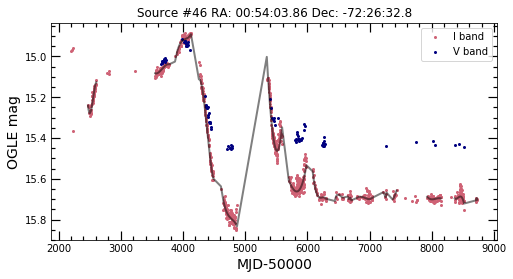

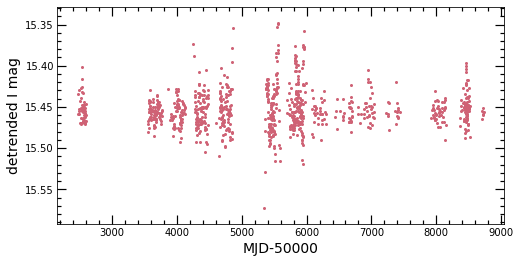

I and V-I correlation: -0.9672844652040792
V and V-I correlation: -0.9138807804196241


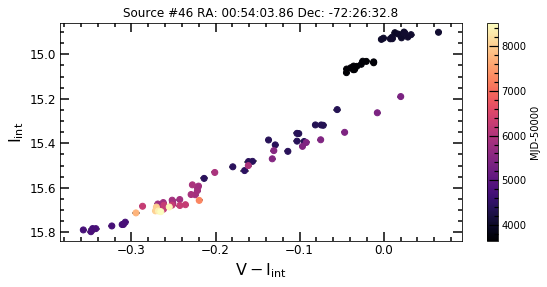

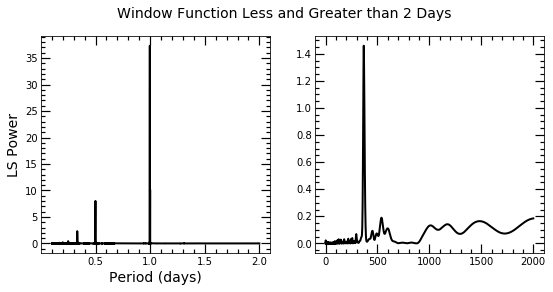

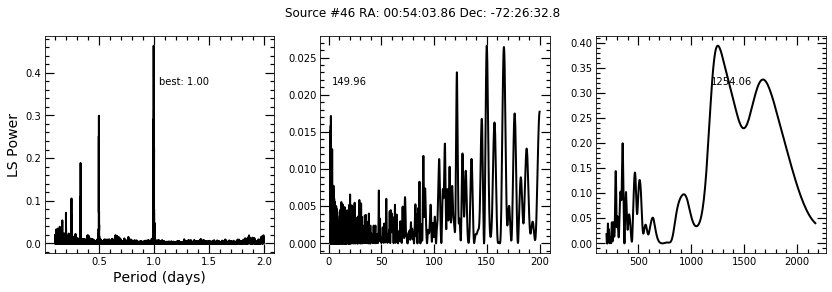

using best period from middle periodogram to phase-fold data, after detrending with 701
running periodogram on detrended data


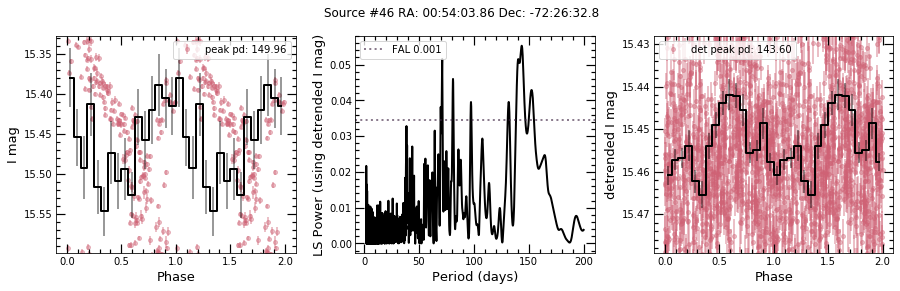

Comparing peaks of 0.1-2 day window function and detrended periodogram...


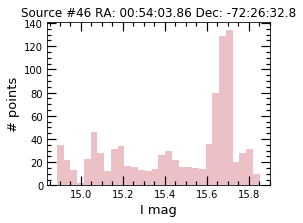



max I band:  15.852
min I band:  14.885
I range:  0.9670000000000005
I stdev:  0.27941029420411756
max V band:  15.455
min V band:  14.916
V range:  0.5389999999999997
V stdev:  0.18735377631635822


In [41]:
#added info to papertable
reload(o)
basic(42,pbins=16,saveall=save)

# Examples of Source Summaries

In [42]:
save = True #can just set here whether to save figs below

Original source number: 2
Current source number: 1
RA,Dec (deg): 20.41893, -72.95907
Established period: 84.0
NS spin period: 2.165
Separation: 2.147142505236131


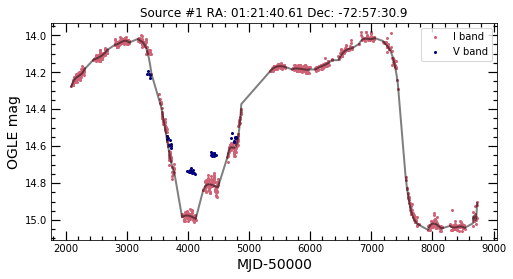

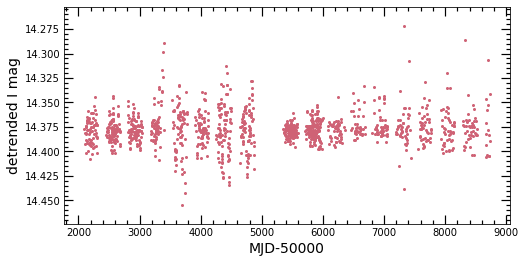

I and V-I correlation: -0.9846799925699677
V and V-I correlation: -0.9546678612457401


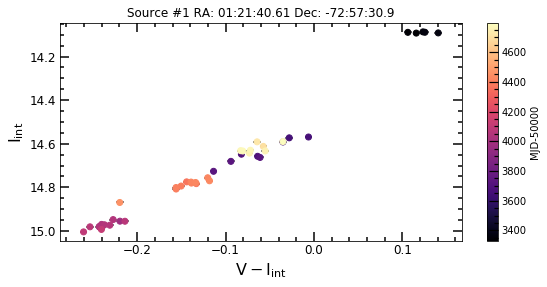

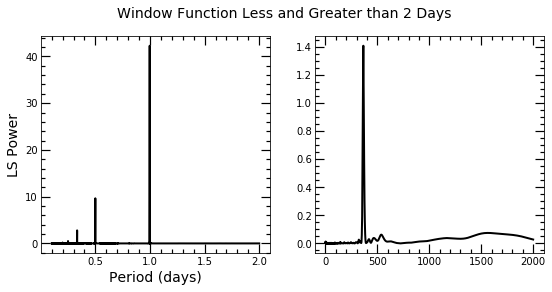

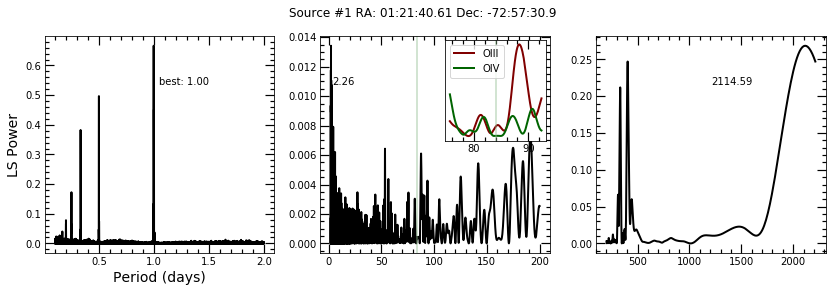

Phase-folding with established orbital period and highest peak within 8.40 days of that value...


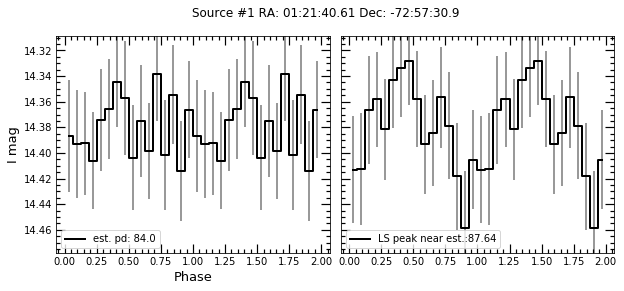

Repeating periodogram and phase-fold after detrending
Window shown in phase-fold: 168


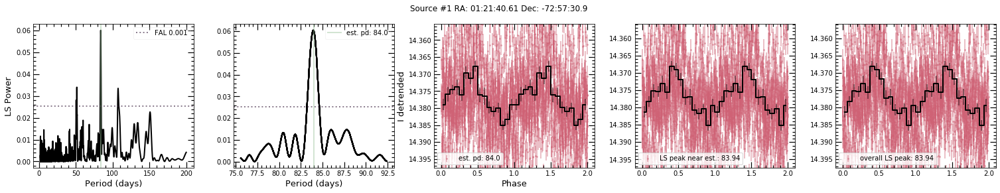

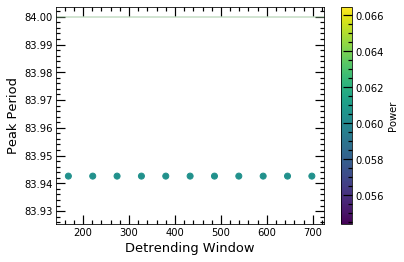

Comparing peaks of 0.1-2 day window function and detrended periodogram...
Beat period of highest peaks is 83.98452276751794.
There is at least one alias of the 0.1-2 day detrended search within a day of the established period.
There is at least one alias of the 0.1-2 day window function within a day of the established period.


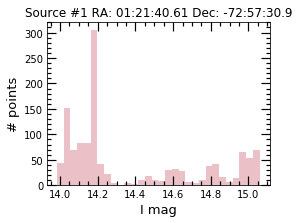



max I band:  15.06
min I band:  13.983
I range:  1.077
I stdev:  0.3562511738415938
max V band:  14.753
min V band:  14.195
V range:  0.5579999999999998
V stdev:  0.1525440976517776


In [43]:
reload(o)
#outputs text and figs, adds to summary table, and puts three peak tables into peak_dict (with the key being source number)
basic(0,pbins=16,saveall=save)

#### one figure summarizing original vs. Savitzky-Golay vs. spline for this source
- original light curve with original periodogram and phase-fold (don't need to show points in that case since so varied; maybe just do established phase-fold)
- each detrended light curve (or example with window low but > orb in the case of SG) with corresponding periodograms (a bunch with different windows), phase-fold
    - ideally many periodograms for different windows can use cmap

In [44]:
reload(o)
ilist,vlist = o.getIV(2,cross,plot=False,zooms=False,figsize=(8,4),mult=(3,8),offset=10,stack=False,save=False)
iband,vband = vstack(ilist),vstack(vlist)
flatten, trend = wotan.flatten(iband['MJD-50000'],iband['I mag'],method='rspline',window_length=701,break_tolerance=50,return_trend=True)
        
#add detrended column: original - trend + mean
mean = np.mean(iband['I mag'])
detr = iband['I mag'] - trend + mean
iband['I spline'] = detr
#for periodogram, use temp table that takes out nan detrended values
itemp = iband[np.isnan(iband['I spline'])==False]
itemp = itemp[np.abs(itemp['I spline']-mean)<1]

#SG detrended
o.detrend(iband,window=101)

#periodogram for original
ofreq,opower,obp = o.periodogram(iband,minp=2,maxp=200,det=False,more=True,plot=False,fap=False)

#a bunch of periodograms for each of spline and SG (looping thru windows)
windows = np.arange(21,721,20) #probably plot the two bounds?
#gfreqs,gpowers,gps,sfreqs,spowers,sbps = [],[],[],[],[],[]
gfreqs,gpowers,gps = [],[],[]

for i in windows:
    o.detrend(iband,window=i)
    gfreq,gpower,gbp = o.periodogram(iband,minp=2,maxp=200,det=True,more=True,plot=False,fap=False)
    gfreqs.append(gfreq)
    gpowers.append(gpower)
    gps.append(gbp)

sfreq,spower,sbp = o.periodogram(itemp,minp=2,maxp=200,manualy='I spline',det=False,more=True,plot=False,fap=False)

o.detrend(iband,window=101) #back to one plotted
#phase-folds
omid,oavg,oerr = o.meanphase(iband,84,pbins=16,det=False,double=True,divide=True,sterr=True,stdev=True)
gmid,gavg,gerr = o.meanphase(iband,84,pbins=16,det=True,double=True,divide=True,sterr=True,stdev=True)
smid,savg,serr = o.meanphase(itemp,84,pbins=16,det=False,manualy='I spline',double=True,divide=True,sterr=True,stdev=True)

In [45]:
import cmasher as cmr

colo = cmr.take_cmap_colors('cmr.emerald', len(gfreqs), cmap_range=(0.3, 0.8), return_fmt='hex')

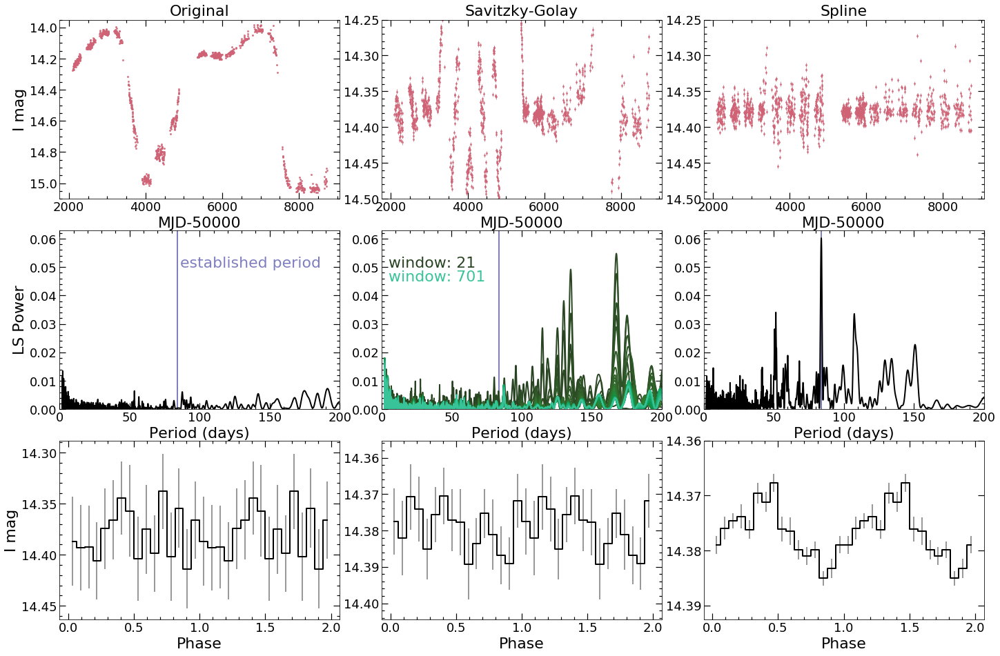

In [46]:
#all in one: 3x3 with light curve, periodogram, phase-fold
fig, ax = plt.subplots(3,3,figsize=(24,16))
plt.subplots_adjust(hspace=0.175,wspace=0.15)
ax[0][0].set_title('Original',fontsize=22)
ax[0][0].set_ylabel('I mag',fontsize=22)
for i in range(3): ax[0][i].set_xlabel(r'MJD-50000',fontsize=22)
ax[0][1].set_title('Savitzky-Golay',fontsize=22)
ax[0][2].set_title('Spline',fontsize=22)


ax[0][0].errorbar(iband['MJD-50000'],iband['I mag'],yerr=iband['I mag err'],ls='none',marker='o',alpha=0.7,markersize=2,color=pink,elinewidth=1)
ax[0][0].set_ylim(15.1,13.95)

ax[0][1].errorbar(iband['MJD-50000'],iband['I detrend'],yerr=iband['I mag err'],ls='none',marker='o',alpha=0.7,markersize=2,color=pink,elinewidth=1) #101 window
ax[0][1].set_ylim(14.5,14.25)

ax[0][2].errorbar(iband['MJD-50000'],iband['I spline'],yerr=iband['I mag err'],ls='none',marker='o',alpha=0.7,markersize=2,color=pink,elinewidth=1)
ax[0][2].set_ylim(14.5,14.25)

ax[1][0].plot(1./ofreq,opower,color='black')
#loop through S-G windows
for i in range(len(gfreqs)):
    ax[1][1].plot(1./gfreqs[i],gpowers[i],color=colo[i])
ax[1][1].text(5,0.05,f'window: {np.min(windows)}',color=colo[0],fontsize=22)
ax[1][1].text(5,0.045,f'window: {np.max(windows)}',color=colo[i],fontsize=22)

ax[1][2].plot(1./sfreq,spower,color='black')
for i in range(3): ax[1][i].set_xlabel(r'Period (days)',fontsize=22)
ax[1][0].set_ylabel(r'LS Power',fontsize=22)
ax[1][0].text(86,0.05,'established period',fontsize=22,color='navy',alpha=.5)

for i in range(3): 
    ax[1][i].set_ylim(0,0.063)
    ax[1][i].set_xlim(0,200)
    ax[1][i].axvline(84,color='navy',zorder=1,alpha=.5)


for i in range(3): ax[2][i].set_xlabel('Phase',fontsize=22)
ax[2][0].set_ylabel('I mag',fontsize=22)
    
    
#phase-folded data
ax[2][0].step(omid,oavg,where='mid',color='black')
ax[2][0].errorbar(omid,oavg,yerr=oerr,ls='none',color='black',alpha=0.4)
maxa,mina = np.max(oavg)+np.max(oerr),np.min(oavg)-np.max(oerr)
ax[2][0].set_ylim(maxa+0.005,mina-0.005)

ax[2][1].step(gmid,gavg,where='mid',color='black')
ax[2][1].errorbar(gmid,gavg,yerr=gerr,ls='none',color='black',alpha=0.4)
maxa,mina = np.max(gavg)+np.max(gerr),np.min(gavg)-np.max(gerr)
ax[2][1].set_ylim(maxa+0.005,mina-0.005)

ax[2][2].step(smid,savg,where='mid',color='black')
ax[2][2].errorbar(smid,savg,yerr=serr,ls='none',color='black',alpha=0.4)
maxa,mina = np.max(savg)+np.max(serr),np.min(savg)-np.max(serr)
ax[2][2].set_ylim(maxa+0.005,mina-0.005)
ax[2][2].set_yticks(np.arange(14.392,14.36,.002), minor = True)
ax[2][2].set_yticks([14.39,14.38,14.37,14.36])
# ax[2][2].minorticks_on()
ax[2][2].tick_params(which = 'both', direction = 'in')

#make all axis labels bigger
for i in range(3):
    for j in range(3):
        ax[i][j].tick_params(axis='both', which='major', labelsize=18)

# plt.savefig('spline_examples/src2_draft2.pdf',bbox_inches='tight')

#### now test out alias function

In [47]:
#first few periods from second periodogram
arrt = aliasarr(peak_dict[2][1][:5]['period'],nrange=1,cutzero=False)
arrt

array([[1.79210514, 1.8751049 , 1.85249435, 1.69790338, 1.52124078],
       [2.26245867, 2.14272015, 2.1730283 , 2.43286309, 2.91849915],
       [0.69348271, 0.68180431, 0.68484366, 0.70869797, 0.74480025]])

In [48]:
#takes out array where n = 0 (so just original periods given)
arrt = aliasarr(peak_dict[2][1][:5]['period'],nrange=1)
arrt

array([[1.79210514, 1.8751049 , 1.85249435, 1.69790338, 1.52124078],
       [0.69348271, 0.68180431, 0.68484366, 0.70869797, 0.74480025]])

In [49]:
#periods from third periodogram
arrt = aliasarr(peak_dict[2][2][:5]['period'],nrange=2)
arrt #predicts the alias at .9975 and .49938

array([[0.50011825, 0.50061901, 0.50075266, 0.50080402, 0.50056466],
       [1.00047313, 1.00247909, 1.00301517, 1.00322128, 1.00226119],
       [0.99952732, 0.99753314, 0.9970029 , 0.99679934, 0.99774899],
       [0.4998818 , 0.49938252, 0.4992496 , 0.49919855, 0.49943661]])

Original source number: 22
Current source number: 20
RA,Dec (deg): 17.785799, -73.279465
Established period: 90.5
NS spin period: 31.03
Separation: 0.23502474081500227


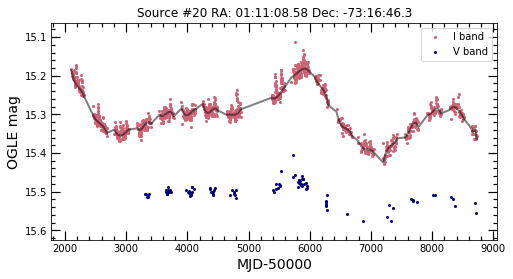

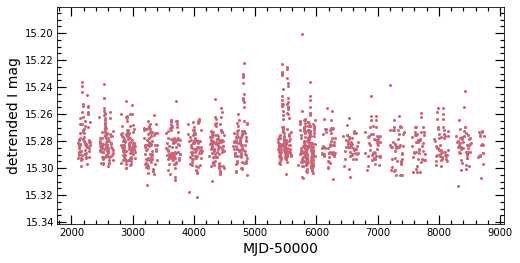

I and V-I correlation: -0.9136655015697079
V and V-I correlation: -0.42999300788629347


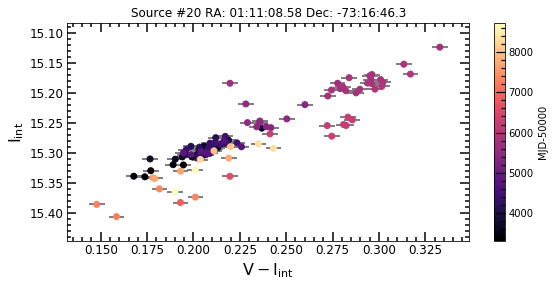

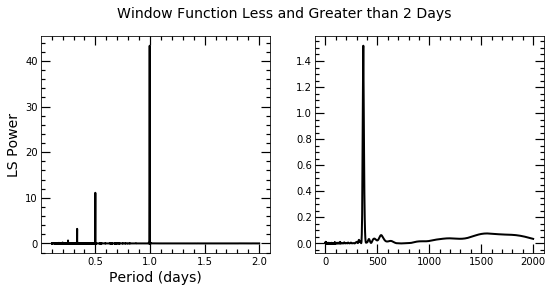

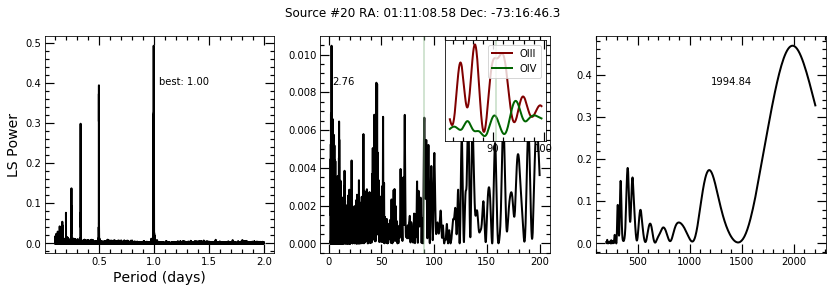

Phase-folding with established orbital period and highest peak within 9.05 days of that value...


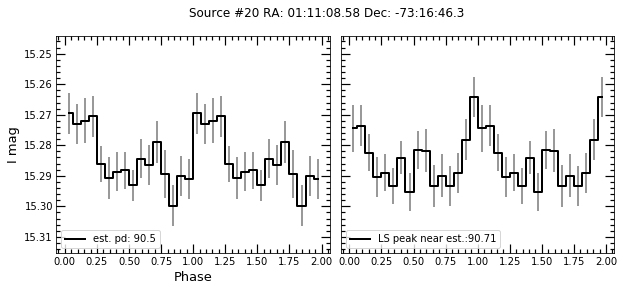

Repeating periodogram and phase-fold after detrending
Window shown in phase-fold: 181


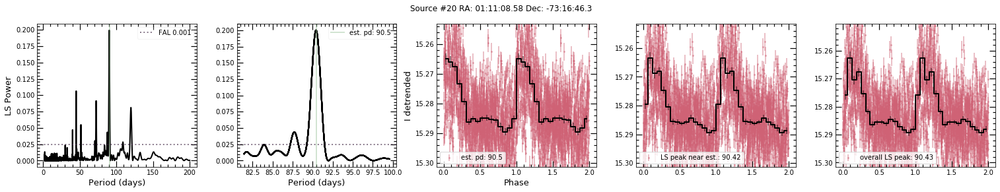

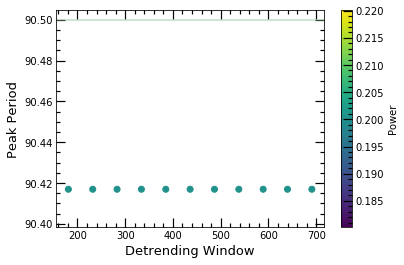

Comparing peaks of 0.1-2 day window function and detrended periodogram...
Beat period of highest peaks is 90.40205555555501.
There is at least one alias of the 0.1-2 day detrended search within a day of the established period.
There is at least one alias of the 0.1-2 day window function within a day of the established period.


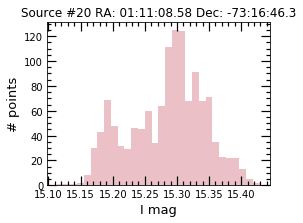



max I band:  15.429
min I band:  15.113
I range:  0.3160000000000007
I stdev:  0.05909596374360111
max V band:  15.576
min V band:  15.404
V range:  0.1720000000000006
V stdev:  0.025547074471517377


In [50]:
basic(17,pbins=16,saveall=save,window=101)

In [51]:
phase[20:25]

,src_n,period,amp,phase diff,phase max,phase min,shape,diff mean,mean,skew,kurtosis,symm sum,mean err,aperiodic quiescence
20,22,90.416963,0.025827,0.8125,0.90625,0.09375,FRED,0.008084,15.281285,-1.058761,-0.277492,0.008382,0.001207,NO
21,23,137.916601,0.028804,0.5000,0.09375,0.59375,not FRED,0.005393,14.682610,-2.171514,3.468618,0.003319,0.001191,NO
22,24,60.913413,0.010831,0.4375,0.34375,0.90625,FRED,0.004805,15.330734,-0.174057,-0.890795,0.000093,0.001253,NO
23,25,110.846115,0.102492,0.1250,0.21875,0.09375,not FRED,0.028246,15.882744,-1.639872,2.121753,0.010182,0.003930,NO
24,26,33.406866,0.019028,0.3750,0.28125,0.90625,FRED,0.007493,16.694209,-0.485540,-1.036721,0.003809,0.001742,NO


Original source number: 31
Current source number: 28
RA,Dec (deg): 13.35, -72.454445
Established period: 103.6
NS spin period: 138.0
Separation: 1.1629397680176692


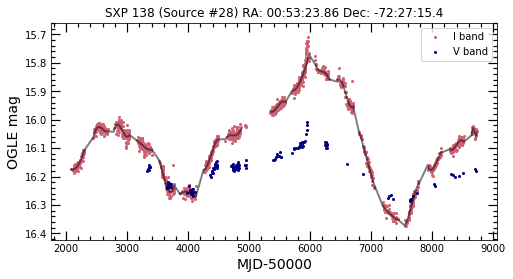

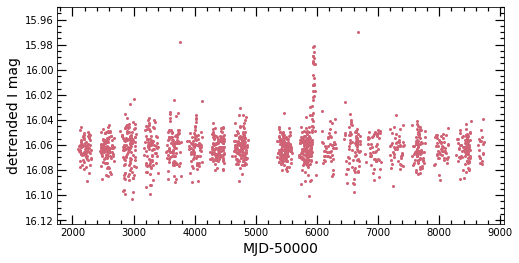

I and V-I correlation: -0.9926580142506026
V and V-I correlation: -0.9549740785369608


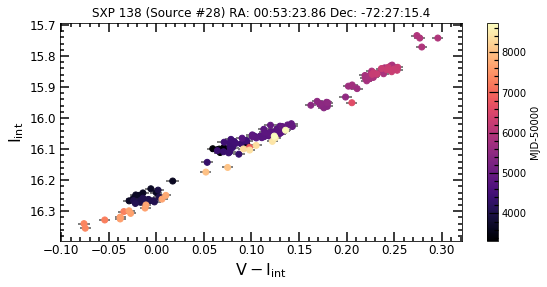

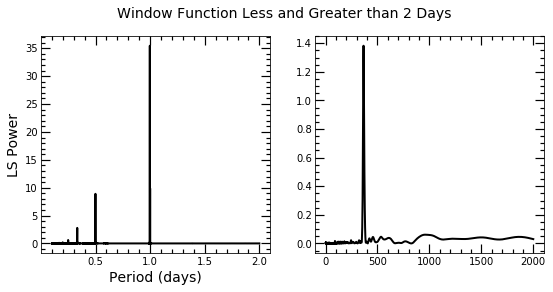

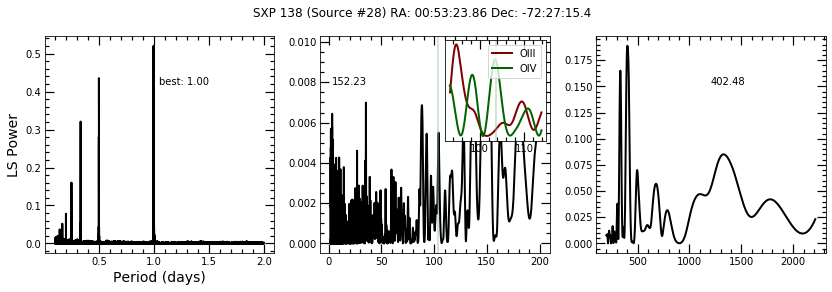

Phase-folding with established orbital period and highest peak within 10.36 days of that value...


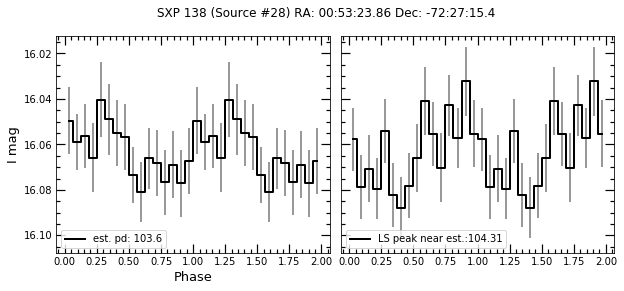

Repeating periodogram and phase-fold after detrending
Window shown in phase-fold: 207


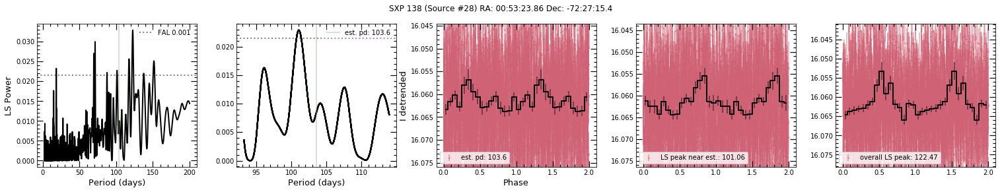

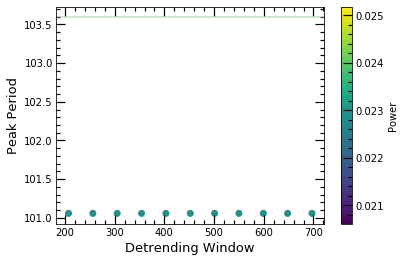

Comparing peaks of 0.1-2 day window function and detrended periodogram...
There is at least one alias of the 0.1-2 day detrended search within a day of the established period.
There is at least one alias of the 0.1-2 day window function within a day of the established period.


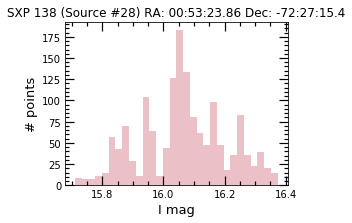



max I band:  16.374
min I band:  15.71
I range:  0.6639999999999979
I stdev:  0.14025190573691002
max V band:  16.287
min V band:  16.008
V range:  0.2789999999999999
V stdev:  0.06042549284753631


In [52]:
basic(25,pbins=16,window=300,spline=True,saveall=save) #compare to S-G detrending

Original source number: 64
Current source number: 59
RA,Dec (deg): 15.906292, -72.0258
Established period: nan
NS spin period: 1323.0
Separation: 0.3875389193454174


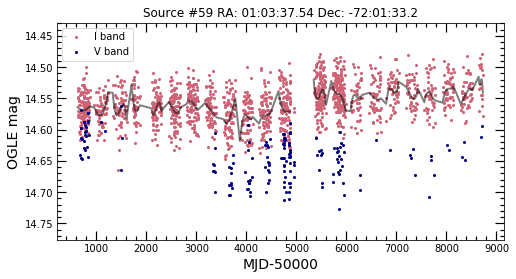

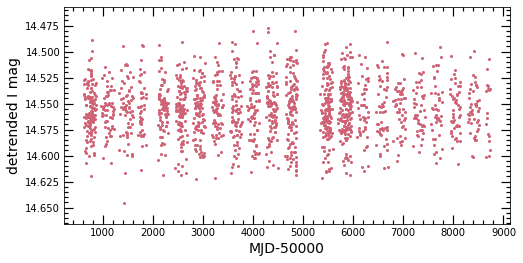

I and V-I correlation: -0.4388904144939015
V and V-I correlation: 0.5195263979783094


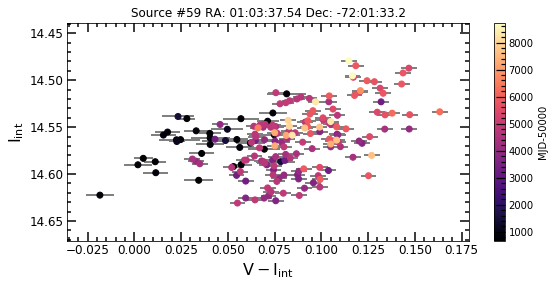

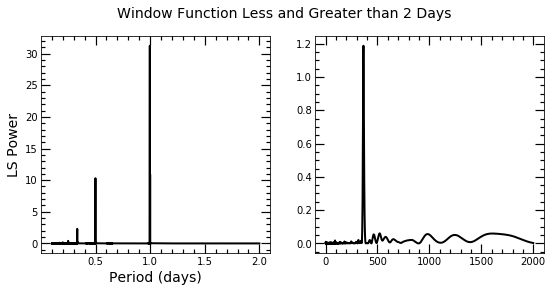

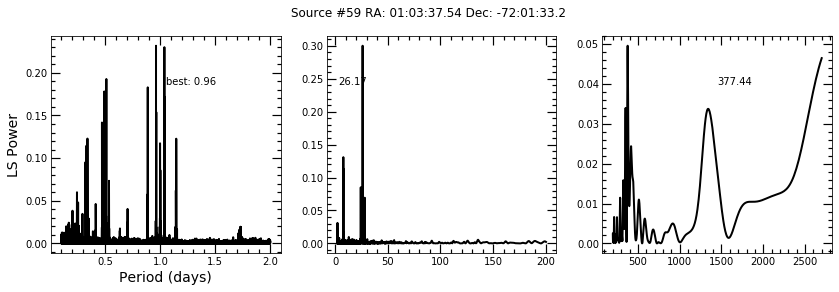

using best period from middle periodogram to phase-fold data, after detrending with 700
running periodogram on detrended data


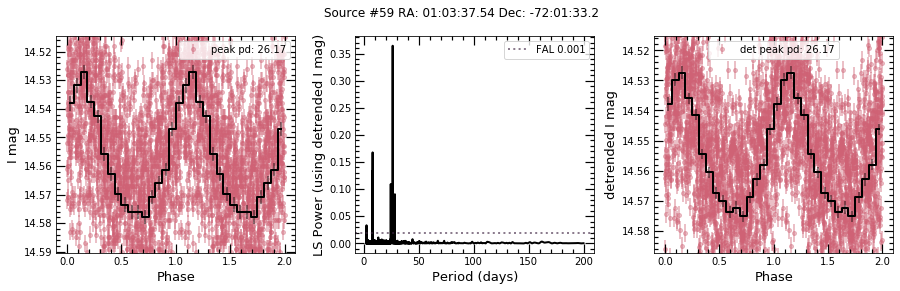

Comparing peaks of 0.1-2 day window function and detrended periodogram...
Beat period of highest peaks is 26.172391204601244.
There is at least one alias of the 0.1-2 day detrended search within a day of 26.17415389617869 days (the detrended peak).
There is at least one alias of the 0.1-2 day window function within a day of 26.17415389617869 days (the detrended peak).


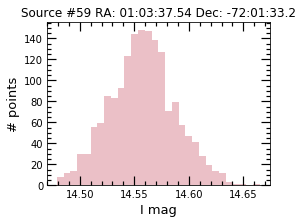



max I band:  14.665
min I band:  14.479
I range:  0.18599999999999994
I stdev:  0.02984407479612393
max V band:  14.727
min V band:  14.562
V range:  0.16500000000000092
V stdev:  0.03415353164324986


In [53]:
#example of source with no established period
basic(54,pbins=16,saveall=save,window=700) #questionable spline fit but works well

# Now Go Through Sources in Order
- above are good sort of test cases/random examples
- skip 54,25,17,0

In [54]:
save = True

Original source number: 3
Current source number: 2
RA,Dec (deg): 13.639167, -73.68364
Established period: 18.38
NS spin period: 2.37
Separation: 0.2597014565010407


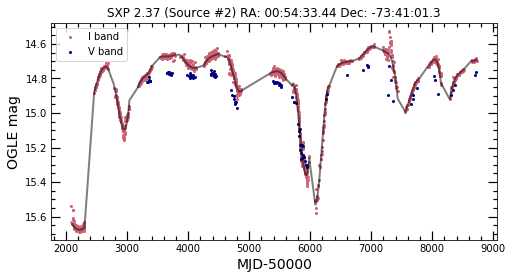

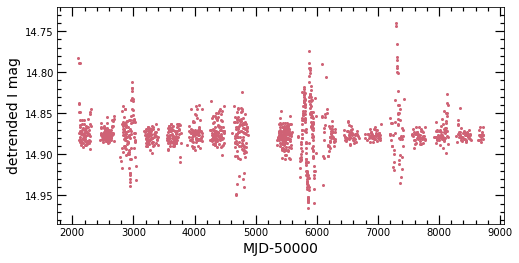

I and V-I correlation: -0.8002922261337712
V and V-I correlation: -0.6698593996852642


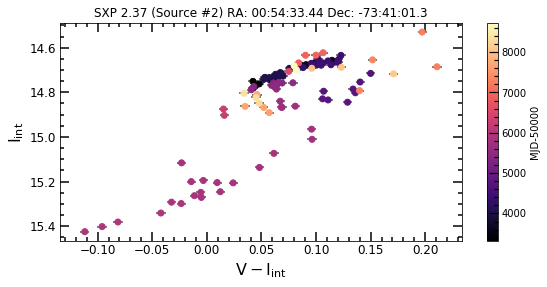

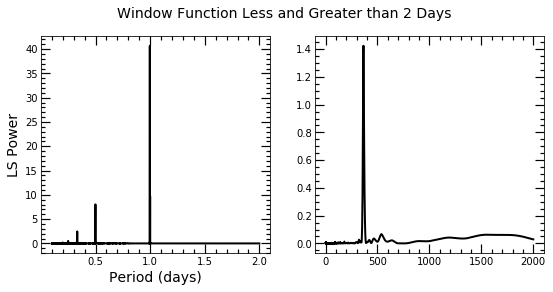

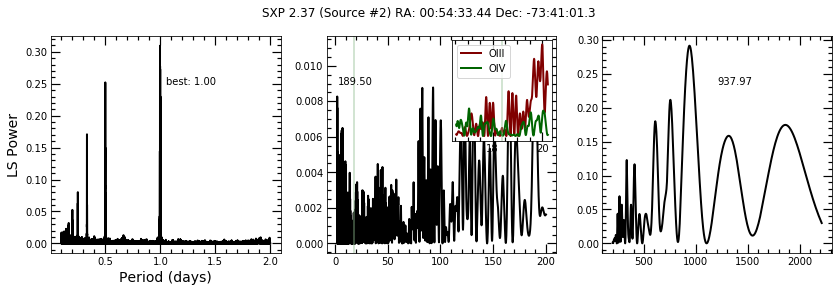

Phase-folding with established orbital period and highest peak within 1.84 days of that value...


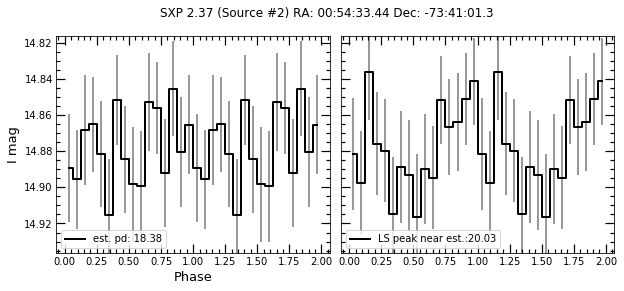

Repeating periodogram and phase-fold after detrending
Window shown in phase-fold: 36


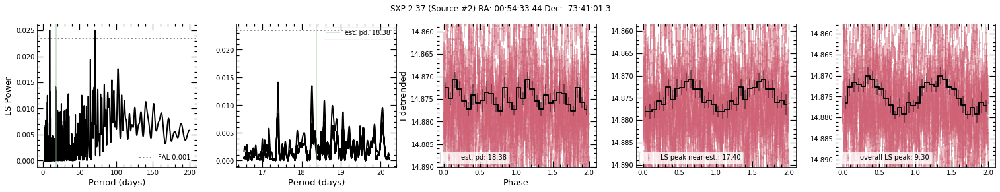

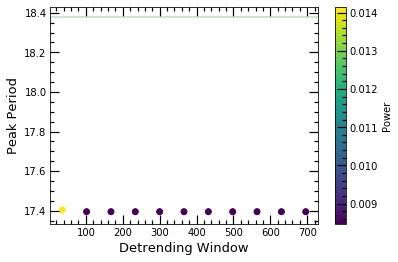

Comparing peaks of 0.1-2 day window function and detrended periodogram...


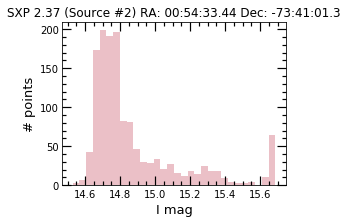



max I band:  15.687
min I band:  14.528
I range:  1.158999999999999
I stdev:  0.26736930281019916
max V band:  15.313
min V band:  14.724
V range:  0.5890000000000004
V stdev:  0.16383883256098614


In [55]:
basic(1,pbins=16,saveall=save)

Original source number: 4
Current source number: 3
RA,Dec (deg): 14.797429, -71.64596
Established period: 82.37
NS spin period: 2.763
Separation: nan


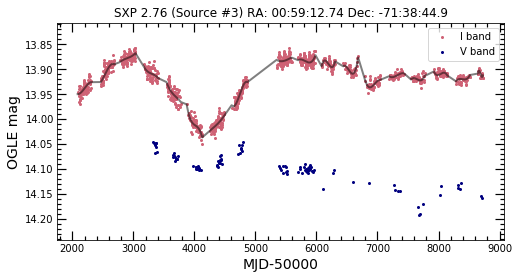

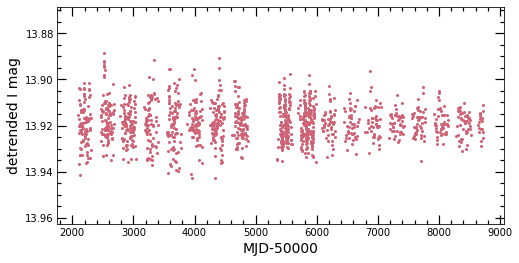

I and V-I correlation: -0.883934340856408
V and V-I correlation: 0.6471296353848744


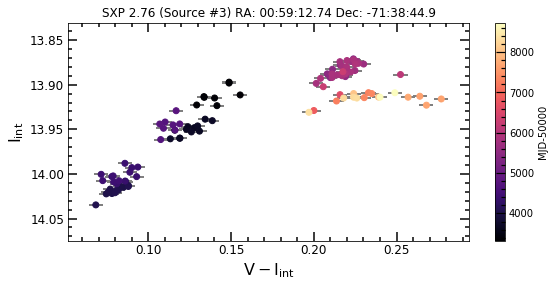

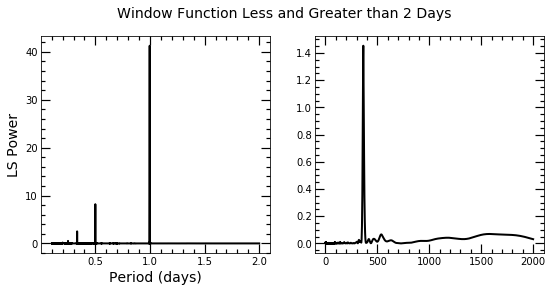

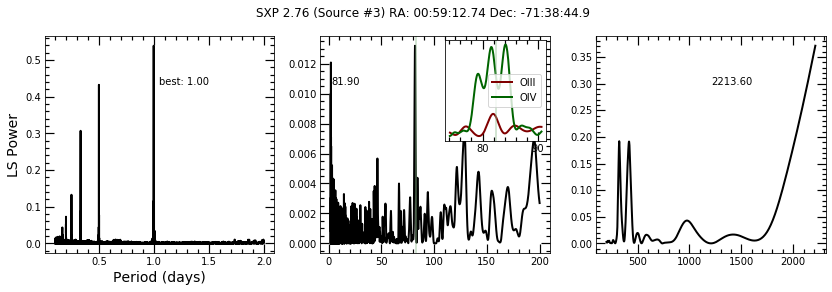

Phase-folding with established orbital period and highest peak within 8.24 days of that value...


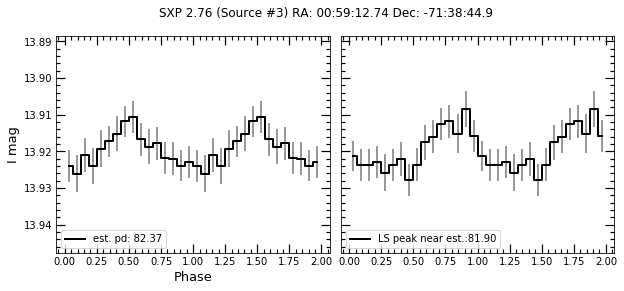

Repeating periodogram and phase-fold after detrending
Window shown in phase-fold: 164


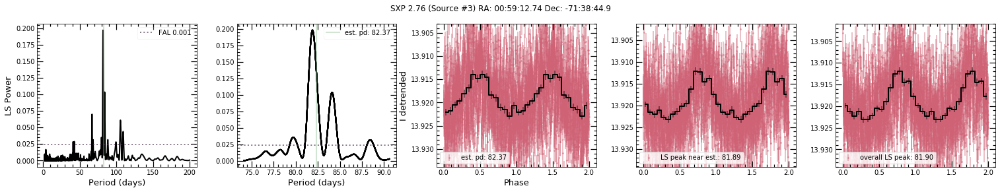

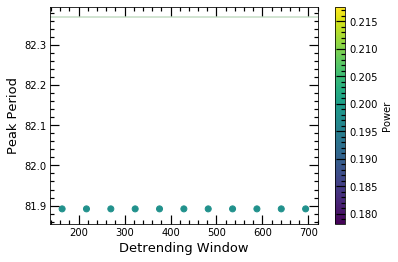

Comparing peaks of 0.1-2 day window function and detrended periodogram...
Beat period of highest peaks is 81.84372972640054.
There is at least one alias of the 0.1-2 day detrended search within a day of the established period.
There is at least one alias of the 0.1-2 day window function within a day of the established period.


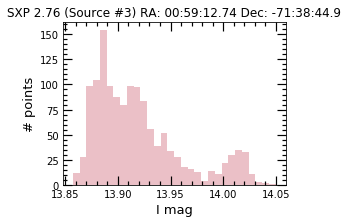



max I band:  14.05
min I band:  13.857
I range:  0.1930000000000014
I stdev:  0.04226374636920003
max V band:  14.193
min V band:  14.046
V range:  0.14700000000000024
V stdev:  0.030116076714736872


In [56]:
basic(2,pbins=16,saveall=save)

Original source number: 5
Current source number: 4
RA,Dec (deg): 12.91333, -72.28433
Established period: nan
NS spin period: 4.78
Separation: nan


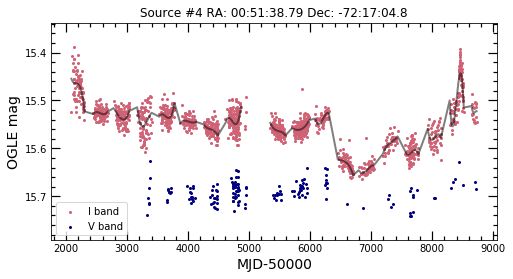

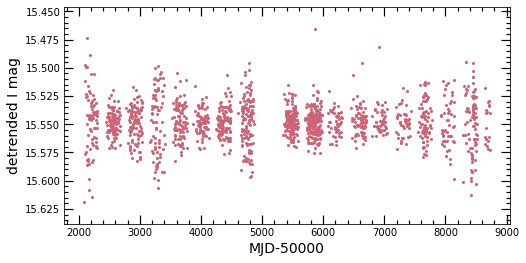

I and V-I correlation: -0.6677821537439047
V and V-I correlation: 0.17975703286765632


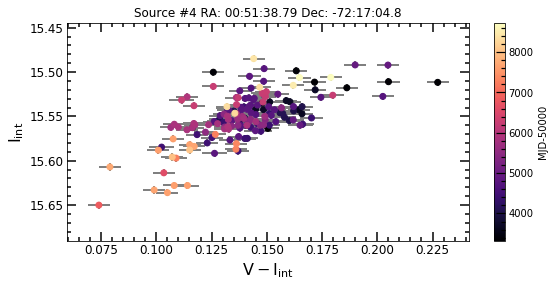

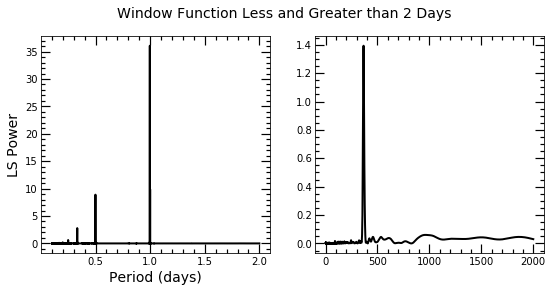

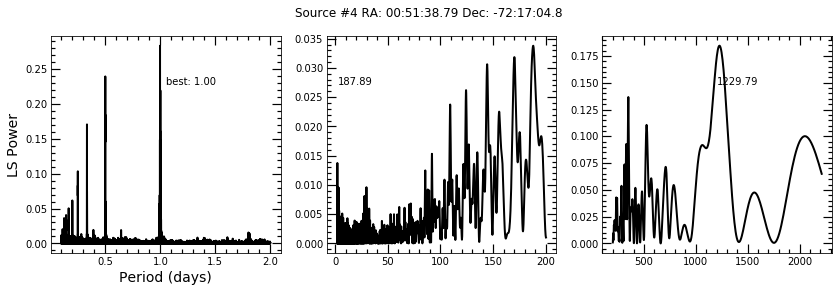

using best period from middle periodogram to phase-fold data, after detrending with 701
running periodogram on detrended data


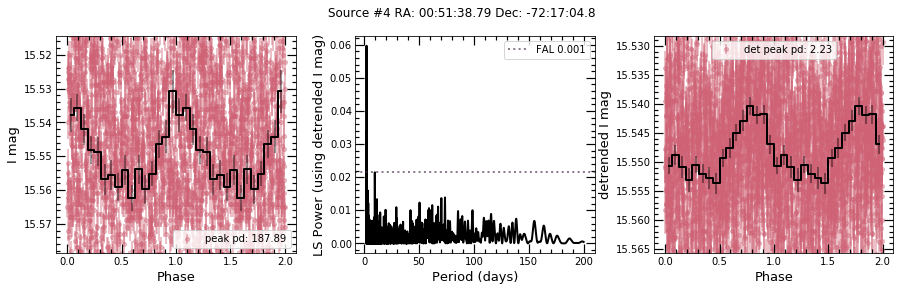

Comparing peaks of 0.1-2 day window function and detrended periodogram...
There is at least one alias of the 0.1-2 day detrended search within a day of 2.2338046936816256 days (the detrended peak).
There is at least one alias of the 0.1-2 day window function within a day of 2.2338046936816256 days (the detrended peak).


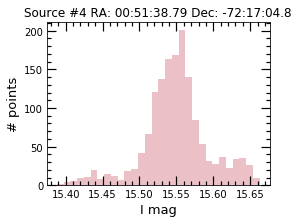



max I band:  15.663
min I band:  15.388
I range:  0.27500000000000036
I stdev:  0.04474693458278388
max V band:  15.742
min V band:  15.626
V range:  0.11600000000000144
V stdev:  0.02089110998022684


In [57]:
basic(3,pbins=16,saveall=save)

Original source number: 6
Current source number: 5
RA,Dec (deg): 14.259583, -72.43188
Established period: 17.2
NS spin period: 5.05
Separation: 0.9025146211539117


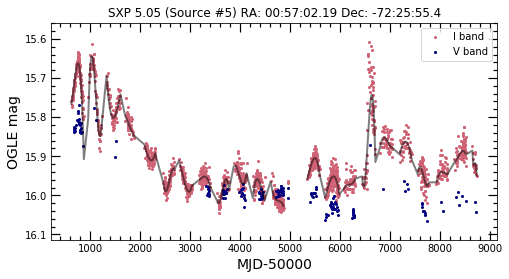

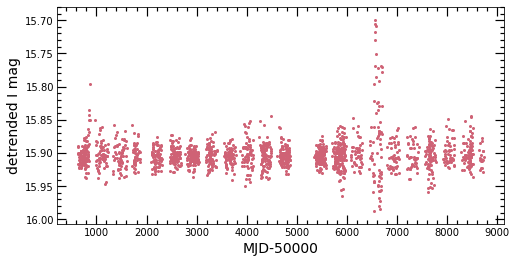

I and V-I correlation: -0.7854401757019701
V and V-I correlation: -0.44726007362846626


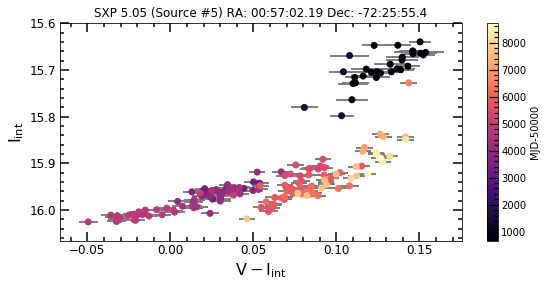

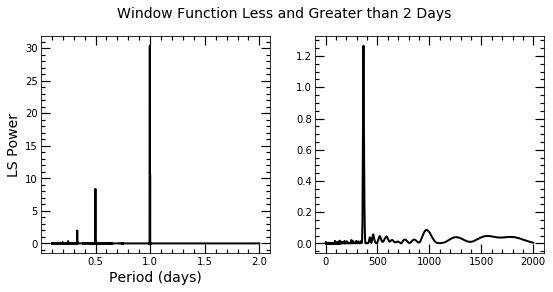

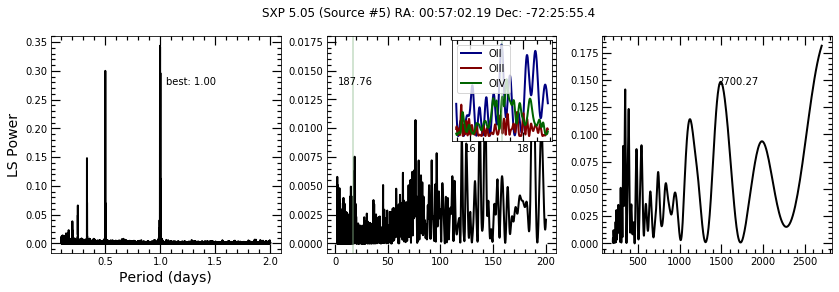

Phase-folding with established orbital period and highest peak within 1.72 days of that value...


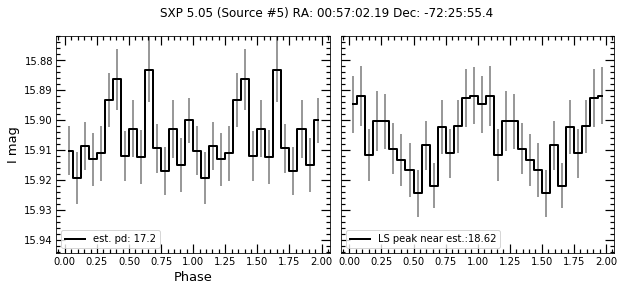

Repeating periodogram and phase-fold after detrending
Window shown in phase-fold: 34


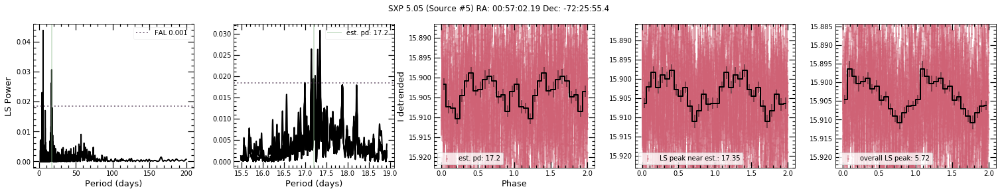

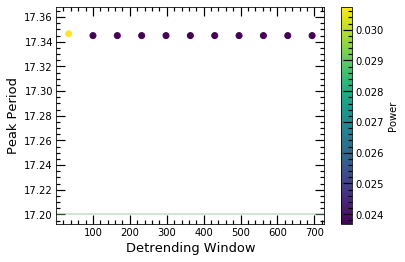

Comparing peaks of 0.1-2 day window function and detrended periodogram...
There is at least one alias of the 0.1-2 day detrended search within a day of the established period.
There is at least one alias of the 0.1-2 day window function within a day of the established period.


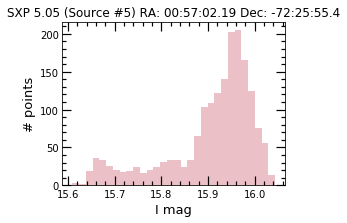



max I band:  16.044
min I band:  15.609
I range:  0.4350000000000005
I stdev:  0.09515404772954368
max V band:  16.065
min V band:  15.77
V range:  0.2950000000000017
V stdev:  0.07522227055363925


In [58]:
basic(4,pbins=16,saveall=save)

Original source number: 7
Current source number: 6
RA,Dec (deg): 15.722455, -72.74299
Established period: 21.9
NS spin period: 6.85
Separation: 0.42128292815575763


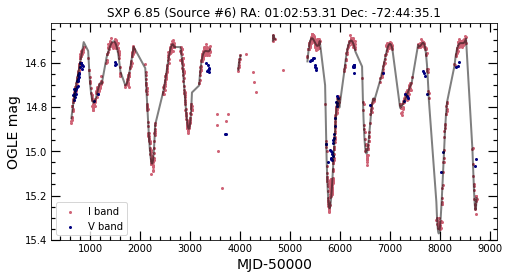

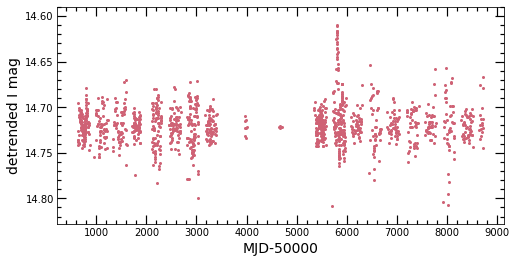

I and V-I correlation: -0.9670343623561133
V and V-I correlation: -0.9225217209125162


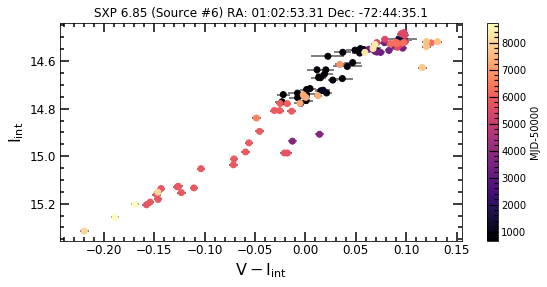

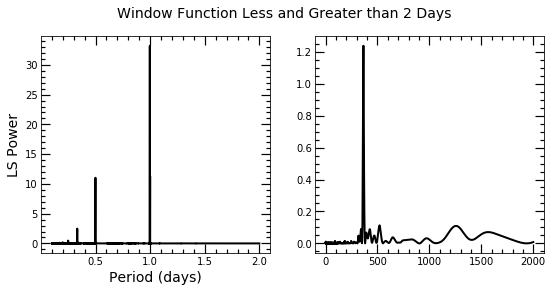

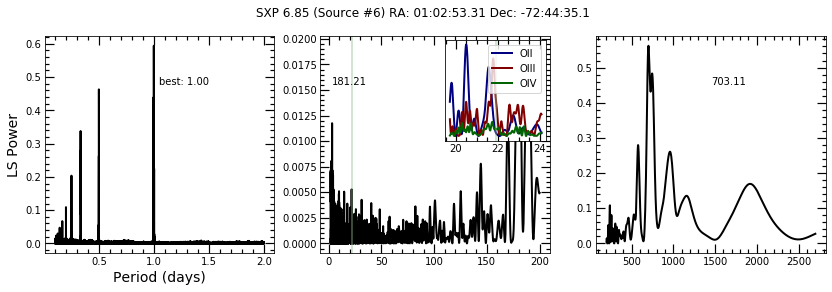

Phase-folding with established orbital period and highest peak within 2.19 days of that value...


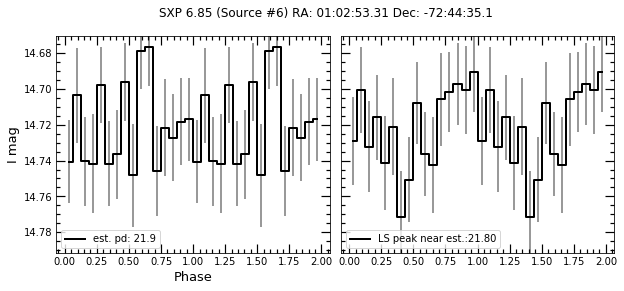

Repeating periodogram and phase-fold after detrending
Window shown in phase-fold: 43


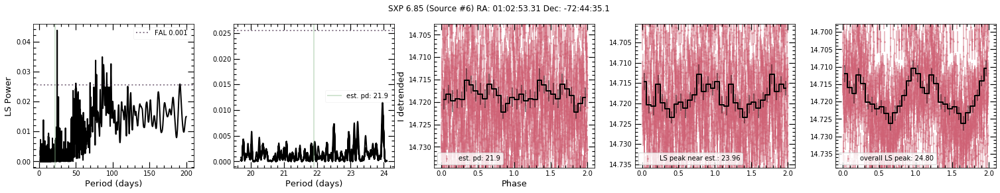

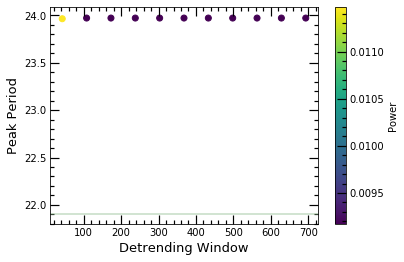

Comparing peaks of 0.1-2 day window function and detrended periodogram...


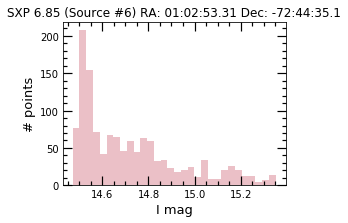



max I band:  15.352
min I band:  14.471
I range:  0.8810000000000002
I stdev:  0.21999887544928126
max V band:  15.096
min V band:  14.578
V range:  0.5180000000000007
V stdev:  0.14997190629598203


In [59]:
basic(5,pbins=16,saveall=save) 

Original source number: 9
Current source number: 8
RA,Dec (deg): 13.02375, -72.43445
Established period: 44.92
NS spin period: 7.78
Separation: 0.1368248900378205


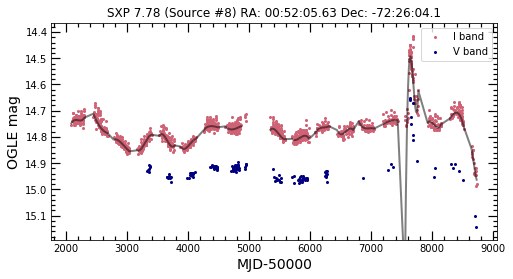

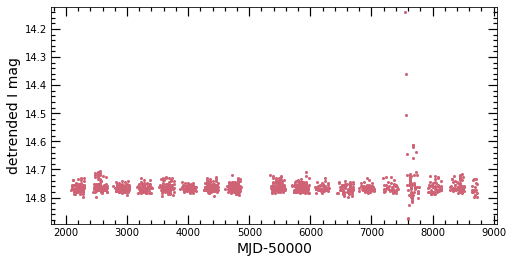

I and V-I correlation: -0.667340526448103
V and V-I correlation: -0.39477937412506486


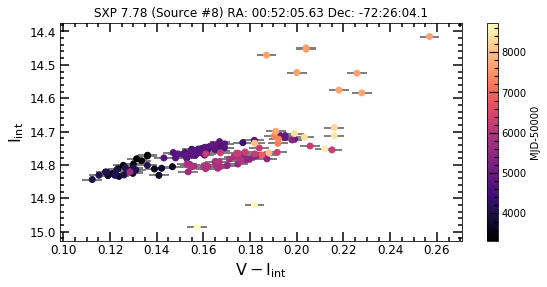

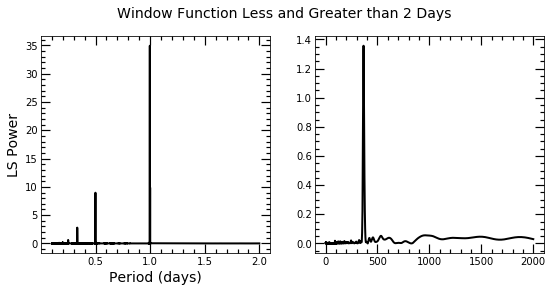

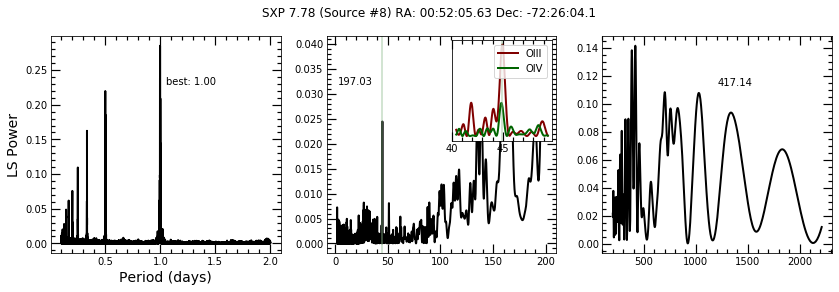

Phase-folding with established orbital period and highest peak within 4.49 days of that value...


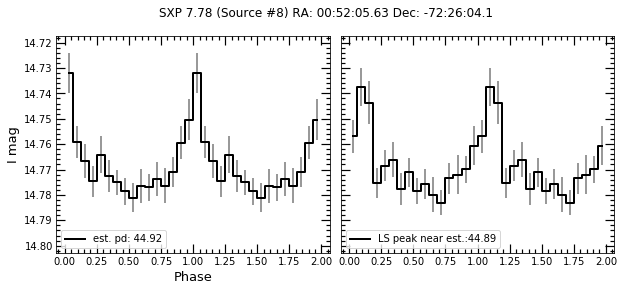

Repeating periodogram and phase-fold after detrending
Window shown in phase-fold: 89


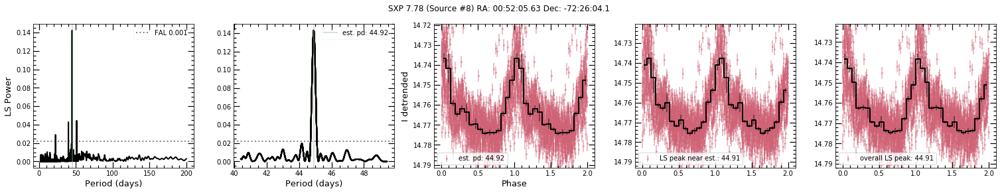

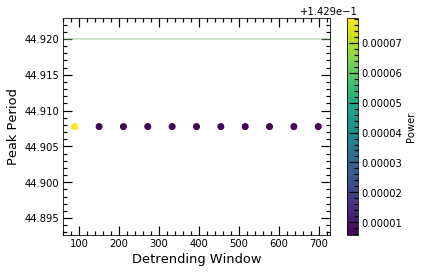

Comparing peaks of 0.1-2 day window function and detrended periodogram...
Beat period of highest peaks is 44.90089729546977.
There is at least one alias of the 0.1-2 day detrended search within a day of the established period.
There is at least one alias of the 0.1-2 day window function within a day of the established period.


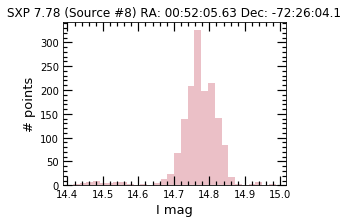



max I band:  14.987
min I band:  14.415
I range:  0.572000000000001
I stdev:  0.06365301931505729
max V band:  15.144
min V band:  14.653
V range:  0.49099999999999966
V stdev:  0.05908053462518116


In [60]:
basic(6,pbins=16,saveall=save) #if there's a point down there, function probs automatic resets it to mean

Original source number: 10
Current source number: 9
RA,Dec (deg): 14.493333, -72.37486
Established period: 40.03
NS spin period: 7.92
Separation: 1.2145301423329555


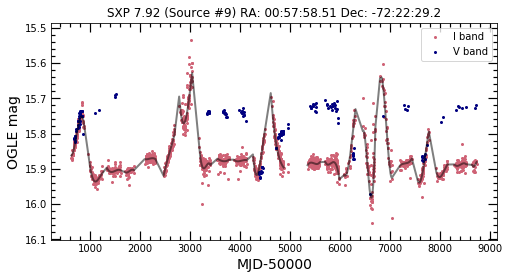

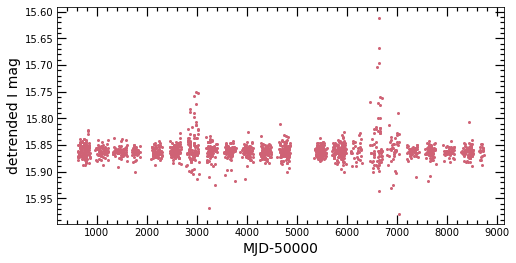

I and V-I correlation: -0.6832617411444406
V and V-I correlation: 0.7737722449334529


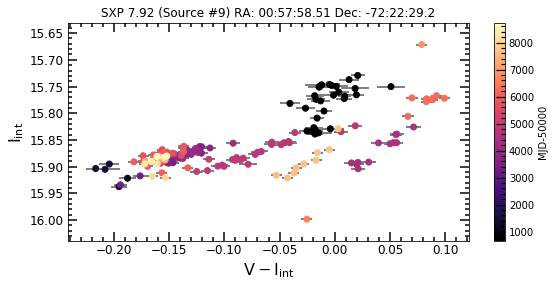

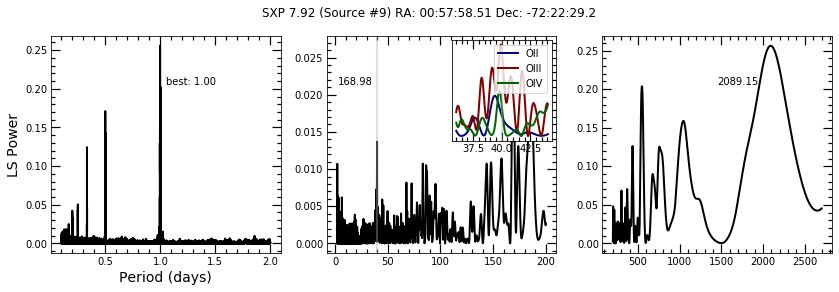

Phase-folding with established orbital period and highest peak within 4.00 days of that value...


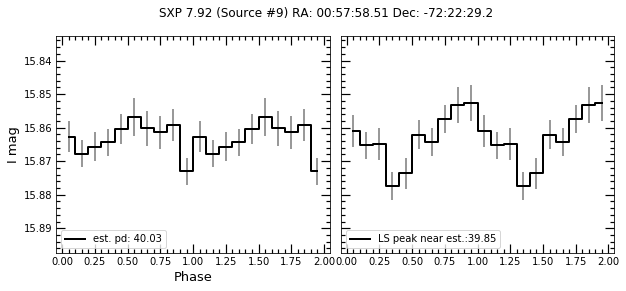

Repeating periodogram and phase-fold after detrending
Window shown in phase-fold: 80


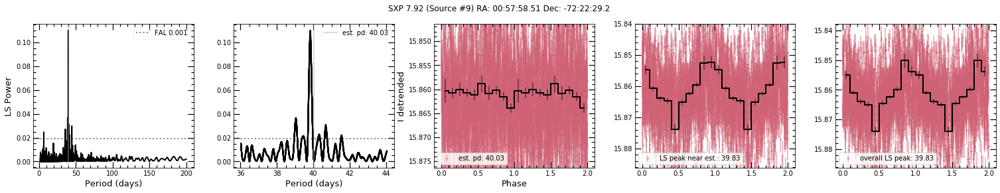

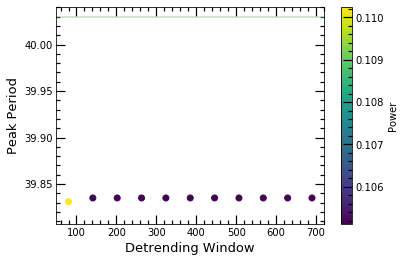

Comparing peaks of 0.1-2 day window function and detrended periodogram...
No peaks found so not searching for beat periods or aliases.


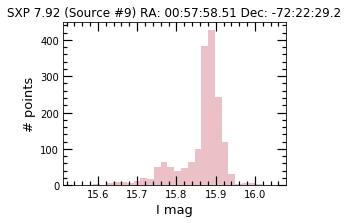



max I band:  16.053
min I band:  15.536
I range:  0.5170000000000012
I stdev:  0.06068029889096733
max V band:  15.973
min V band:  15.687
V range:  0.28600000000000136
V stdev:  0.06012007025959454


In [64]:
basic(7,pbins=10,saveall=save,window=300) 

Original source number: 11
Current source number: 10
RA,Dec (deg): 12.971667, -72.53
Established period: 28.51
NS spin period: 8.9
Separation: 0.522346798389768


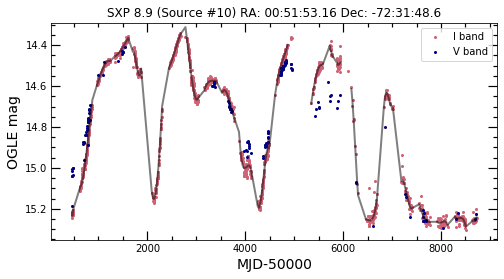

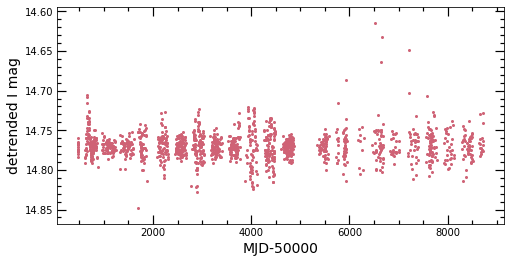

I and V-I correlation: -0.6772792774073827
V and V-I correlation: -0.42451937262899136


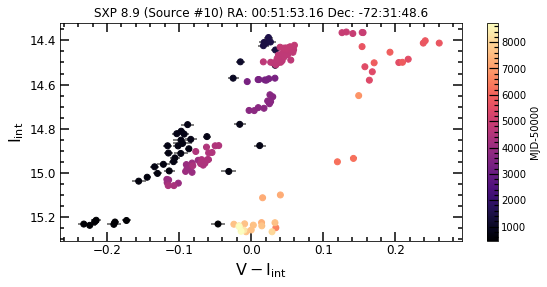

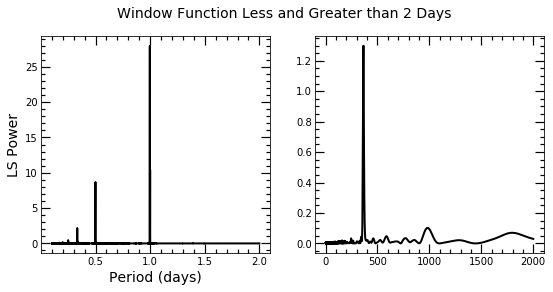

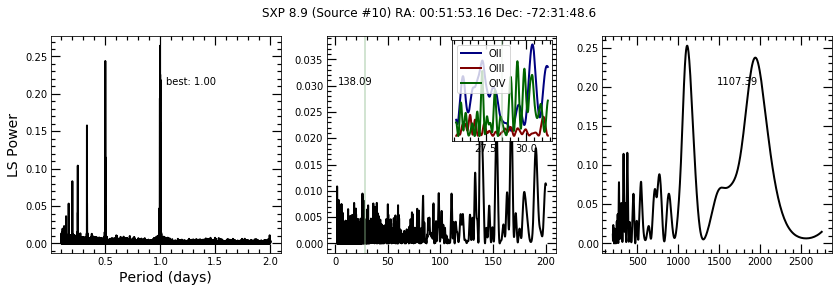

Phase-folding with established orbital period and highest peak within 2.85 days of that value...


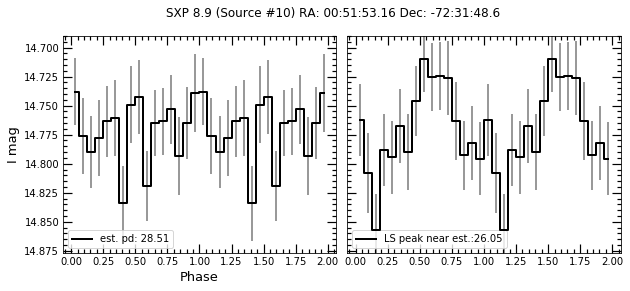

Repeating periodogram and phase-fold after detrending
Window shown in phase-fold: 57


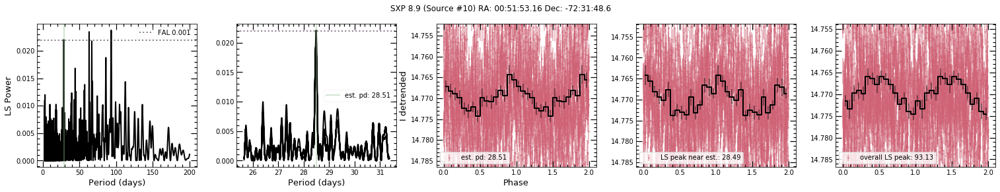

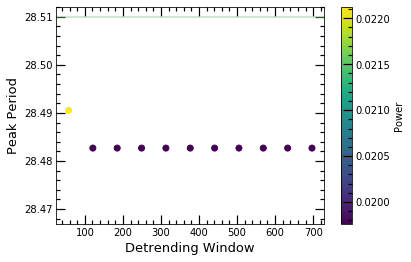

Comparing peaks of 0.1-2 day window function and detrended periodogram...
There is at least one alias of the 0.1-2 day detrended search within a day of the established period.
There is at least one alias of the 0.1-2 day window function within a day of the established period.


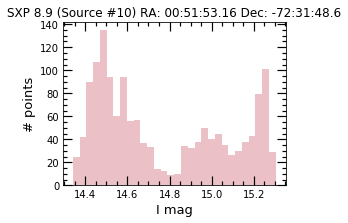



max I band:  15.304
min I band:  14.341
I range:  0.963000000000001
I stdev:  0.3037076832880229
max V band:  15.295
min V band:  14.411
V range:  0.8840000000000003
V stdev:  0.23600339965440648


In [65]:
basic(8,pbins=16,saveall=save) 

Original source number: 12
Current source number: 11
RA,Dec (deg): 12.327084, -73.20028
Established period: 77.2
NS spin period: 9.13
Separation: nan


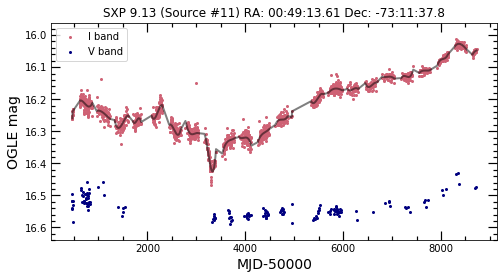

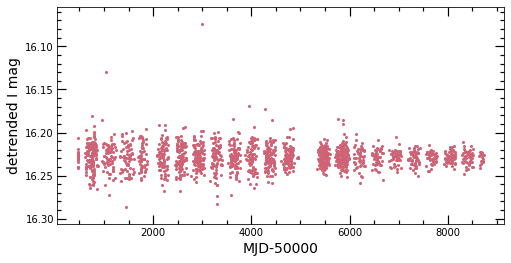

I and V-I correlation: -0.932428467980274
V and V-I correlation: -0.2515816687525331


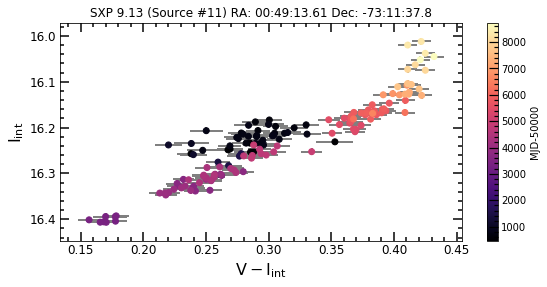

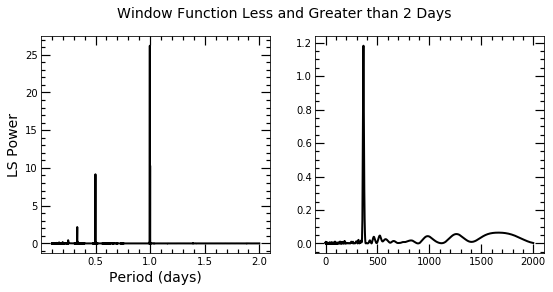

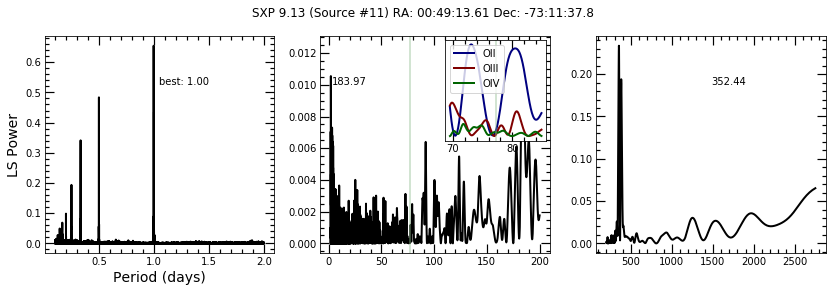

Phase-folding with established orbital period and highest peak within 7.72 days of that value...


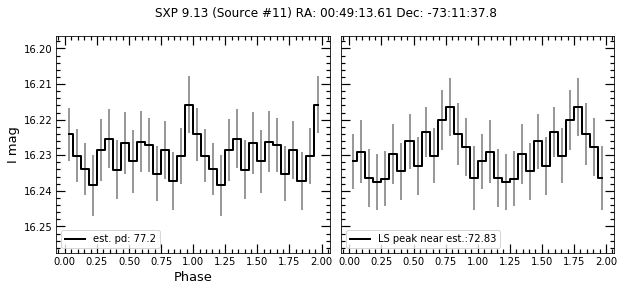

Repeating periodogram and phase-fold after detrending
Window shown in phase-fold: 154


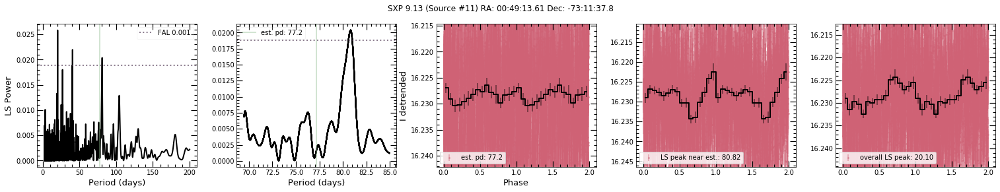

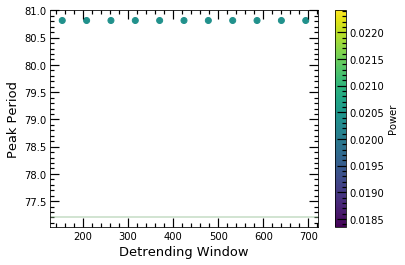

Comparing peaks of 0.1-2 day window function and detrended periodogram...


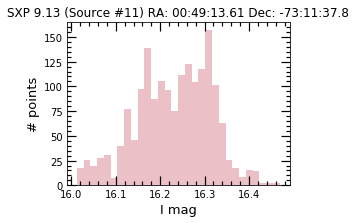



max I band:  16.469
min I band:  16.012
I range:  0.45700000000000074
I stdev:  0.08472090375763396
max V band:  16.59
min V band:  16.431
V range:  0.15899999999999892
V stdev:  0.031157660911993436


In [66]:
basic(9,pbins=16,saveall=save) 

Original source number: 13
Current source number: 12
RA,Dec (deg): 16.176208, -72.90122
Established period: 36.3
NS spin period: 11.48
Separation: 0.5302892172750988


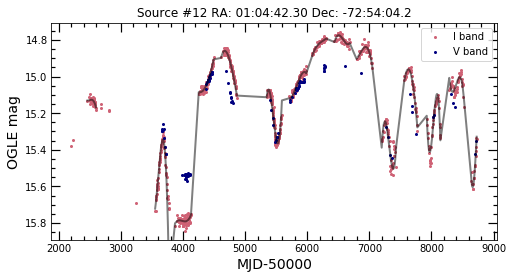

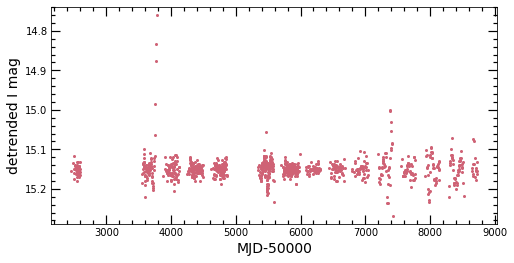

I and V-I correlation: -0.9222358982634402
V and V-I correlation: -0.8022991122992864


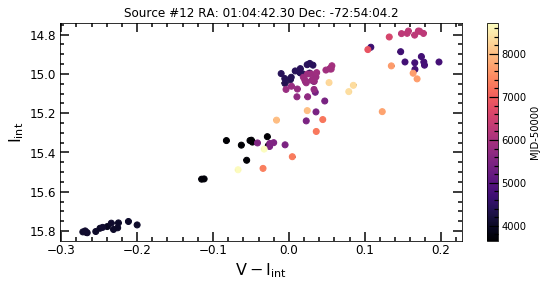

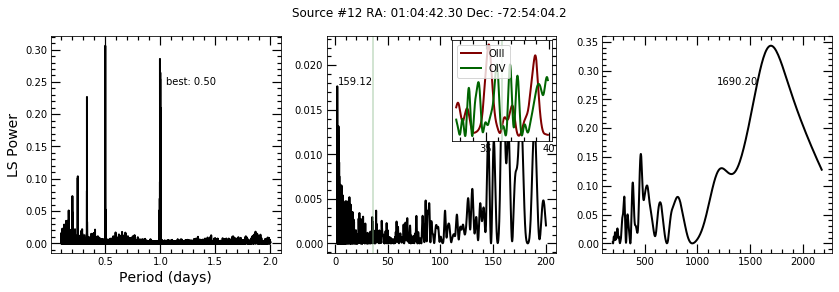

Phase-folding with established orbital period and highest peak within 3.63 days of that value...


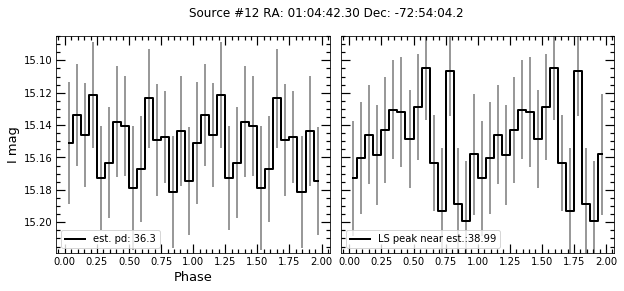

Repeating periodogram and phase-fold after detrending
Window shown in phase-fold: 72


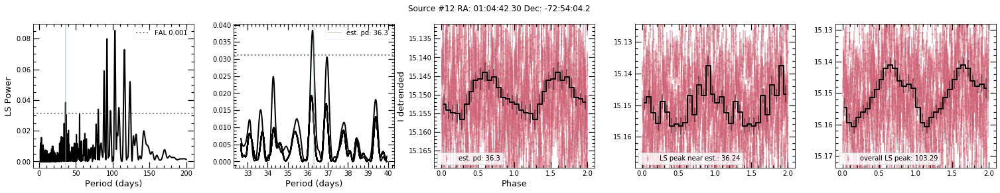

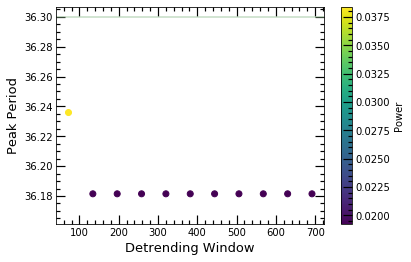

Comparing peaks of 0.1-2 day window function and detrended periodogram...
No peaks found so not searching for beat periods or aliases.


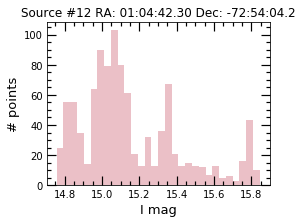



max I band:  15.844
min I band:  14.757
I range:  1.0869999999999997
I stdev:  0.26565631227298286
max V band:  15.569
min V band:  14.939
V range:  0.6300000000000008
V stdev:  0.1934910380070535


In [67]:
basic(10,pbins=16,saveall=save) 

Original source number: 14
Current source number: 13
RA,Dec (deg): 29.316668, -72.97578
Established period: 35.6
NS spin period: 11.58
Separation: nan


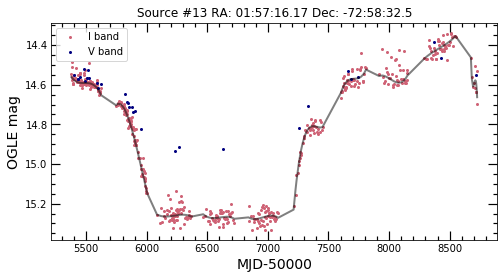

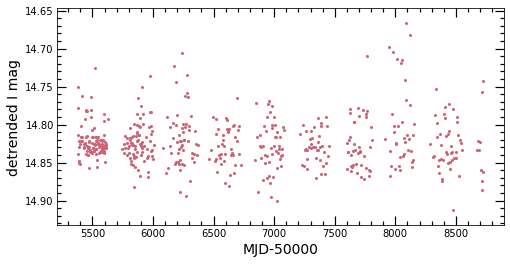

I and V-I correlation: -0.9592415376392872
V and V-I correlation: -0.8788071255321857


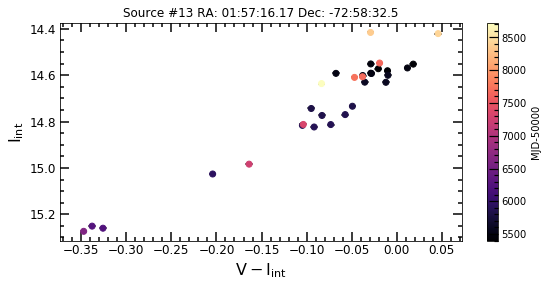

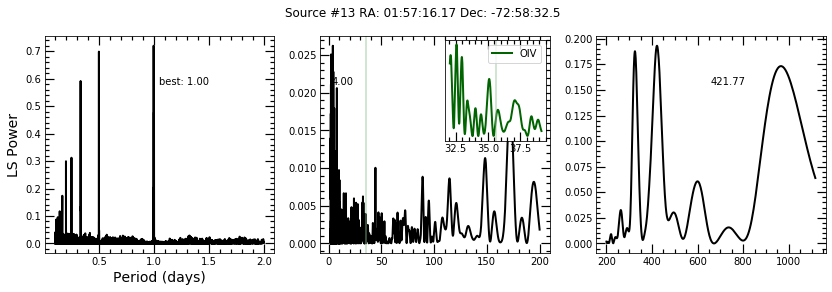

Phase-folding with established orbital period and highest peak within 3.56 days of that value...


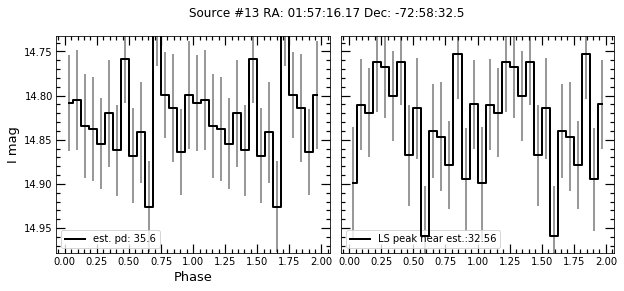

Repeating periodogram and phase-fold after detrending
Window shown in phase-fold: 133


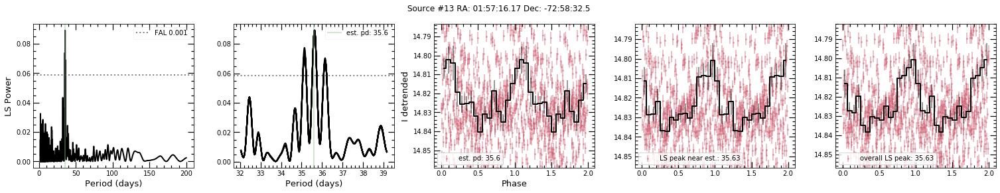

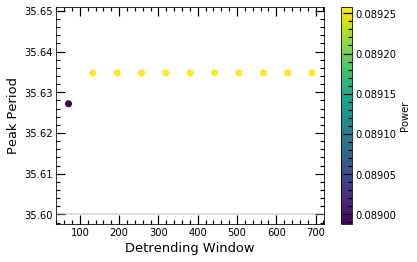

Comparing peaks of 0.1-2 day window function and detrended periodogram...
No peaks found so not searching for beat periods or aliases.


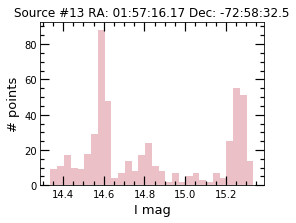



max I band:  15.335
min I band:  14.338
I range:  0.9970000000000017
I stdev:  0.31485138419293546
max V band:  14.934
min V band:  14.387
V range:  0.5469999999999988
V stdev:  0.13211687979648618


In [68]:
basic(11,pbins=16,saveall=save) 

Original source number: 15
Current source number: 14
RA,Dec (deg): 12.058422, -73.367744
Established period: nan
NS spin period: 11.866
Separation: 0.9467066151201687


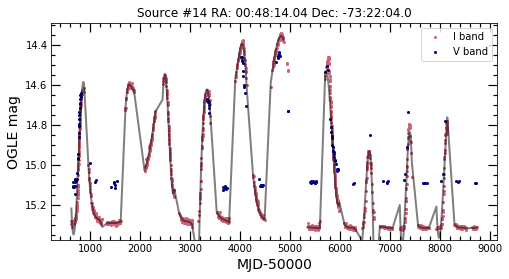

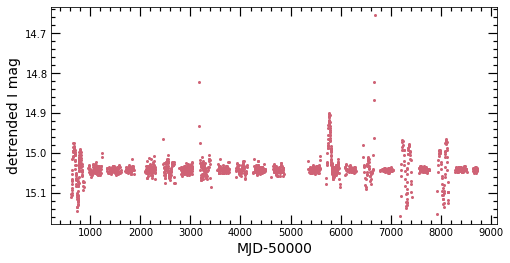

I and V-I correlation: -0.9372414483256165
V and V-I correlation: -0.8515095648198383


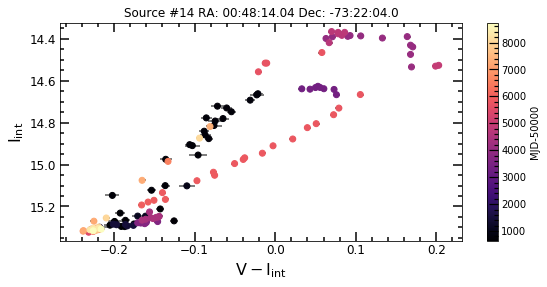

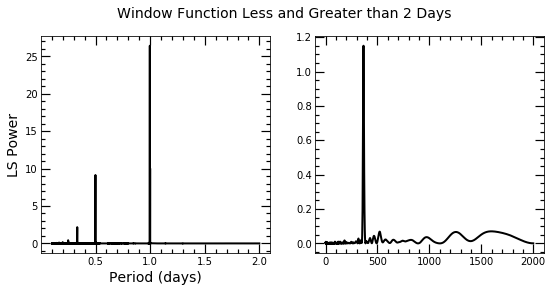

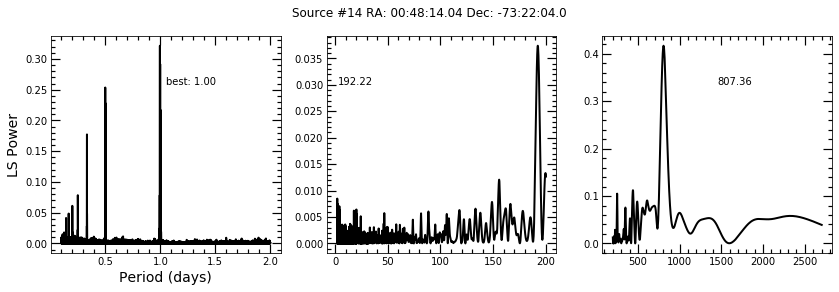

using best period from middle periodogram to phase-fold data, after detrending with 701
running periodogram on detrended data


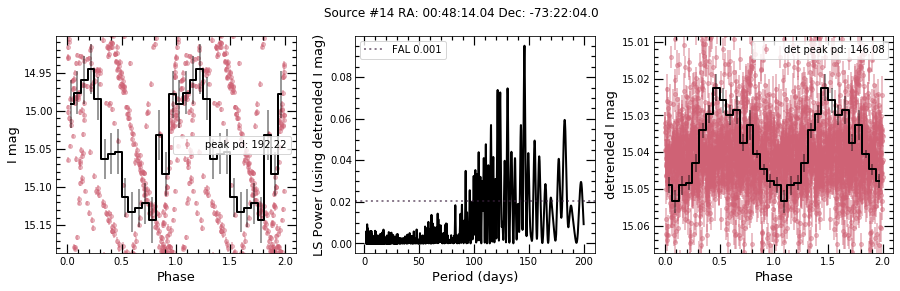

Comparing peaks of 0.1-2 day window function and detrended periodogram...
Beat period of highest peaks is 146.1056157173772.
There is at least one alias of the 0.1-2 day detrended search within a day of 146.08008119301743 days (the detrended peak).
There is at least one alias of the 0.1-2 day window function within a day of 146.08008119301743 days (the detrended peak).


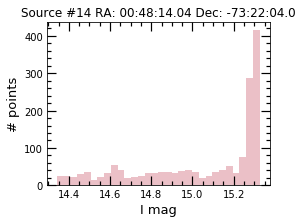



max I band:  15.326
min I band:  14.341
I range:  0.9850000000000012
I stdev:  0.3014267833367876
max V band:  15.143
min V band:  14.436
V range:  0.7070000000000007
V stdev:  0.21919824034747304


In [69]:
basic(12,pbins=16,saveall=save) 

Original source number: 16
Current source number: 15
RA,Dec (deg): 13.058333, -73.32166
Established period: 74.51
NS spin period: 15.3
Separation: 0.3576915031662127


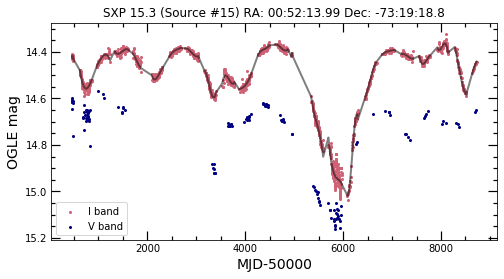

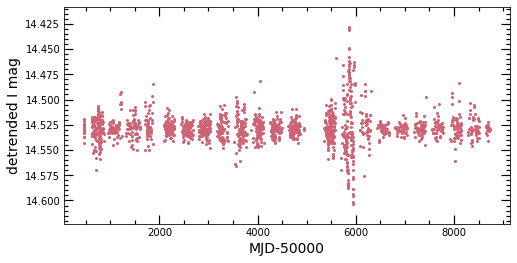

I and V-I correlation: -0.28392614544546685
V and V-I correlation: 0.1227097449647219


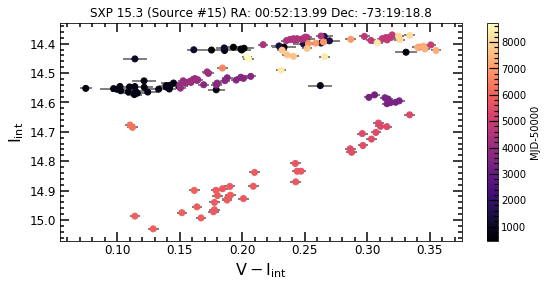

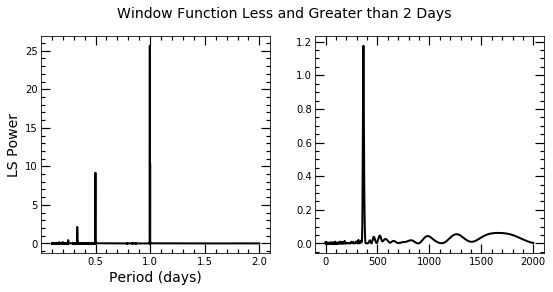

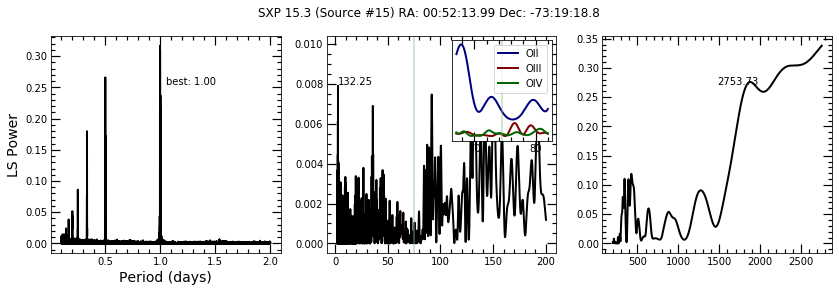

Phase-folding with established orbital period and highest peak within 7.45 days of that value...


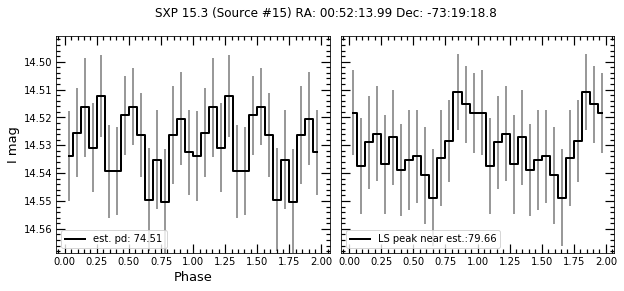

Repeating periodogram and phase-fold after detrending
Window shown in phase-fold: 149


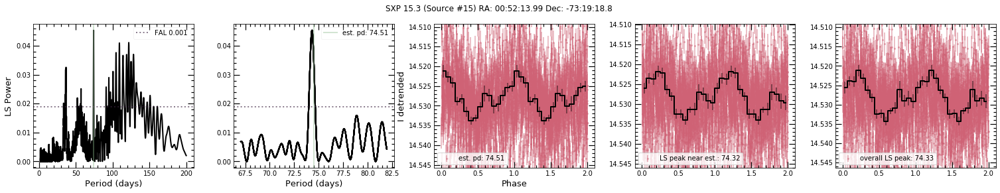

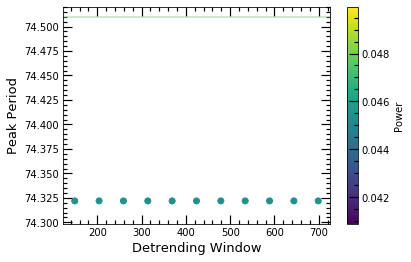

Comparing peaks of 0.1-2 day window function and detrended periodogram...
There is at least one alias of the 0.1-2 day detrended search within a day of the established period.
There is at least one alias of the 0.1-2 day window function within a day of the established period.


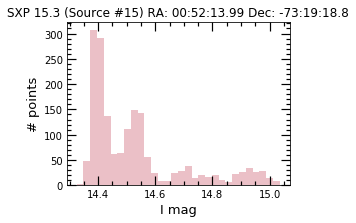



max I band:  15.035
min I band:  14.325
I range:  0.7100000000000009
I stdev:  0.17032282634135576
max V band:  15.16
min V band:  14.566
V range:  0.5939999999999994
V stdev:  0.17329854894564659


In [70]:
basic(13,pbins=16,saveall=save) 

Original source number: 17
Current source number: 16
RA,Dec (deg): 12.23147, -73.82957
Established period: 36.43182
NS spin period: 15.64
Separation: 1.5997877936106613


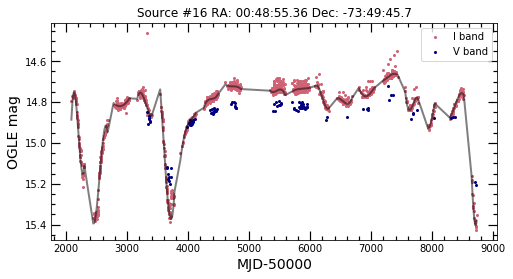

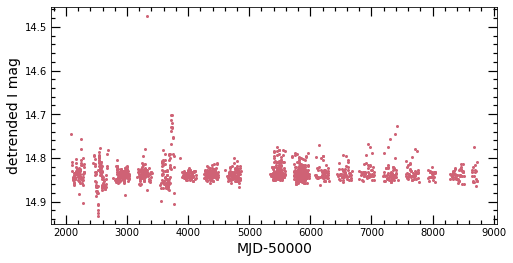

I and V-I correlation: -0.9743333607524376
V and V-I correlation: -0.9241167283255649


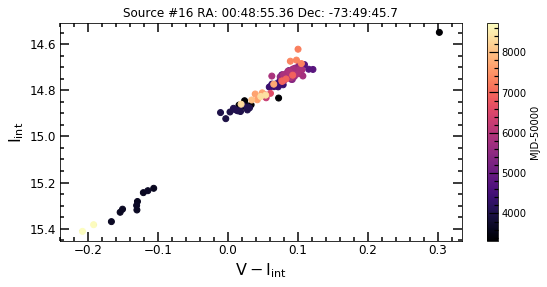

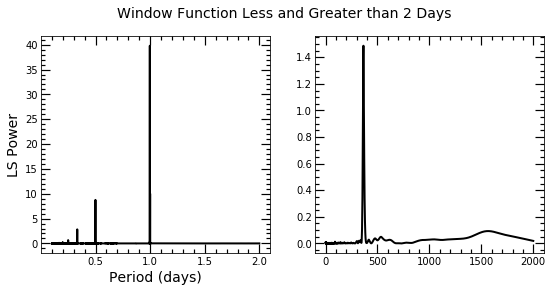

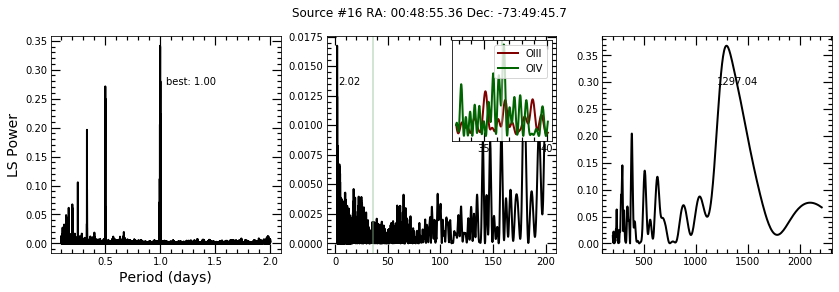

Phase-folding with established orbital period and highest peak within 3.64 days of that value...


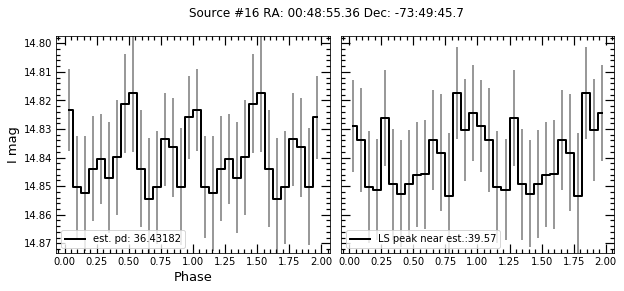

Repeating periodogram and phase-fold after detrending
Window shown in phase-fold: 72


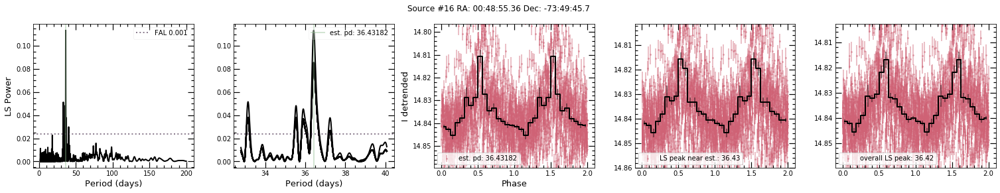

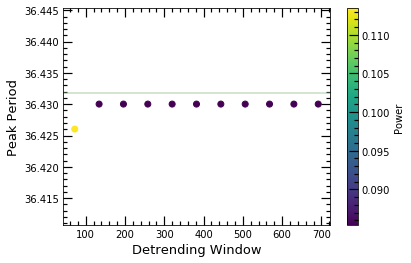

Comparing peaks of 0.1-2 day window function and detrended periodogram...
Beat period of highest peaks is 36.43606441347549.
There is at least one alias of the 0.1-2 day detrended search within a day of the established period.
There is at least one alias of the 0.1-2 day window function within a day of the established period.


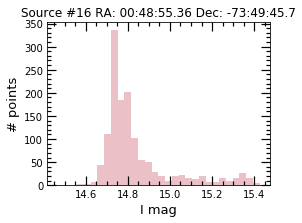



max I band:  15.427
min I band:  14.462
I range:  0.9649999999999999
I stdev:  0.1689797049980143
max V band:  15.204
min V band:  14.722
V range:  0.4820000000000011
V stdev:  0.10559068452767831


In [71]:
basic(14,pbins=16,saveall=save) 

Original source number: 20
Current source number: 18
RA,Dec (deg): 19.41848, -73.51407
Established period: 75.97
NS spin period: 22.07
Separation: 1.3035255870924656


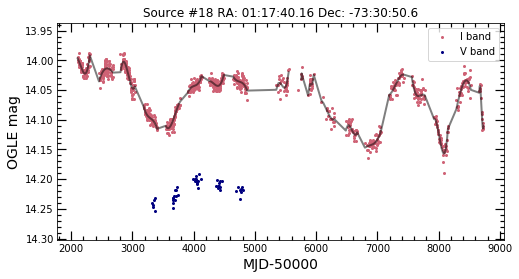

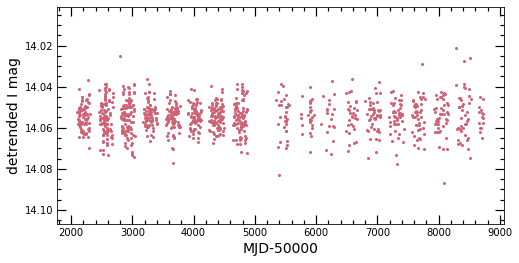

I and V-I correlation: -0.8705120488367663
V and V-I correlation: -0.42919278651818193


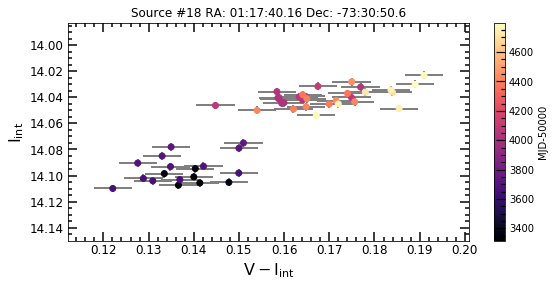

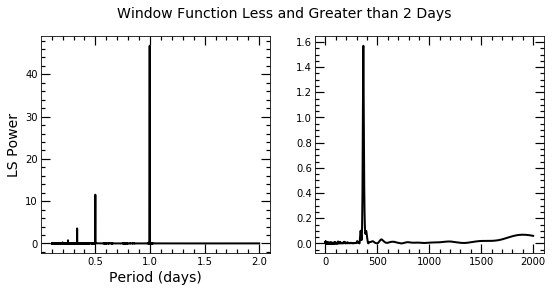

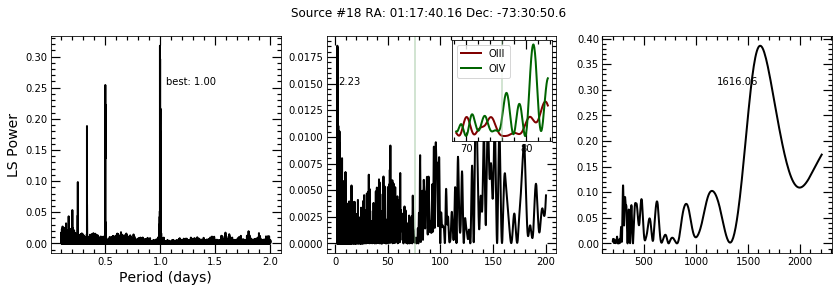

Phase-folding with established orbital period and highest peak within 7.60 days of that value...


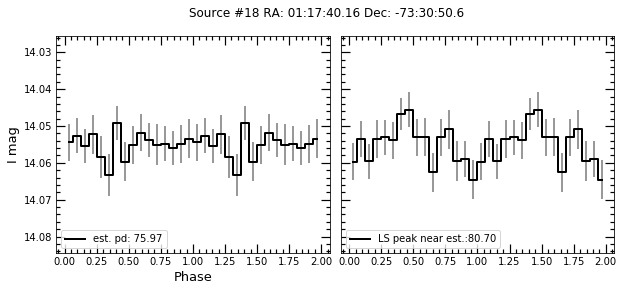

Repeating periodogram and phase-fold after detrending
Window shown in phase-fold: 151


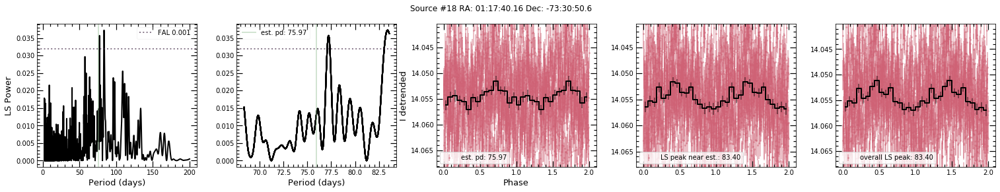

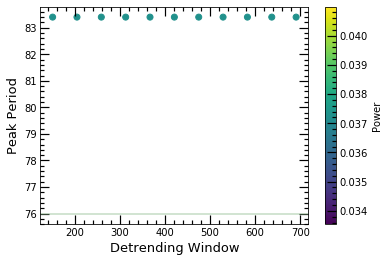

Comparing peaks of 0.1-2 day window function and detrended periodogram...
Beat period of highest peaks is 83.61752650176817.
There is at least one alias of the 0.1-2 day detrended search within a day of the established period.
There is at least one alias of the 0.1-2 day window function within a day of the established period.


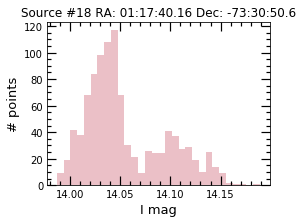



max I band:  14.189
min I band:  13.987
I range:  0.20199999999999996
I stdev:  0.040006482402392504
max V band:  14.253
min V band:  14.191
V range:  0.06199999999999939
V stdev:  0.015276815480066213


In [72]:
basic(15,pbins=16,saveall=save) 

Original source number: 21
Current source number: 19
RA,Dec (deg): 12.0591135, -73.16776
Established period: 22.5
NS spin period: 25.55
Separation: 0.3827734346044463


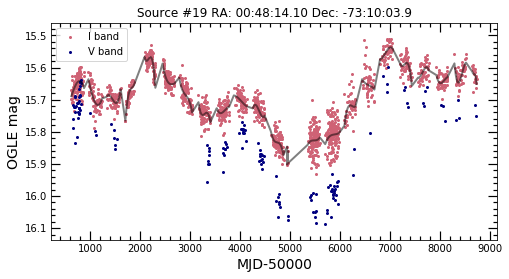

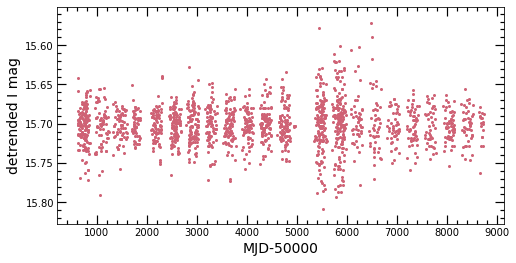

I and V-I correlation: 0.6742002022243393
V and V-I correlation: 0.8736934128945111


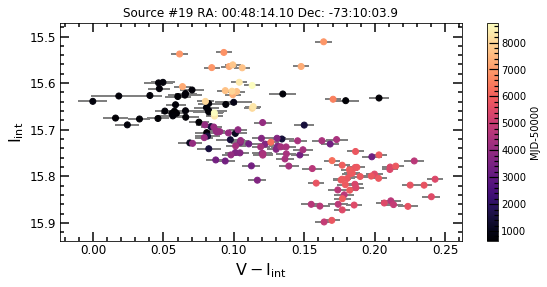

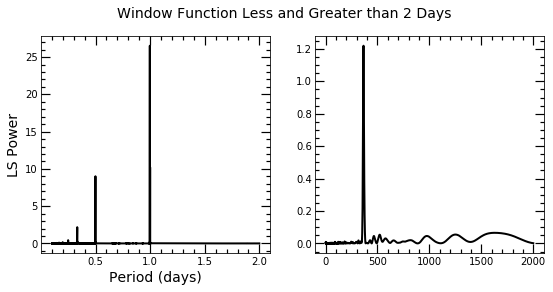

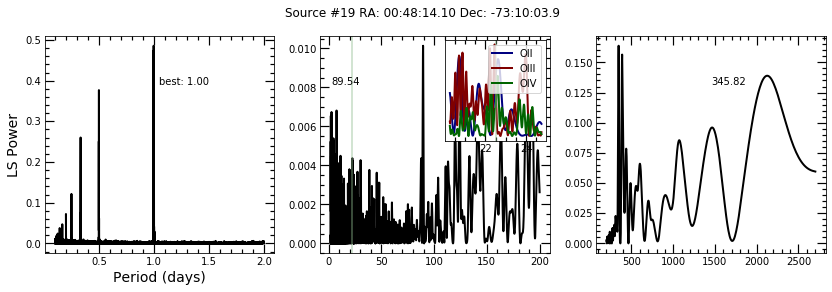

Phase-folding with established orbital period and highest peak within 2.25 days of that value...


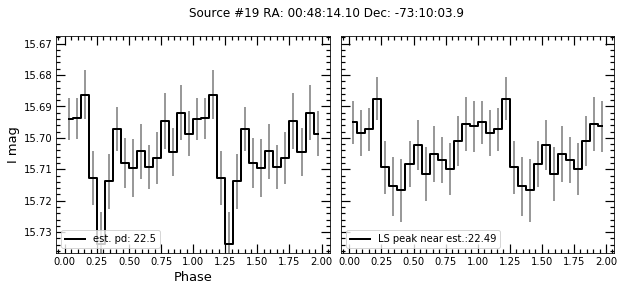

Repeating periodogram and phase-fold after detrending
Window shown in phase-fold: 45


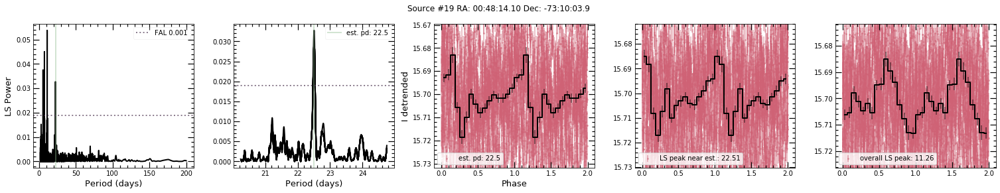

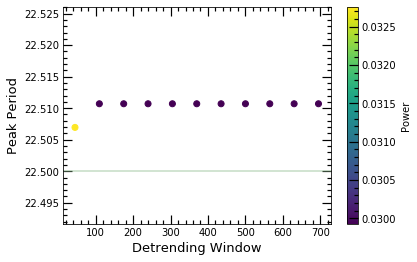

Comparing peaks of 0.1-2 day window function and detrended periodogram...
There is at least one alias of the 0.1-2 day detrended search within a day of the established period.
There is at least one alias of the 0.1-2 day window function within a day of the established period.


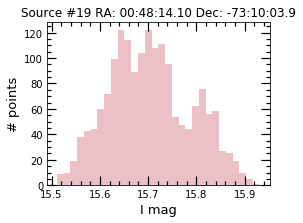



max I band:  15.931
min I band:  15.511
I range:  0.41999999999999993
I stdev:  0.08437130342459512
max V band:  16.088
min V band:  15.599
V range:  0.48900000000000077
V stdev:  0.12681425717253644


In [73]:
basic(16,pbins=16,saveall=save) 

Original source number: 23
Current source number: 21
RA,Dec (deg): 13.480083, -72.44603
Established period: 137.36
NS spin period: 46.63
Separation: 0.6475291035939916


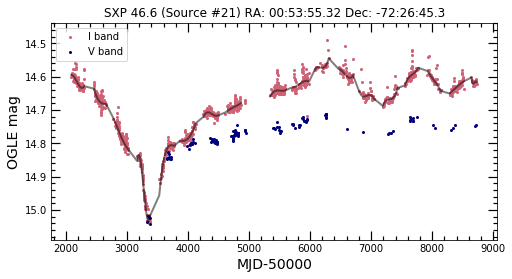

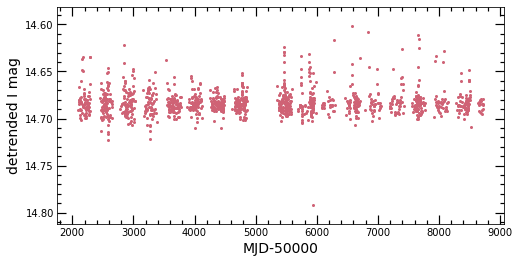

I and V-I correlation: -0.9273513917435414
V and V-I correlation: -0.8016300560930327


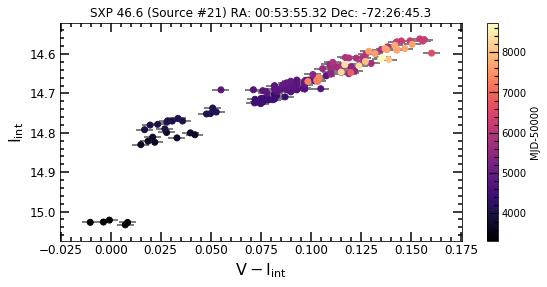

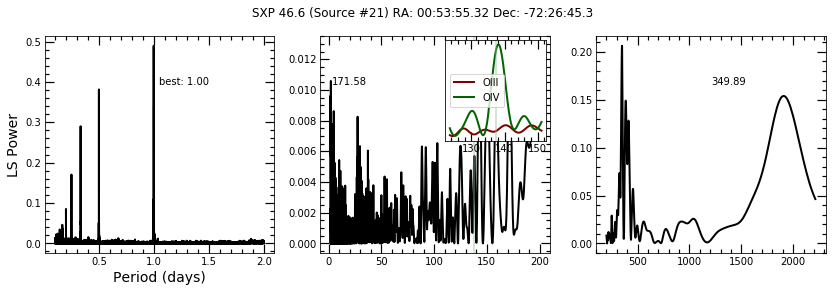

Phase-folding with established orbital period and highest peak within 13.74 days of that value...


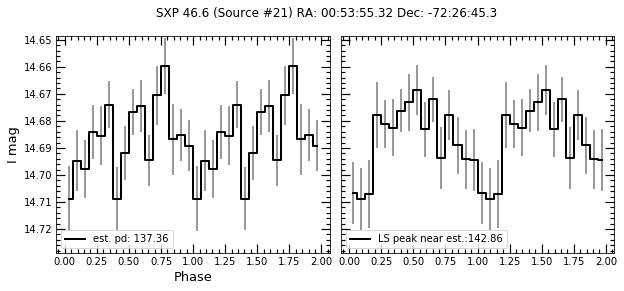

Repeating periodogram and phase-fold after detrending
Window shown in phase-fold: 274


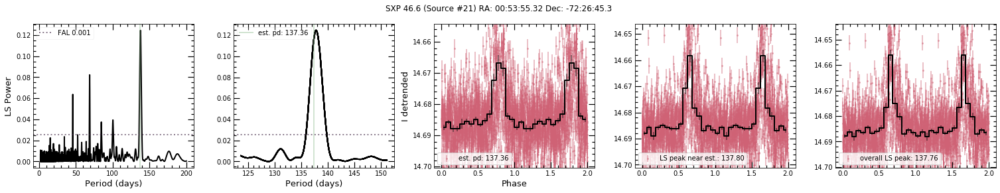

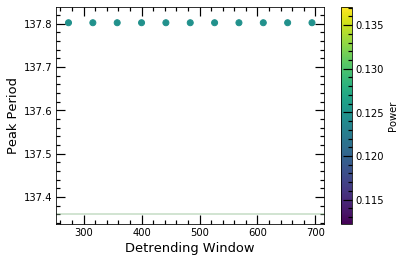

Comparing peaks of 0.1-2 day window function and detrended periodogram...
No peaks found so not searching for beat periods or aliases.


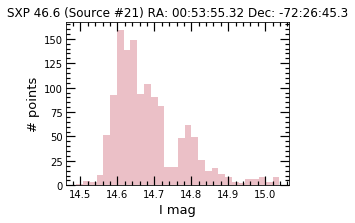



max I band:  15.038
min I band:  14.489
I range:  0.5489999999999995
I stdev:  0.09382432234945837
max V band:  15.041
min V band:  14.712
V range:  0.3290000000000006
V stdev:  0.05706732455276843


In [74]:
#did 17 in examples
basic(18,pbins=16,saveall=save) 

Original source number: 24
Current source number: 22
RA,Dec (deg): 13.734498, -72.44646
Established period: 62.1
NS spin period: 59.07
Separation: 1.0903290717742153


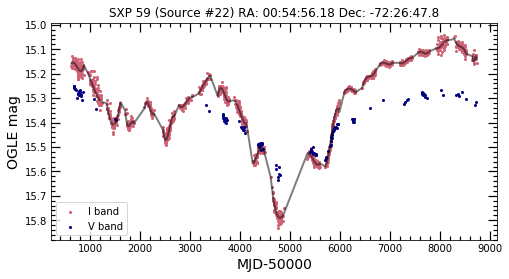

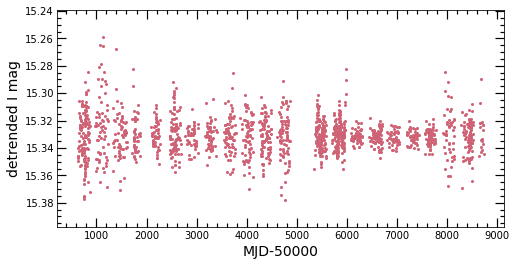

I and V-I correlation: -0.9664953395224388
V and V-I correlation: -0.8812431463201372


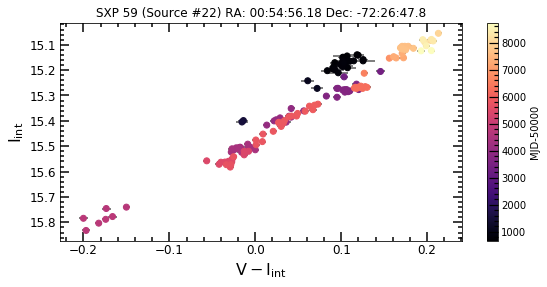

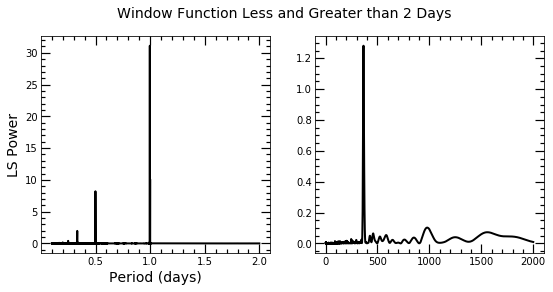

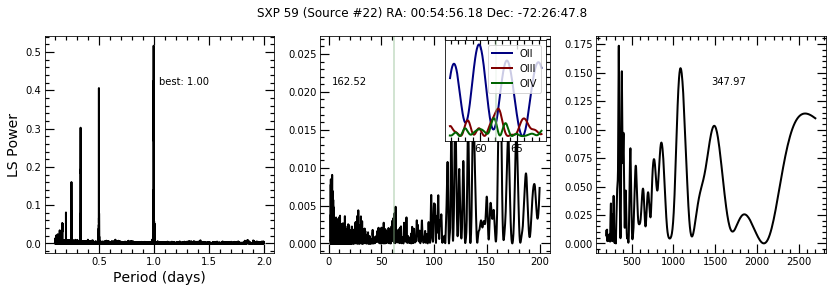

Phase-folding with established orbital period and highest peak within 6.21 days of that value...


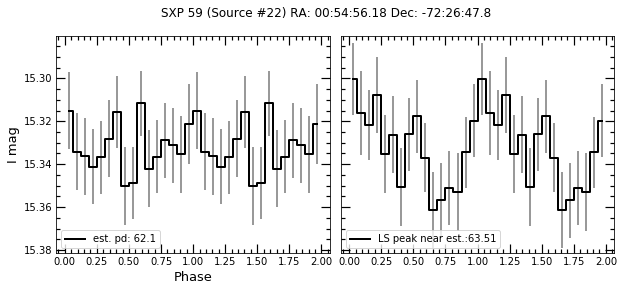

Repeating periodogram and phase-fold after detrending
Window shown in phase-fold: 124


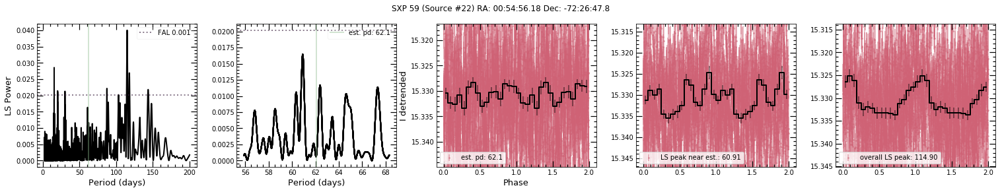

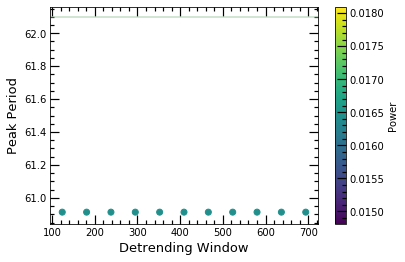

Comparing peaks of 0.1-2 day window function and detrended periodogram...


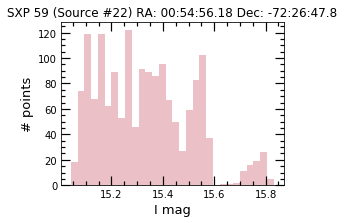



max I band:  15.832
min I band:  15.042
I range:  0.7900000000000009
I stdev:  0.1773279291038697
max V band:  15.635
min V band:  15.251
V range:  0.38400000000000034
V stdev:  0.09836510688014943


In [75]:
basic(19,pbins=16,saveall=save) 

Original source number: 25
Current source number: 23
RA,Dec (deg): 16.802626, -72.59272
Established period: 110.6
NS spin period: 65.78
Separation: 0.2959192778047304
empty file for OIII I


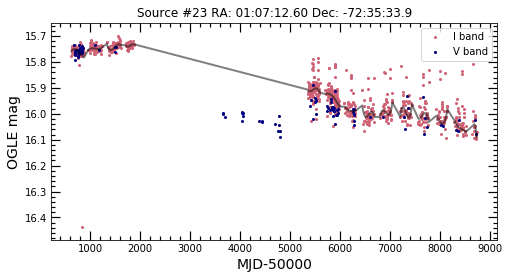

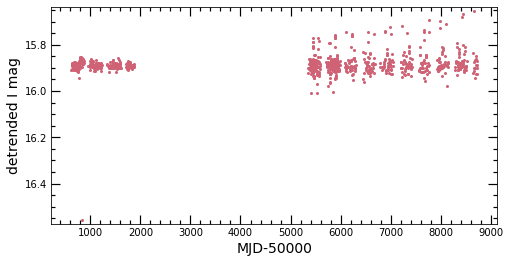

I and V-I correlation: 0.09169053904024185
V and V-I correlation: 0.5637549161121175


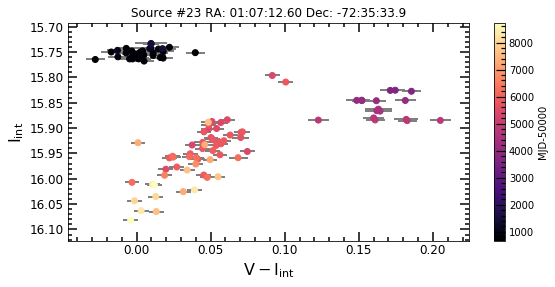

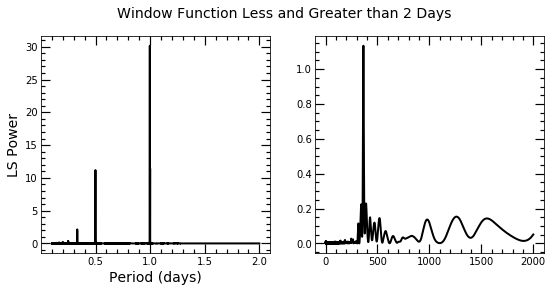

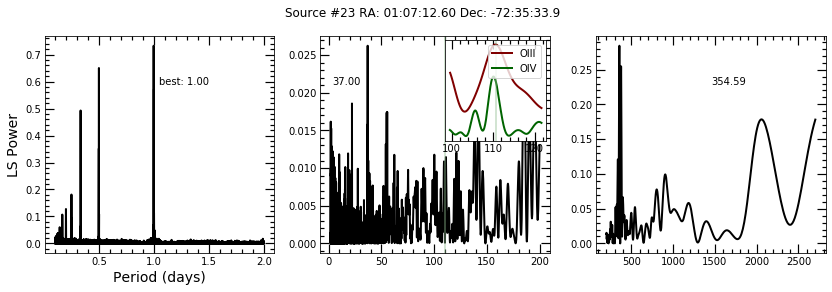

Phase-folding with established orbital period and highest peak within 11.06 days of that value...


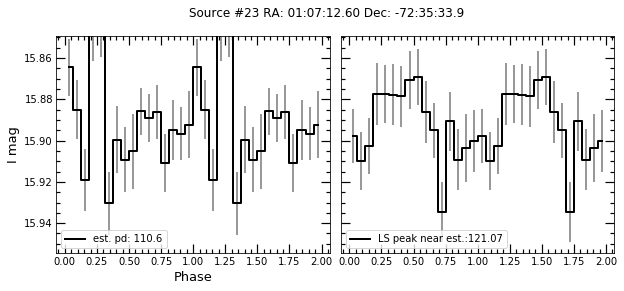

Repeating periodogram and phase-fold after detrending
Window shown in phase-fold: 221


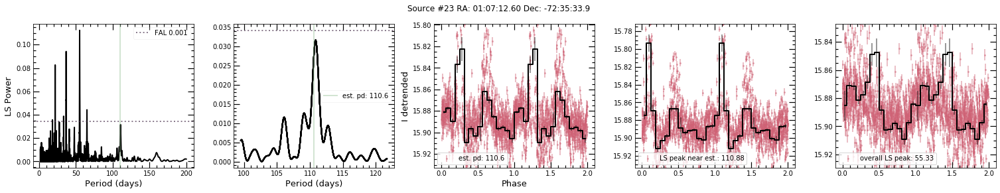

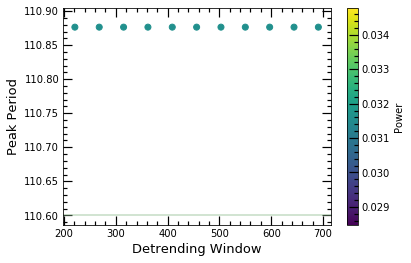

Comparing peaks of 0.1-2 day window function and detrended periodogram...
There is at least one alias of the 0.1-2 day detrended search within a day of the established period.
There is at least one alias of the 0.1-2 day window function within a day of the established period.


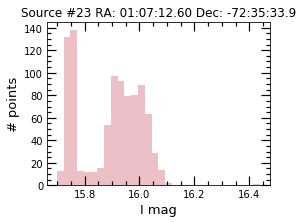



max I band:  16.438
min I band:  15.699
I range:  0.738999999999999
I stdev:  0.11126326387333538
max V band:  16.09
min V band:  15.733
V range:  0.3569999999999993
V stdev:  0.1174724680603568


In [76]:
basic(20,pbins=16,saveall=save) #fix limits; in indiv analysis, try lower periods

Original source number: 26
Current source number: 24
RA,Dec (deg): 12.263891, -72.847824
Established period: 33.38
NS spin period: 74.67
Separation: 0.1813335761297484


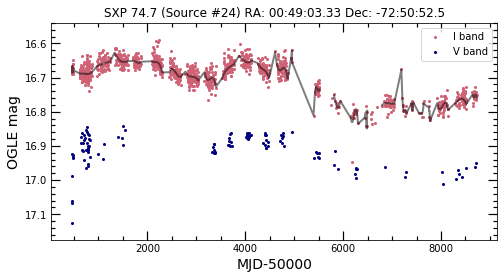

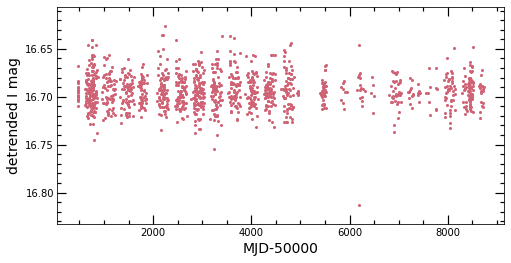

I and V-I correlation: -0.3892159716416162
V and V-I correlation: 0.482141243063691


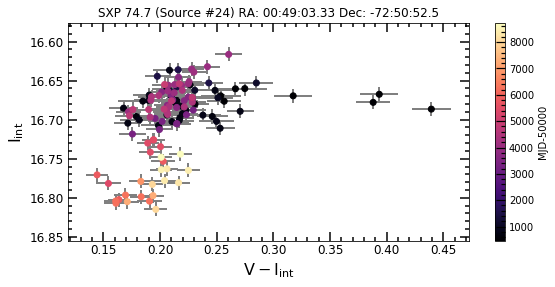

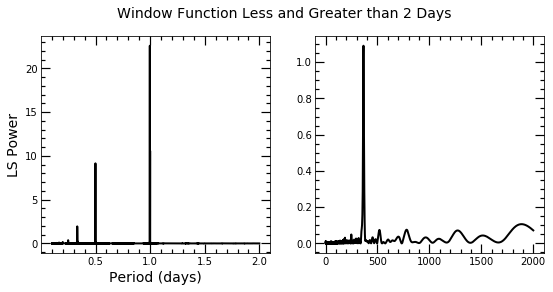

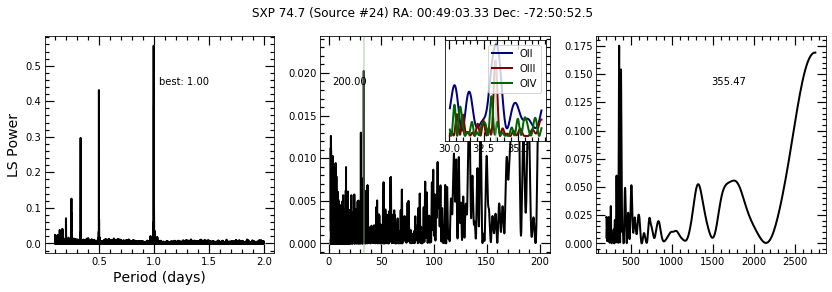

Phase-folding with established orbital period and highest peak within 3.34 days of that value...


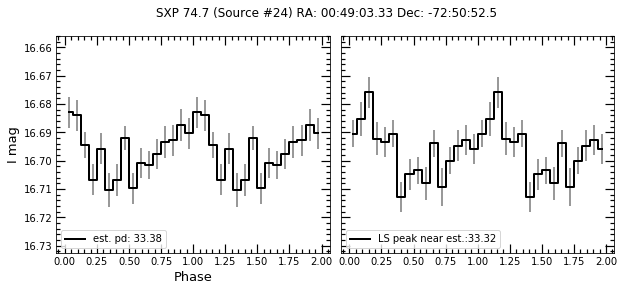

Repeating periodogram and phase-fold after detrending
Window shown in phase-fold: 66


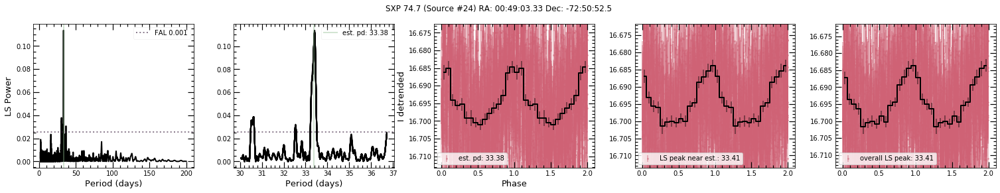

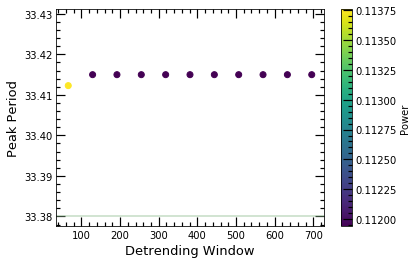

Comparing peaks of 0.1-2 day window function and detrended periodogram...
Beat period of highest peaks is 33.40556243429043.
There is at least one alias of the 0.1-2 day detrended search within a day of the established period.
There is at least one alias of the 0.1-2 day window function within a day of the established period.


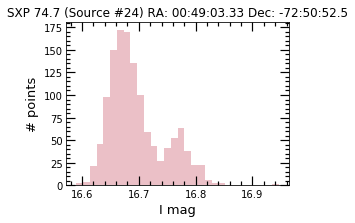



max I band:  16.947
min I band:  16.59
I range:  0.3569999999999993
I stdev:  0.04874549714866689
max V band:  17.126
min V band:  16.842
V range:  0.2840000000000025
V stdev:  0.04826511097870676


In [77]:
basic(21,pbins=16,saveall=save) 

Original source number: 27
Current source number: 25
RA,Dec (deg): 13.037084, -72.63416
Established period: 362.3
NS spin period: 82.4
Separation: 0.3330362838593329


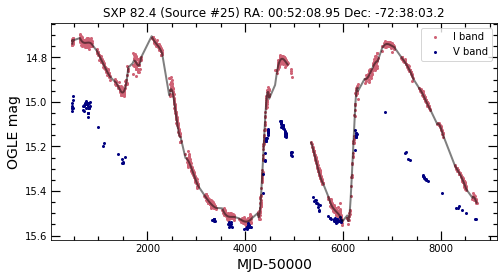

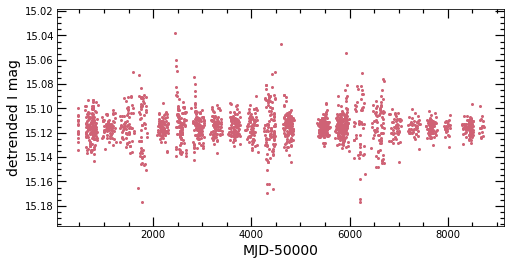

I and V-I correlation: -0.9086555042418574
V and V-I correlation: -0.7772043187778405


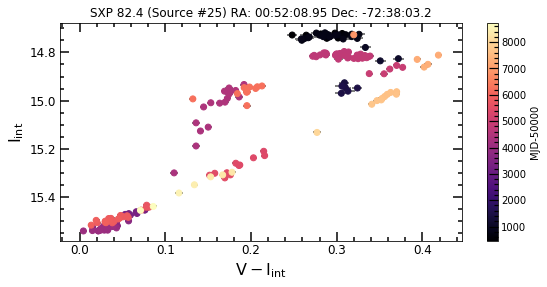

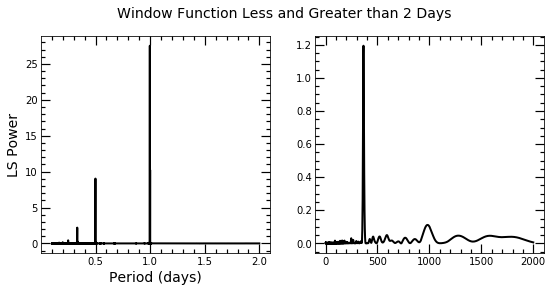

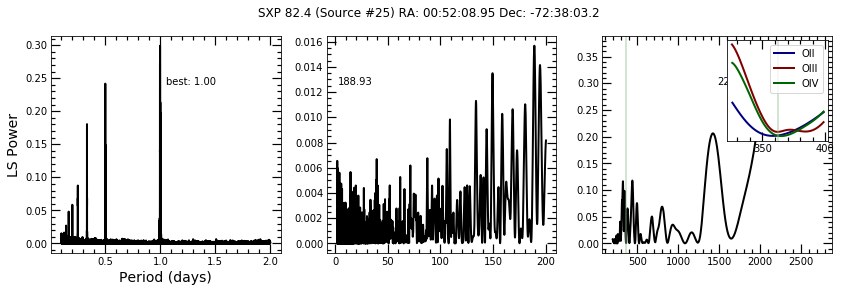

Phase-folding with established orbital period and highest peak within 36.23 days of that value...


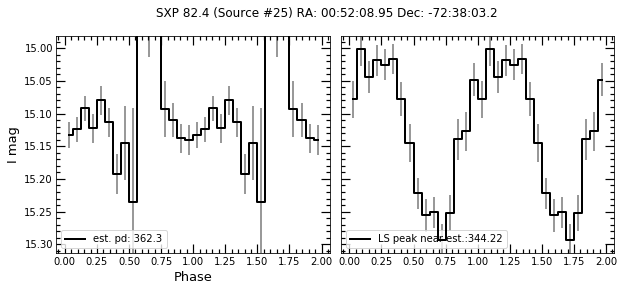

Repeating periodogram and phase-fold after detrending
Window shown in phase-fold: 724


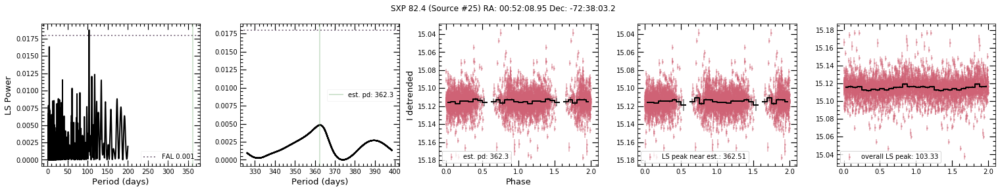

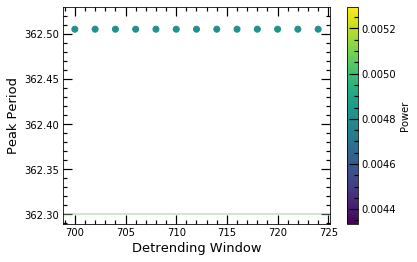

Comparing peaks of 0.1-2 day window function and detrended periodogram...


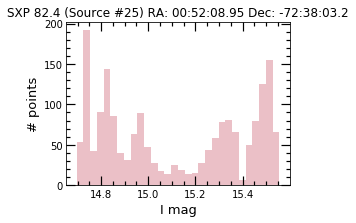



max I band:  15.556
min I band:  14.696
I range:  0.8599999999999994
I stdev:  0.29289769154267836
max V band:  15.571
min V band:  14.976
V range:  0.5949999999999989
V stdev:  0.20093992192941484


In [80]:
basic(22,pbins=16,saveall=save,medlim=False) #est. period likely just from sampling

Original source number: 28
Current source number: 26
RA,Dec (deg): 12.737854, -72.22597
Established period: 88.3
NS spin period: 91.12
Separation: 0.9175874109513925


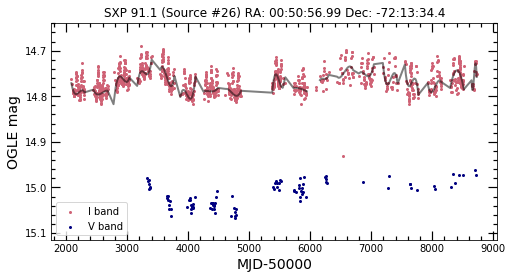

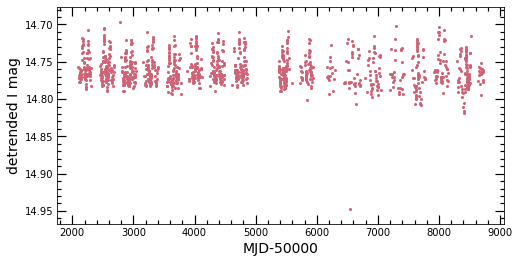

I and V-I correlation: -0.19384500140770167
V and V-I correlation: 0.5100391042312166


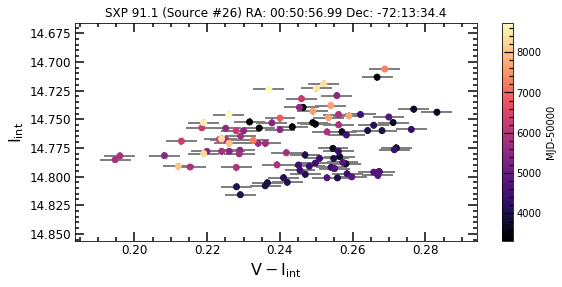

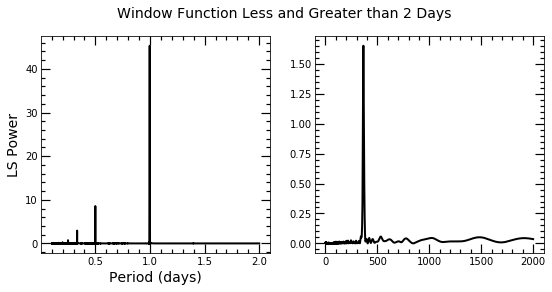

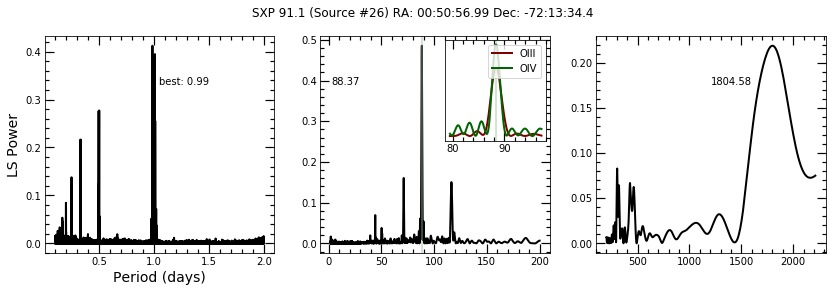

Phase-folding with established orbital period and highest peak within 8.83 days of that value...


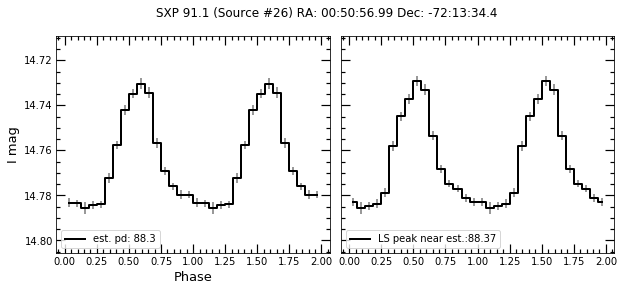

Repeating periodogram and phase-fold after detrending
Window shown in phase-fold: 176


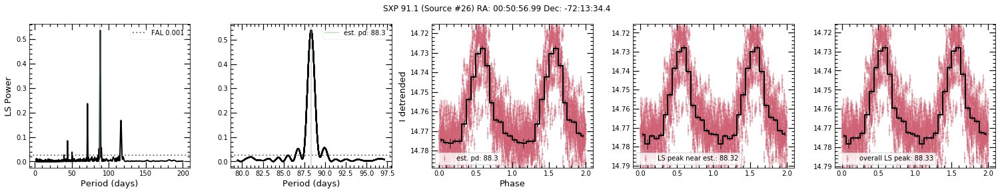

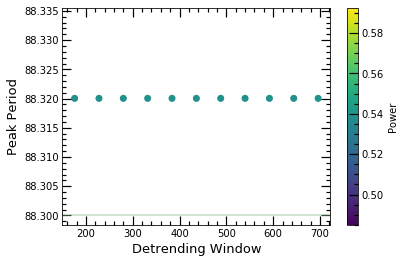

Comparing peaks of 0.1-2 day window function and detrended periodogram...
Beat period of highest peaks is 88.30902765957526.
There is at least one alias of the 0.1-2 day detrended search within a day of the established period.
There is at least one alias of the 0.1-2 day window function within a day of the established period.


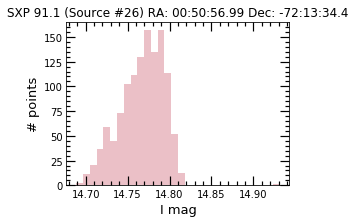



max I band:  14.931
min I band:  14.689
I range:  0.2419999999999991
I stdev:  0.0255988259460188
max V band:  15.066
min V band:  14.961
V range:  0.10500000000000043
V stdev:  0.026840700011052876


In [81]:
basic(23,pbins=16,saveall=save) 

Original source number: 30
Current source number: 27
RA,Dec (deg): 14.362833, -73.42208
Established period: 21.95
NS spin period: 101.16
Separation: 0.09157770298445858


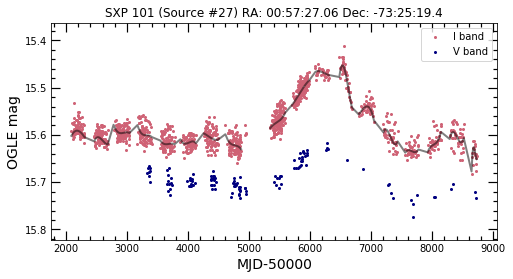

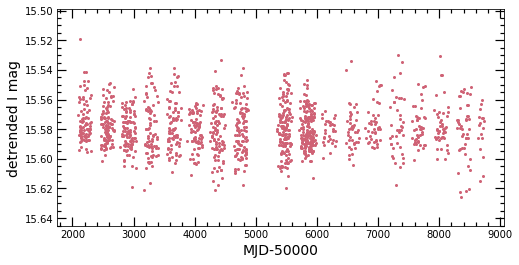

I and V-I correlation: -0.8565184040914818
V and V-I correlation: -0.4252439926010499


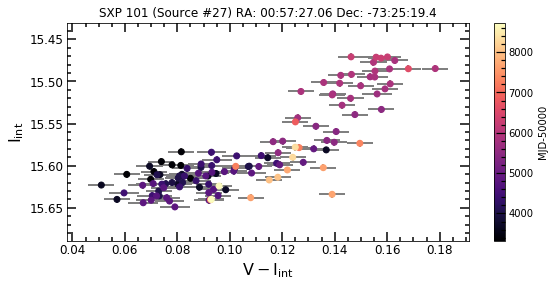

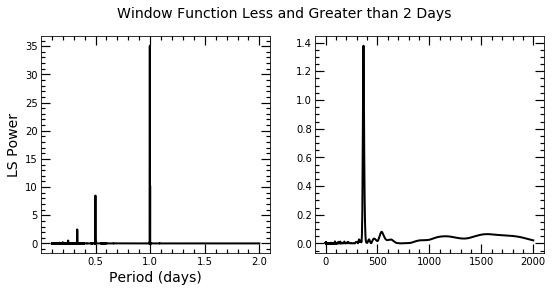

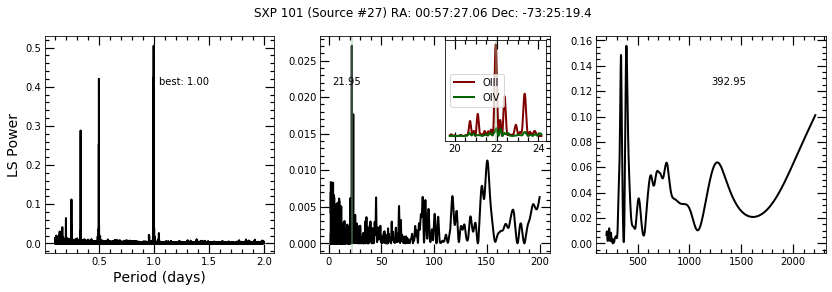

Phase-folding with established orbital period and highest peak within 2.19 days of that value...


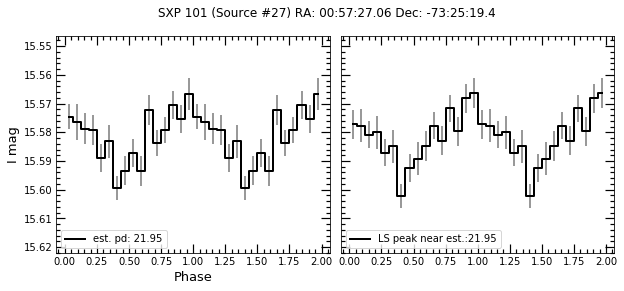

Repeating periodogram and phase-fold after detrending
Window shown in phase-fold: 108


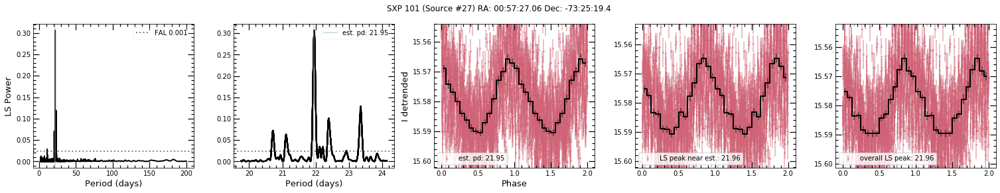

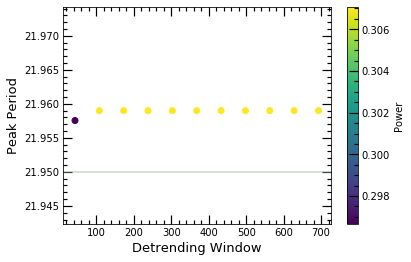

Comparing peaks of 0.1-2 day window function and detrended periodogram...
Beat period of highest peaks is 21.958958269955613.
There is at least one alias of the 0.1-2 day detrended search within a day of the established period.
There is at least one alias of the 0.1-2 day window function within a day of the established period.


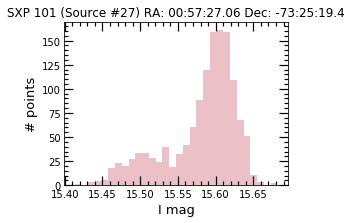



max I band:  15.682
min I band:  15.413
I range:  0.26900000000000013
I stdev:  0.04720481374155966
max V band:  15.773
min V band:  15.617
V range:  0.1559999999999988
V stdev:  0.02898682544622942


In [82]:
basic(24,pbins=16,saveall=save) 

Original source number: 32
Current source number: 29
RA,Dec (deg): 14.023825, -72.3665
Established period: 197.0
NS spin period: 140.1
Separation: nan


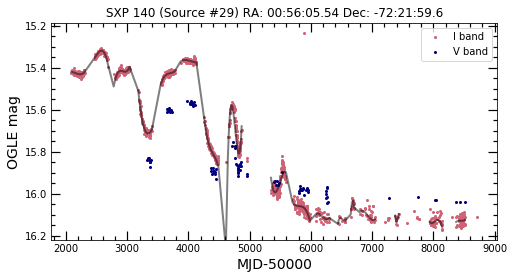

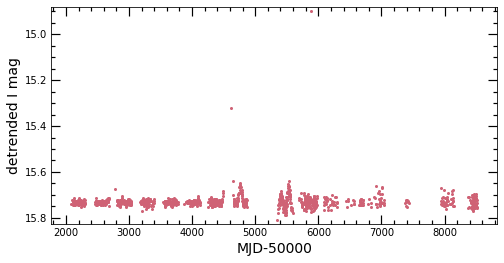

I and V-I correlation: -0.9535305675696865
V and V-I correlation: -0.8651057918416414


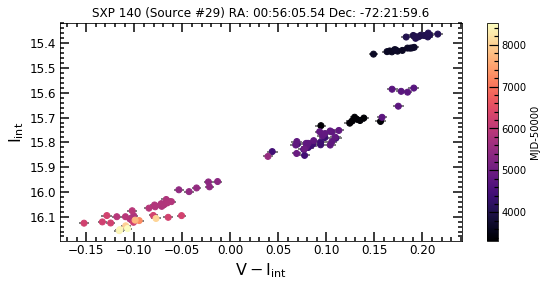

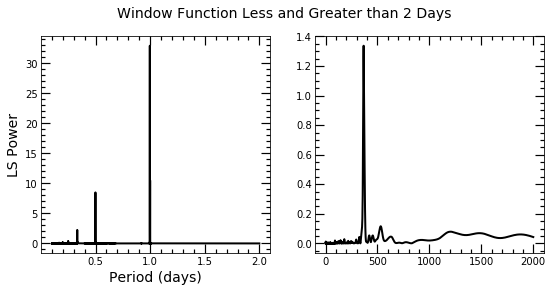

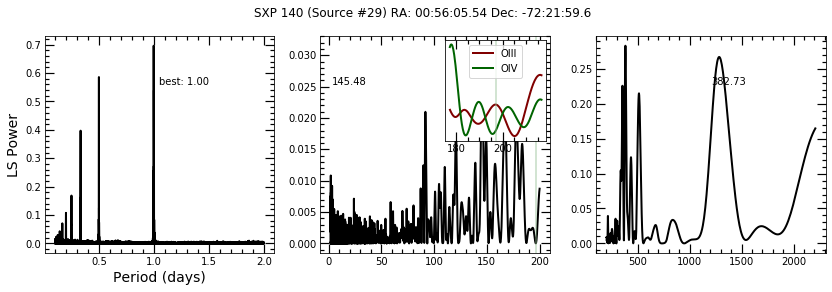

Phase-folding with established orbital period and highest peak within 19.70 days of that value...


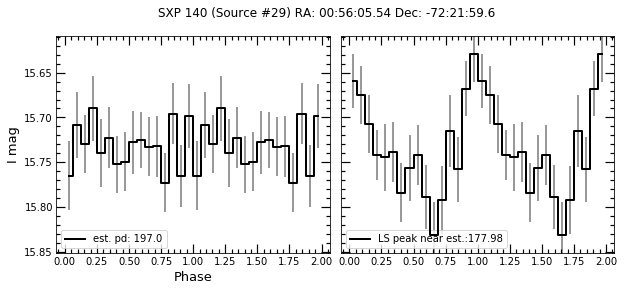

Repeating periodogram and phase-fold after detrending
Window shown in phase-fold: 394


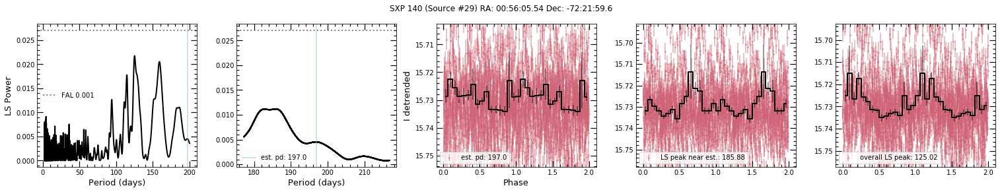

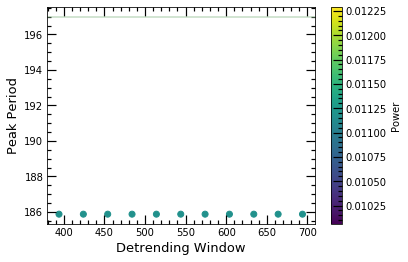

Comparing peaks of 0.1-2 day window function and detrended periodogram...


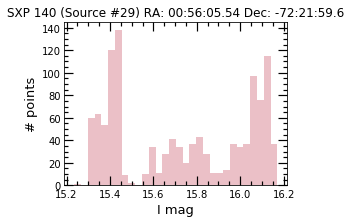



max I band:  16.171
min I band:  15.236
I range:  0.9349999999999987
I stdev:  0.29953886813843494
max V band:  16.045
min V band:  15.558
V range:  0.4870000000000019
V stdev:  0.15741729167667975


In [83]:
basic(26,pbins=16,saveall=save) #weird outlier will change range significantly; don't trust best period 

Original source number: 34
Current source number: 30
RA,Dec (deg): 14.45975, -72.13239
Established period: nan
NS spin period: 152.34
Separation: 0.690086673577844


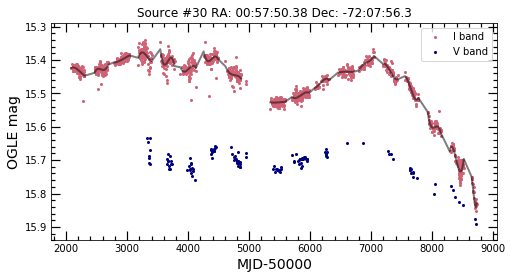

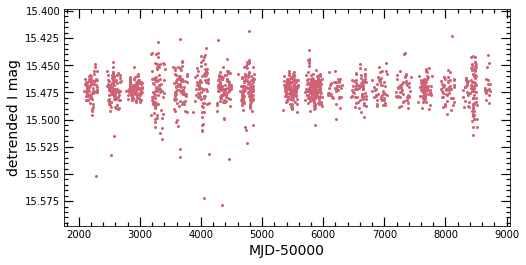

I and V-I correlation: -0.8996473434922264
V and V-I correlation: -0.4705792987062251


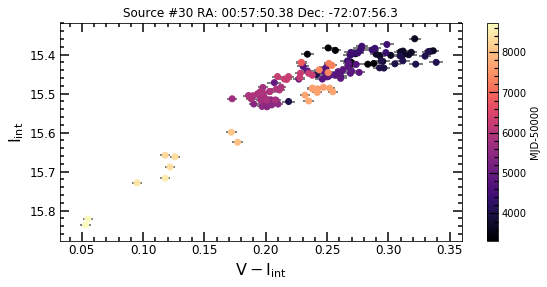

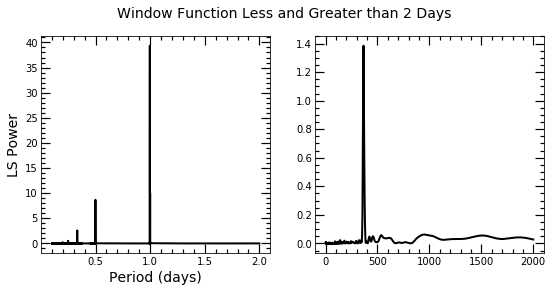

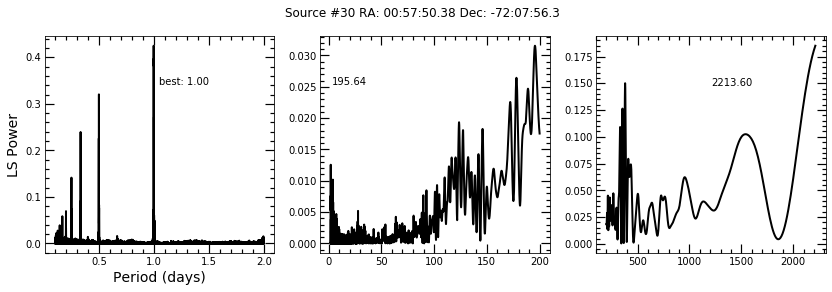

using best period from middle periodogram to phase-fold data, after detrending with 701
running periodogram on detrended data


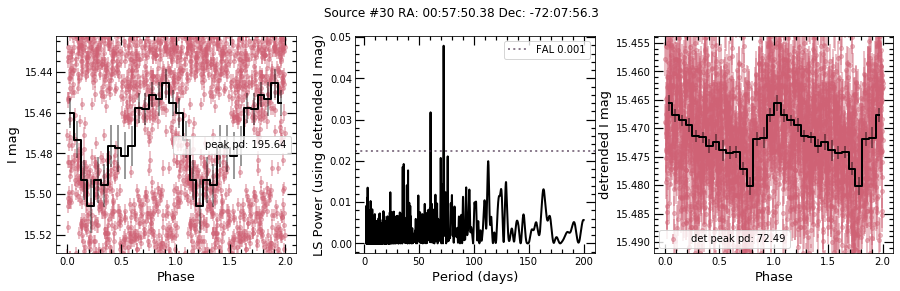

Comparing peaks of 0.1-2 day window function and detrended periodogram...
There is at least one alias of the 0.1-2 day detrended search within a day of 72.49469243737643 days (the detrended peak).
There is at least one alias of the 0.1-2 day window function within a day of 72.49469243737643 days (the detrended peak).


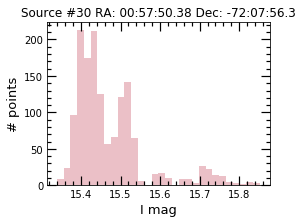



max I band:  15.852
min I band:  15.339
I range:  0.5129999999999999
I stdev:  0.0915189838984039
max V band:  15.89
min V band:  15.633
V range:  0.25700000000000145
V stdev:  0.039630464164122074


In [84]:
basic(27,pbins=16,saveall=save) 

Original source number: 35
Current source number: 31
RA,Dec (deg): 16.930262, -71.99825
Established period: nan
NS spin period: 153.99
Separation: nan


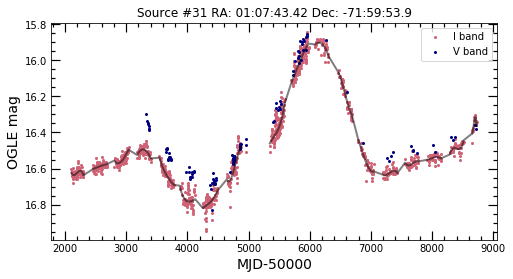

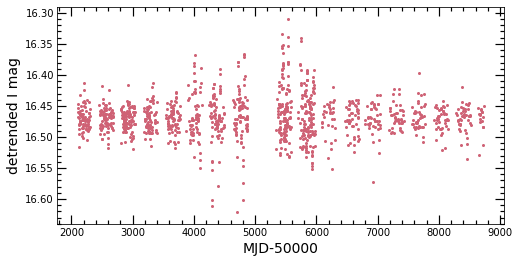

I and V-I correlation: -0.44719767996792303
V and V-I correlation: -0.2921974309963761


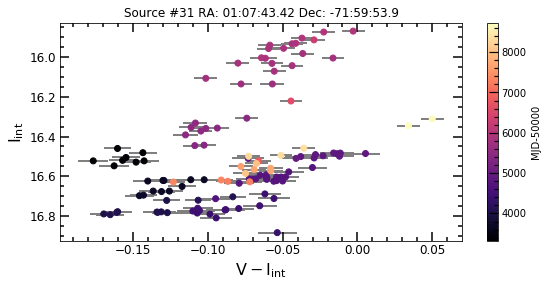

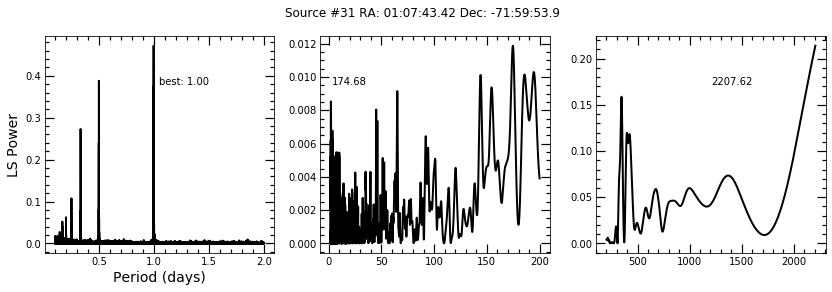

using best period from middle periodogram to phase-fold data, after detrending with 701
running periodogram on detrended data


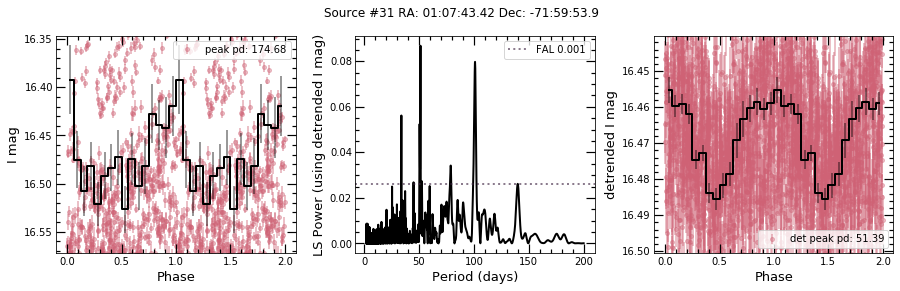

Comparing peaks of 0.1-2 day window function and detrended periodogram...
No peaks found so not searching for beat periods or aliases.


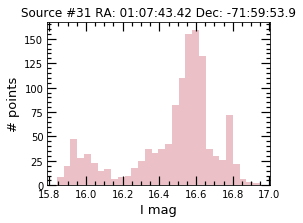



max I band:  16.948
min I band:  15.842
I range:  1.1059999999999999
I stdev:  0.24444782050103298
max V band:  16.83
min V band:  15.852
V range:  0.977999999999998
V stdev:  0.2426598591429968


In [85]:
basic(28,pbins=16,saveall=save) 

Original source number: 36
Current source number: 32
RA,Dec (deg): 13.229781, -71.96826
Established period: 68.54
NS spin period: 169.3
Separation: nan


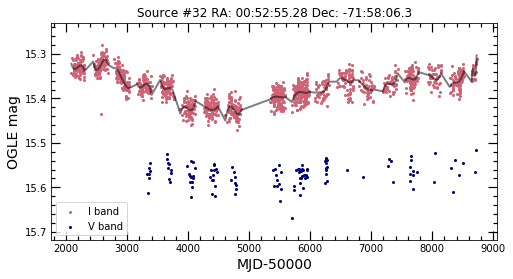

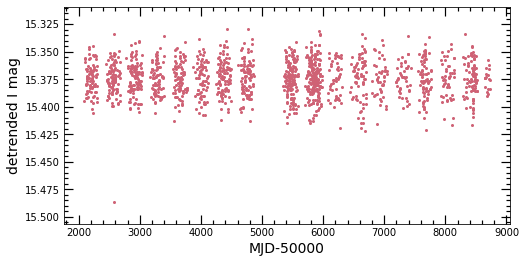

I and V-I correlation: -0.5628075429487736
V and V-I correlation: 0.42389085197099036


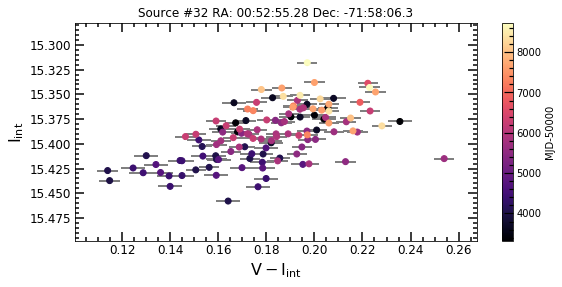

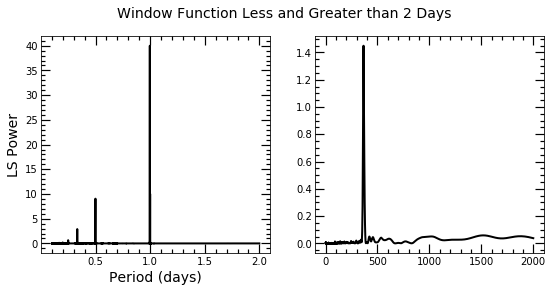

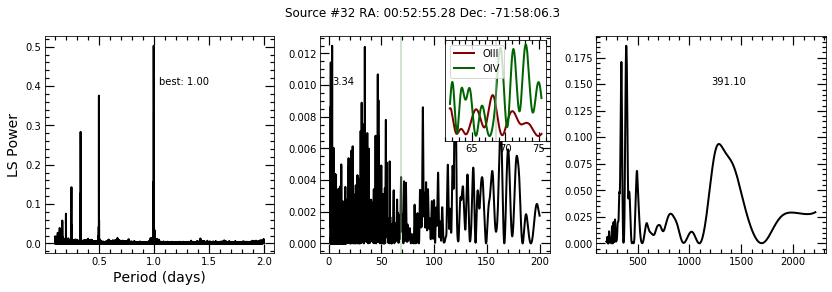

Phase-folding with established orbital period and highest peak within 6.85 days of that value...


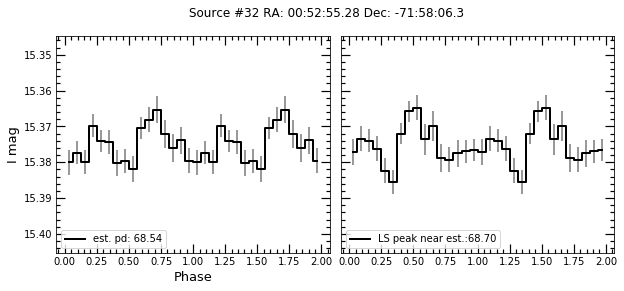

Repeating periodogram and phase-fold after detrending
Window shown in phase-fold: 137


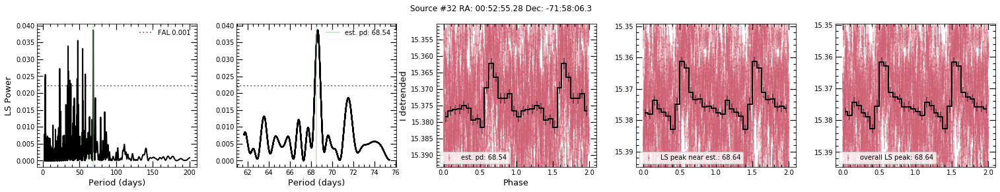

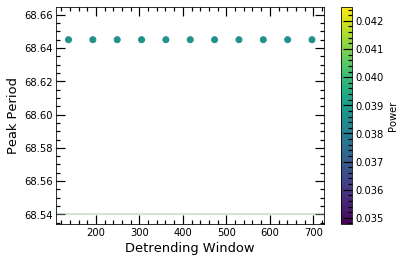

Comparing peaks of 0.1-2 day window function and detrended periodogram...
There is at least one alias of the 0.1-2 day detrended search within a day of the established period.
There is at least one alias of the 0.1-2 day window function within a day of the established period.


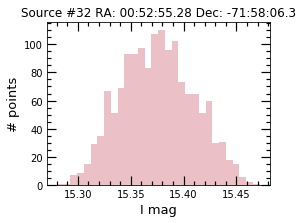



max I band:  15.472
min I band:  15.28
I range:  0.19200000000000017
I stdev:  0.034089280710712454
max V band:  15.669
min V band:  15.515
V range:  0.15399999999999991
V stdev:  0.024681088570835993


In [86]:
basic(29,pbins=16,saveall=save) 

Original source number: 37
Current source number: 33
RA,Dec (deg): 12.96625, -73.175835
Established period: 67.88
NS spin period: 172.0
Separation: 0.9273925558014638


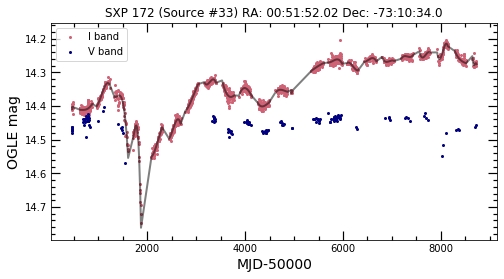

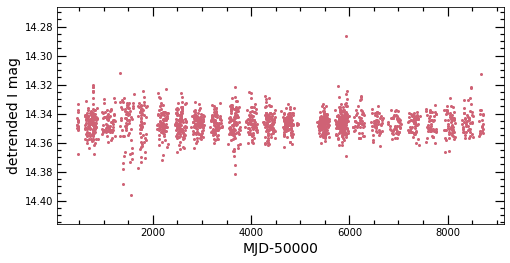

I and V-I correlation: -0.9336360429069598
V and V-I correlation: 0.047453376633395085


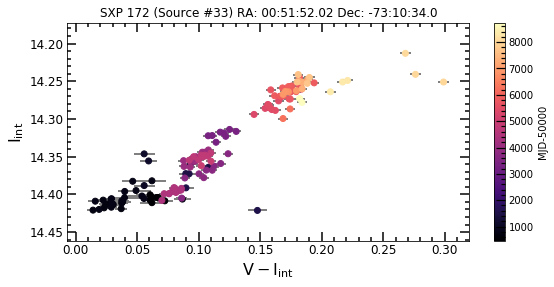

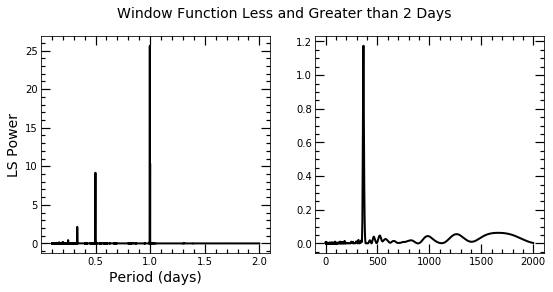

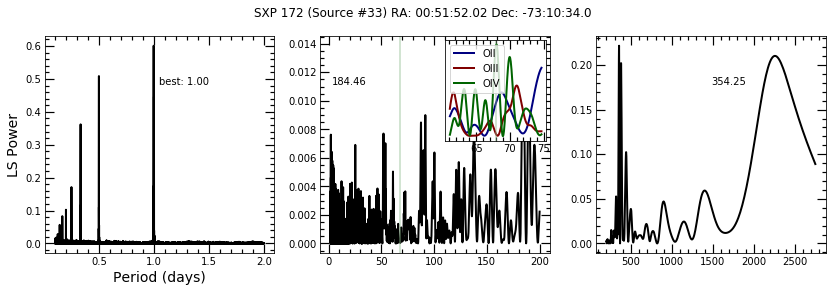

Phase-folding with established orbital period and highest peak within 6.79 days of that value...


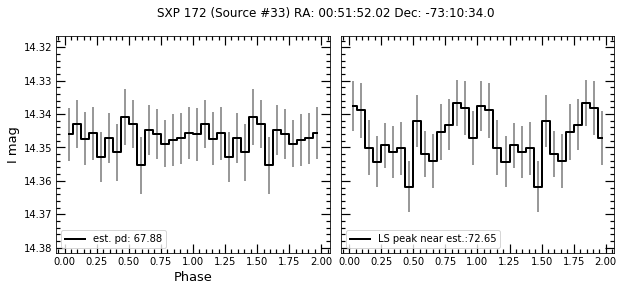

Repeating periodogram and phase-fold after detrending
Window shown in phase-fold: 135


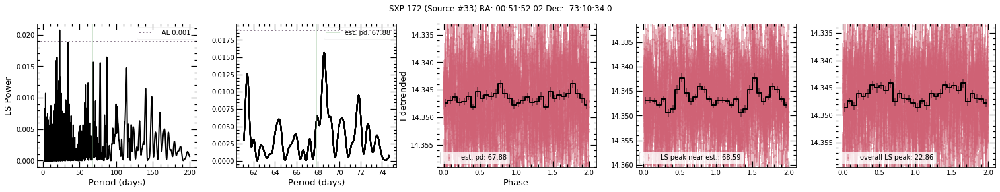

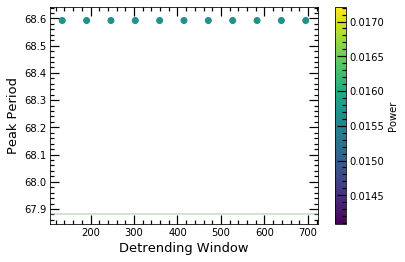

Comparing peaks of 0.1-2 day window function and detrended periodogram...
Beat period of highest peaks is 68.60306576980607.
There is at least one alias of the 0.1-2 day detrended search within a day of the established period.
There is at least one alias of the 0.1-2 day window function within a day of the established period.


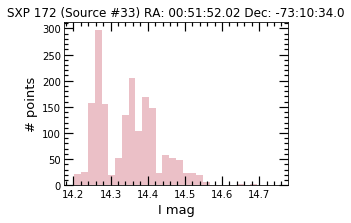



max I band:  14.749
min I band:  14.203
I range:  0.5460000000000012
I stdev:  0.08095801394877851
max V band:  14.569
min V band:  14.402
V range:  0.1670000000000016
V stdev:  0.021807134183604783


In [87]:
basic(30,pbins=16,saveall=save) 

Original source number: 38
Current source number: 34
RA,Dec (deg): 15.467725, -72.39261
Established period: nan
NS spin period: 175.4
Separation: 0.7364043183292862


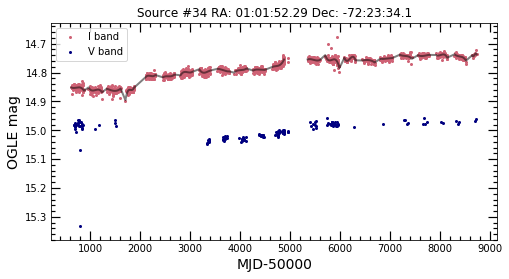

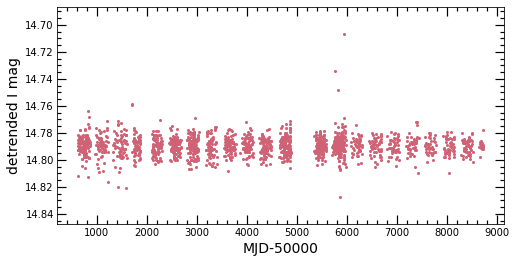

I and V-I correlation: -0.6957365004457309
V and V-I correlation: 0.6189396891999773


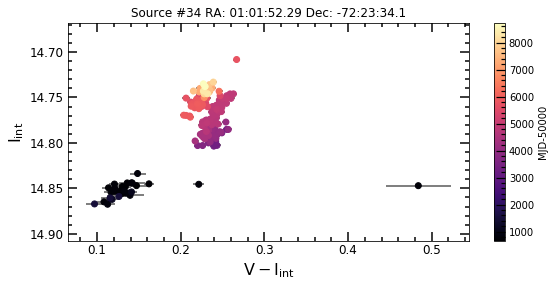

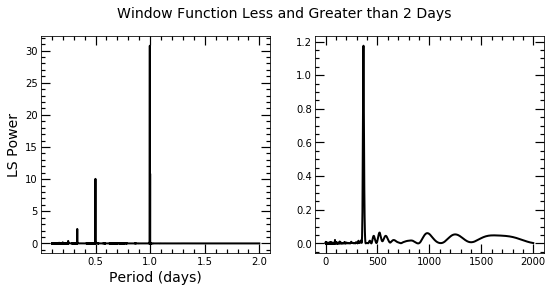

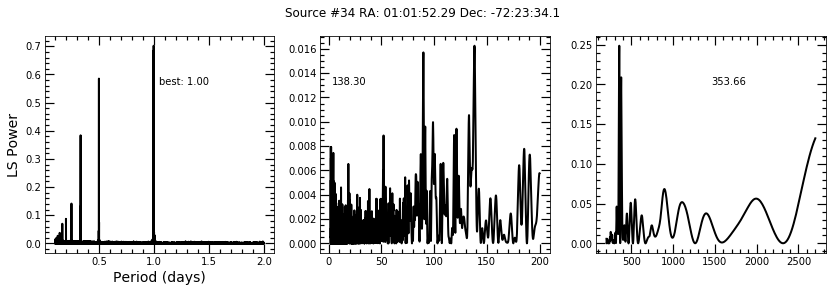

using best period from middle periodogram to phase-fold data, after detrending with 701
running periodogram on detrended data


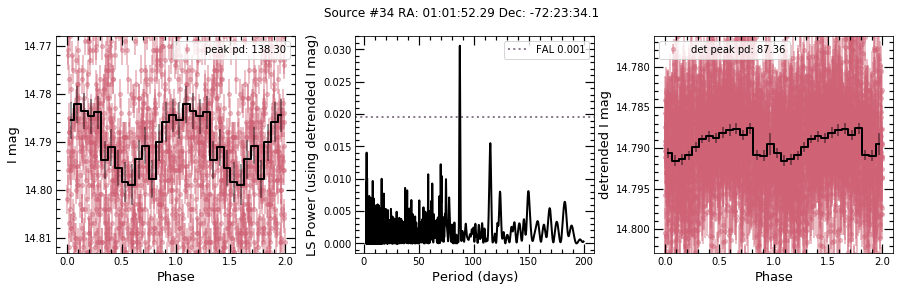

Comparing peaks of 0.1-2 day window function and detrended periodogram...
Beat period of highest peaks is 87.44216202804708.
There is at least one alias of the 0.1-2 day detrended search within a day of 87.35787430712443 days (the detrended peak).
There is at least one alias of the 0.1-2 day window function within a day of 87.35787430712443 days (the detrended peak).


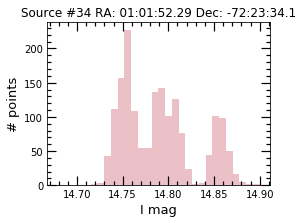



max I band:  14.9
min I band:  14.678
I range:  0.22199999999999953
I stdev:  0.04005141235208628
max V band:  15.331
min V band:  14.957
V range:  0.3739999999999988
V stdev:  0.033884701635207314


In [88]:
basic(31,pbins=16,saveall=save) 

Original source number: 39
Current source number: 35
RA,Dec (deg): 14.837658, -72.388115
Established period: 71.98
NS spin period: 201.9
Separation: 0.2821638866877138


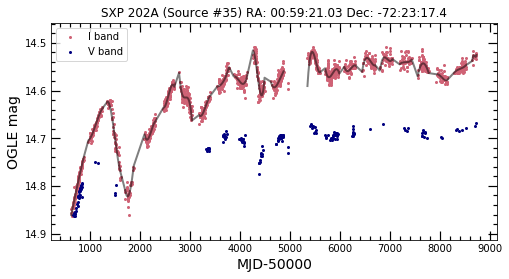

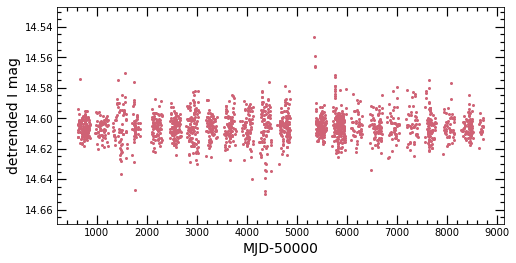

I and V-I correlation: -0.9643611604893421
V and V-I correlation: -0.896294920125472


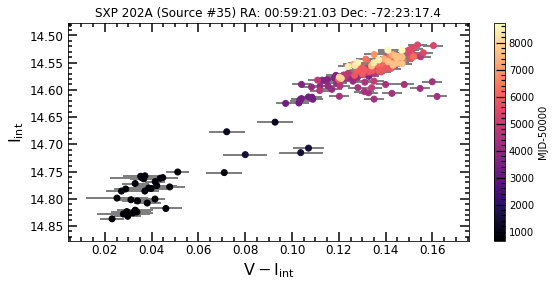

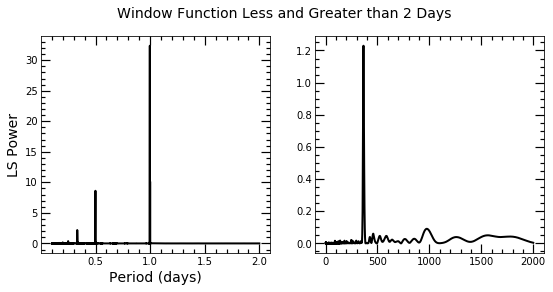

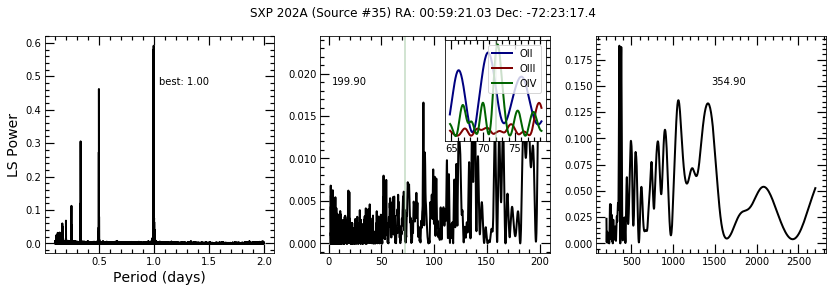

Phase-folding with established orbital period and highest peak within 7.20 days of that value...


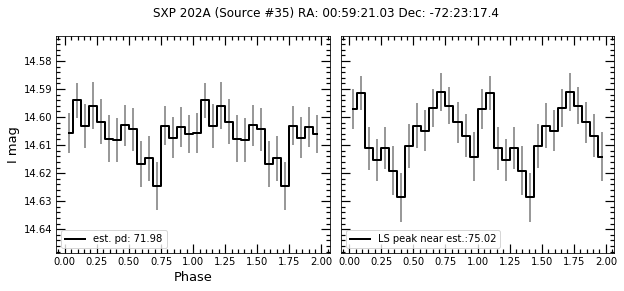

Repeating periodogram and phase-fold after detrending
Window shown in phase-fold: 143


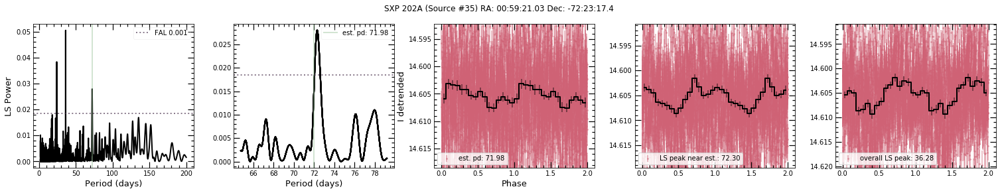

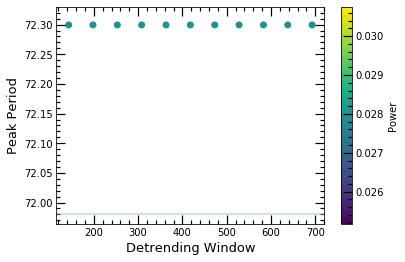

Comparing peaks of 0.1-2 day window function and detrended periodogram...
There is at least one alias of the 0.1-2 day detrended search within a day of the established period.
There is at least one alias of the 0.1-2 day window function within a day of the established period.


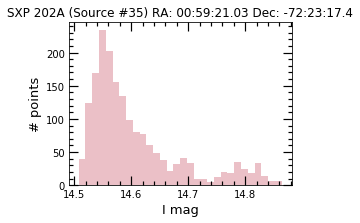



max I band:  14.864
min I band:  14.508
I range:  0.35600000000000165
I stdev:  0.0815012528918754
max V band:  14.864
min V band:  14.668
V range:  0.1960000000000015
V stdev:  0.0538520590087274


In [89]:
basic(32,pbins=16,saveall=save) 

Original source number: 40
Current source number: 36
RA,Dec (deg): 14.870287, -72.6179
Established period: 224.0
NS spin period: 202.52
Separation: 0.6262391149527577


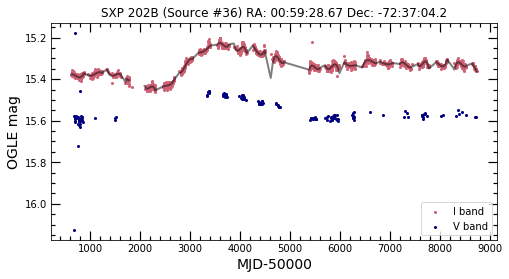

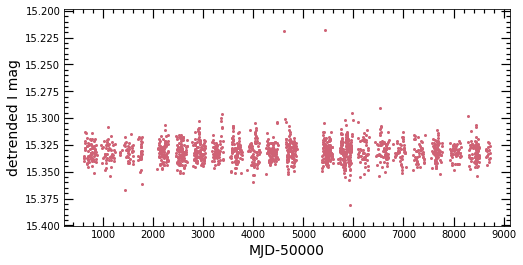

I and V-I correlation: -0.1328150587093624
V and V-I correlation: 0.7082723127854512


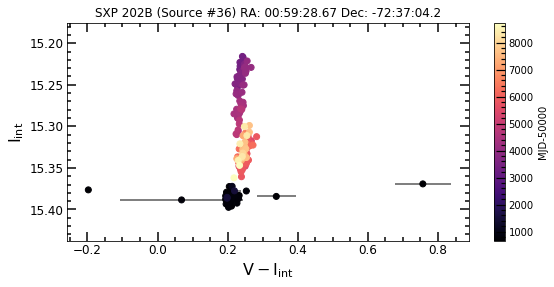

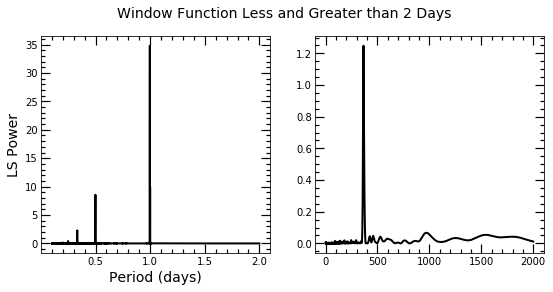

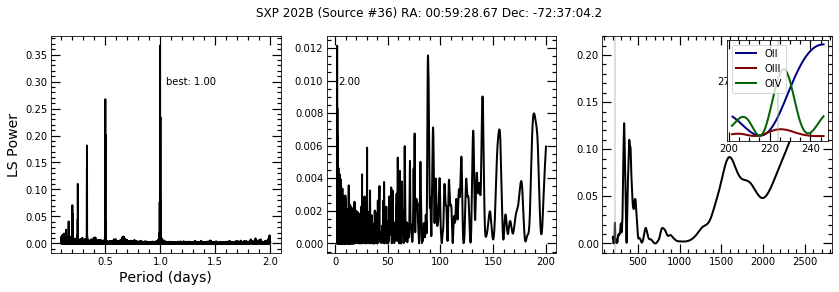

Phase-folding with established orbital period and highest peak within 22.40 days of that value...


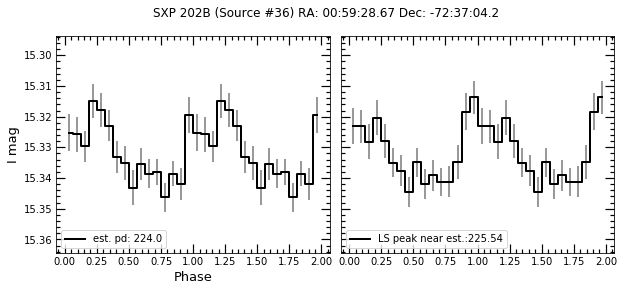

Repeating periodogram and phase-fold after detrending
Window shown in phase-fold: 448


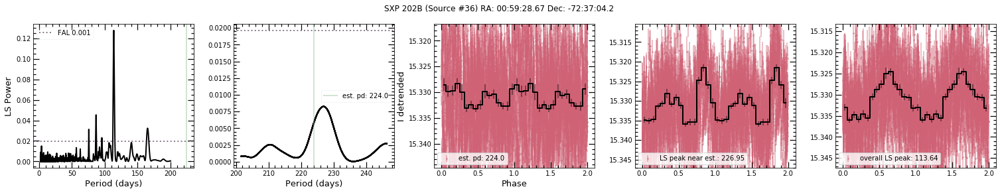

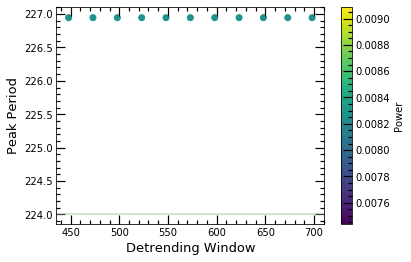

Comparing peaks of 0.1-2 day window function and detrended periodogram...


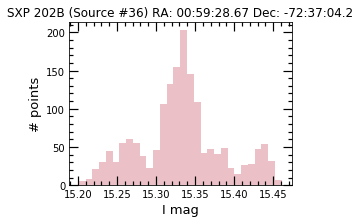



max I band:  15.461
min I band:  15.201
I range:  0.2599999999999998
I stdev:  0.054399220161783966
max V band:  16.126
min V band:  15.179
V range:  0.947000000000001
V stdev:  0.07259780056296469


In [90]:
basic(33,pbins=16,saveall=save) 

Original source number: 41
Current source number: 37
RA,Dec (deg): 12.546373, -73.006966
Established period: 29.91
NS spin period: 214.03
Separation: 1.5814828543947794


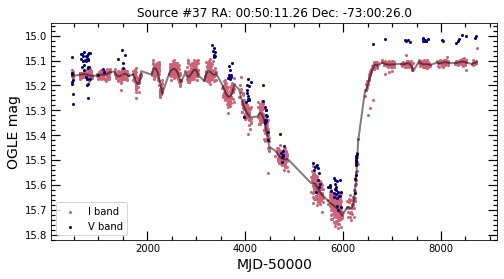

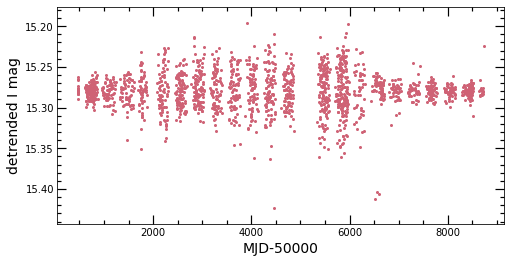

I and V-I correlation: 0.008207309264156904
V and V-I correlation: 0.1943980841976312


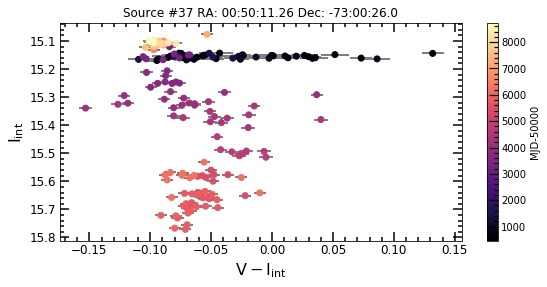

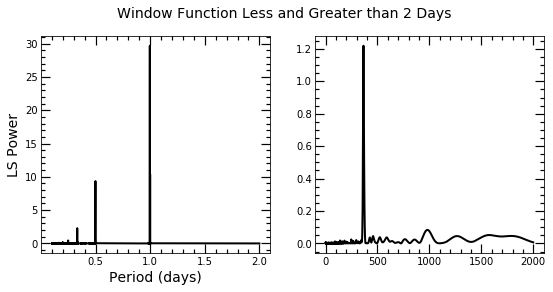

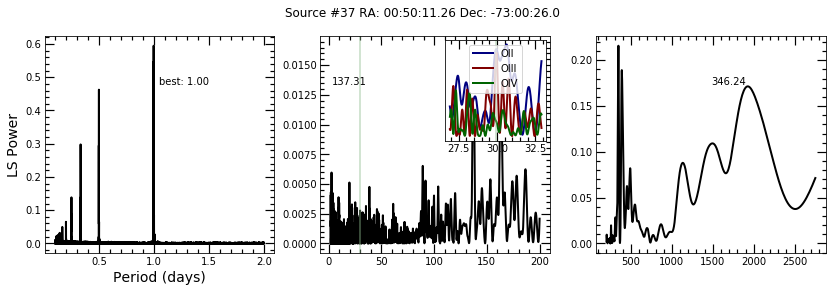

Phase-folding with established orbital period and highest peak within 2.99 days of that value...


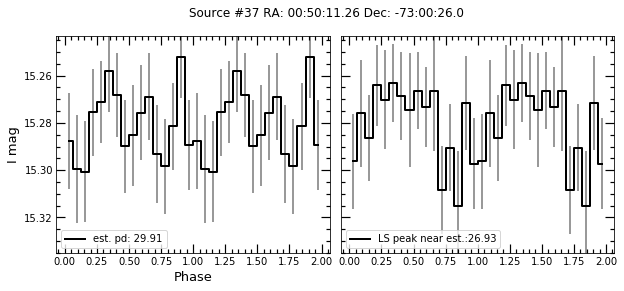

Repeating periodogram and phase-fold after detrending
Window shown in phase-fold: 59


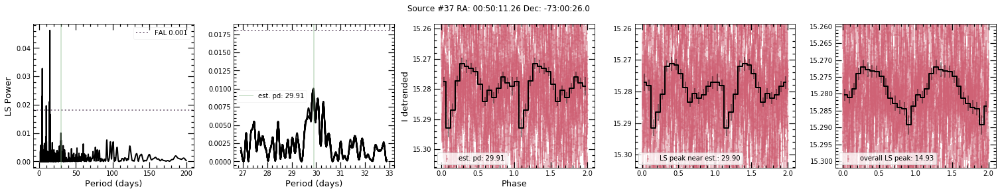

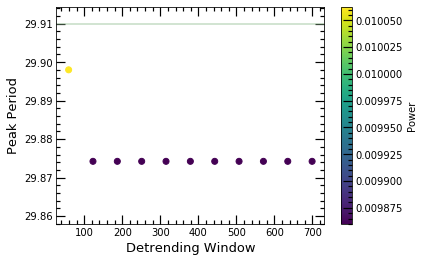

Comparing peaks of 0.1-2 day window function and detrended periodogram...
There is at least one alias of the 0.1-2 day detrended search within a day of the established period.
There is at least one alias of the 0.1-2 day window function within a day of the established period.


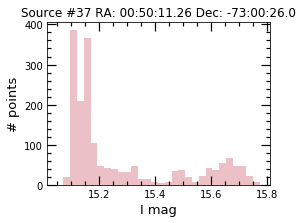



max I band:  15.773
min I band:  15.049
I range:  0.7240000000000002
I stdev:  0.20818184410753487
max V band:  15.7
min V band:  14.998
V range:  0.702
V stdev:  0.2208849806177537


In [91]:
basic(34,pbins=16,saveall=save) 

Original source number: 44
Current source number: 39
RA,Dec (deg): 14.455669, -72.0432
Established period: 64.8
NS spin period: 280.4
Separation: 1.1730494581195174


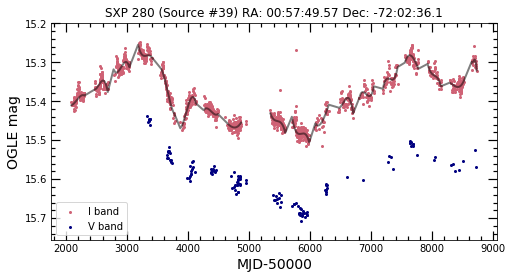

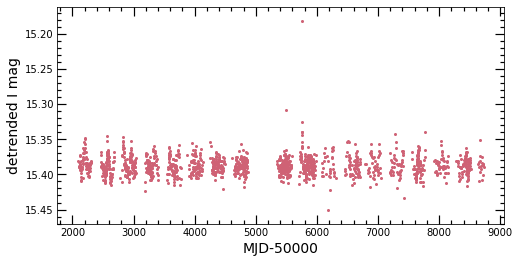

I and V-I correlation: -0.3307595869470501
V and V-I correlation: 0.18286634755303952


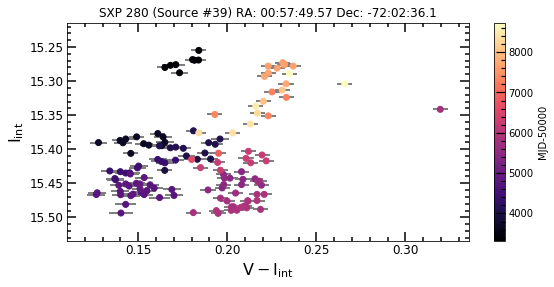

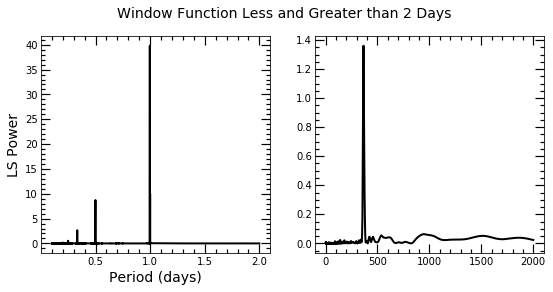

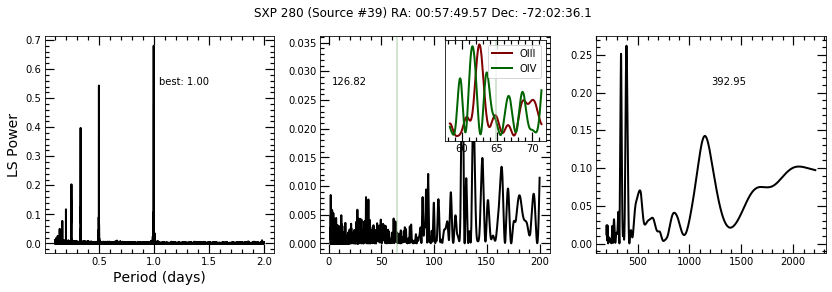

Phase-folding with established orbital period and highest peak within 6.48 days of that value...


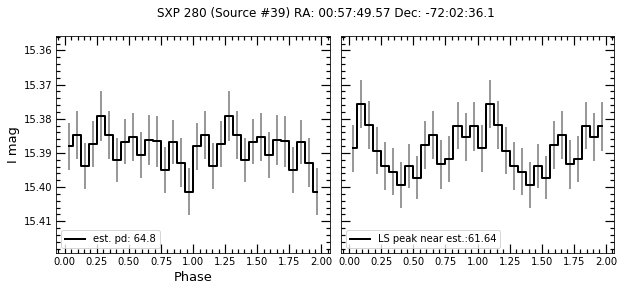

Repeating periodogram and phase-fold after detrending
Window shown in phase-fold: 129


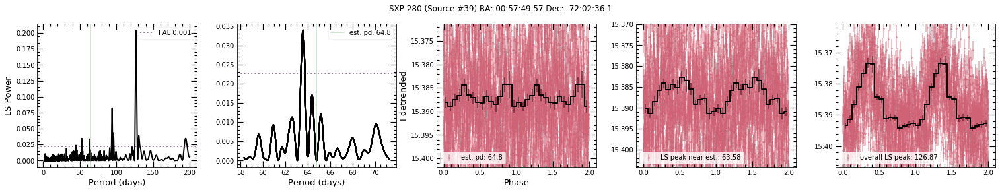

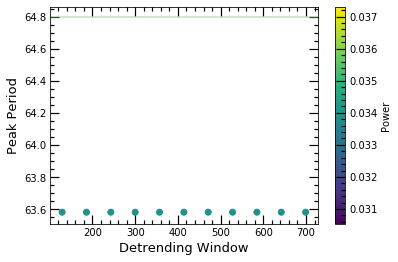

Comparing peaks of 0.1-2 day window function and detrended periodogram...
There is at least one alias of the 0.1-2 day detrended search within a day of the established period.
There is at least one alias of the 0.1-2 day window function within a day of the established period.


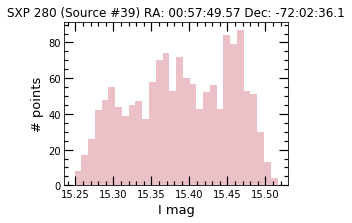



max I band:  15.516
min I band:  15.249
I range:  0.26699999999999946
I stdev:  0.06577033615797583
max V band:  15.707
min V band:  15.439
V range:  0.2680000000000007
V stdev:  0.06304302923645508


In [92]:
basic(35,pbins=16,saveall=save) 

Original source number: 45
Current source number: 40
RA,Dec (deg): 14.553074, -72.513435
Established period: 59.77
NS spin period: 291.33
Separation: 0.41709698577795423


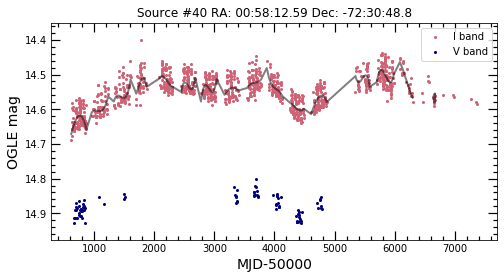

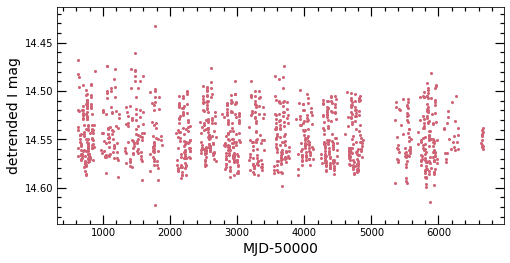

I and V-I correlation: -0.8021221876899689
V and V-I correlation: -0.33698392814060957


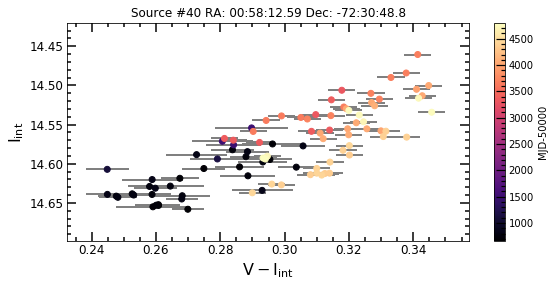

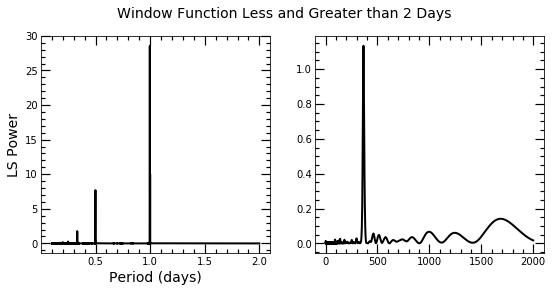

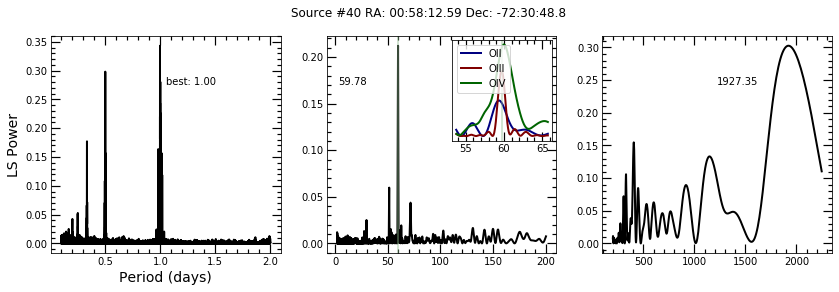

Phase-folding with established orbital period and highest peak within 5.98 days of that value...


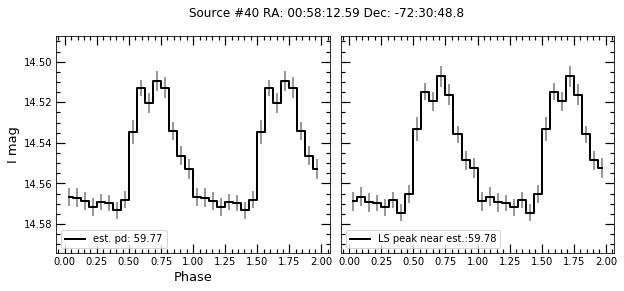

Repeating periodogram and phase-fold after detrending
Window shown in phase-fold: 119


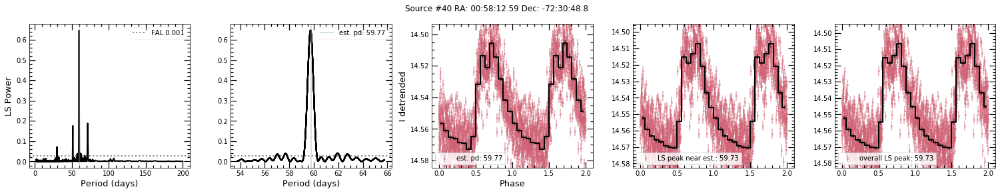

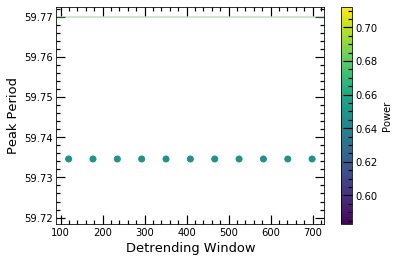

Comparing peaks of 0.1-2 day window function and detrended periodogram...
Beat period of highest peaks is 59.74726506821756.
There is at least one alias of the 0.1-2 day detrended search within a day of the established period.
There is at least one alias of the 0.1-2 day window function within a day of the established period.


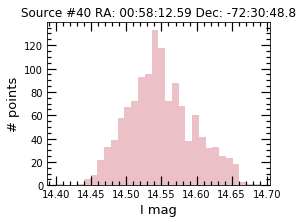



max I band:  14.69
min I band:  14.401
I range:  0.2889999999999997
I stdev:  0.04683437454272839
max V band:  14.928
min V band:  14.802
V range:  0.12600000000000122
V stdev:  0.029054857790808086


In [93]:
basic(36,pbins=16,saveall=save) 

Original source number: 46
Current source number: 41
RA,Dec (deg): 12.700255, -73.30488
Established period: nan
NS spin period: 292.7
Separation: 0.6973619196184568


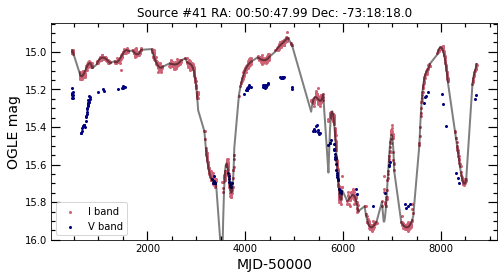

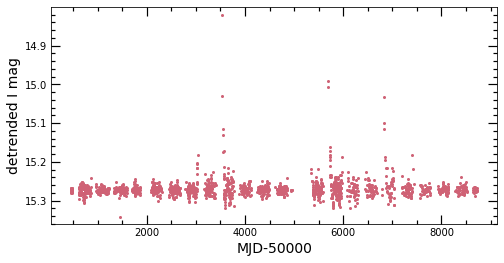

I and V-I correlation: -0.8678520855167449
V and V-I correlation: -0.7253066994414351


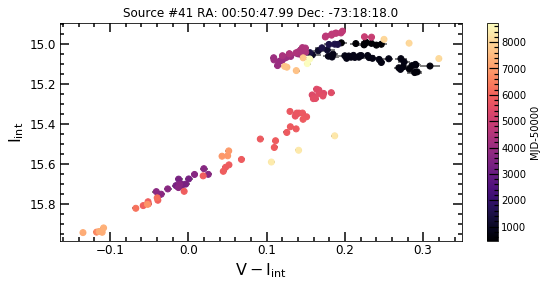

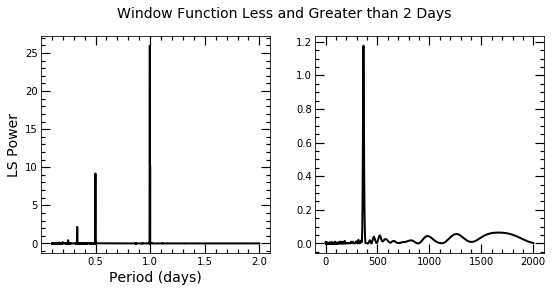

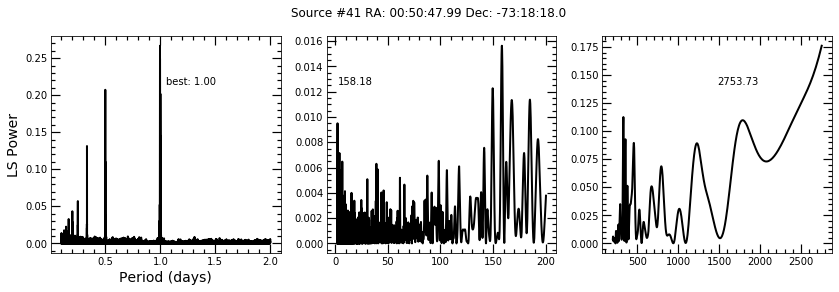

using best period from middle periodogram to phase-fold data, after detrending with 701
running periodogram on detrended data


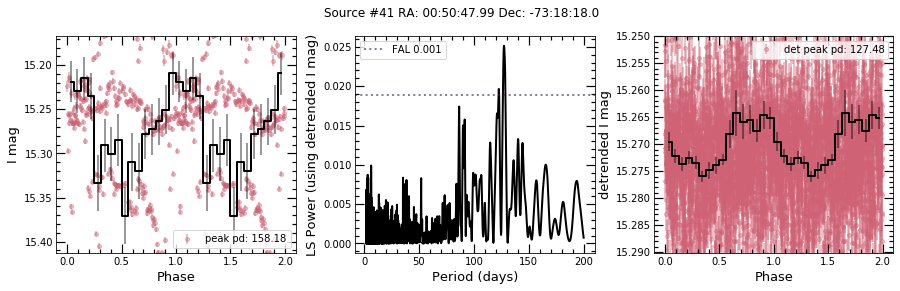

Comparing peaks of 0.1-2 day window function and detrended periodogram...
There is at least one alias of the 0.1-2 day detrended search within a day of 127.47583740442899 days (the detrended peak).
There is at least one alias of the 0.1-2 day window function within a day of 127.47583740442899 days (the detrended peak).


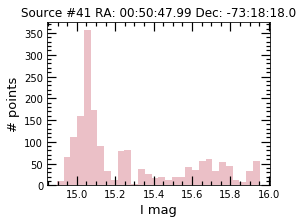



max I band:  15.953
min I band:  14.896
I range:  1.0569999999999986
I stdev:  0.3013052126646709
max V band:  15.831
min V band:  15.133
V range:  0.6980000000000004
V stdev:  0.21363505112138753


In [94]:
basic(37,pbins=16,saveall=save) 

Original source number: 47
Current source number: 42
RA,Dec (deg): 15.26147, -72.11614
Established period: 344.0
NS spin period: 304.5
Separation: 0.8300844587673507


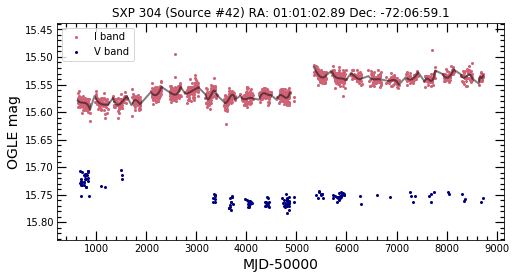

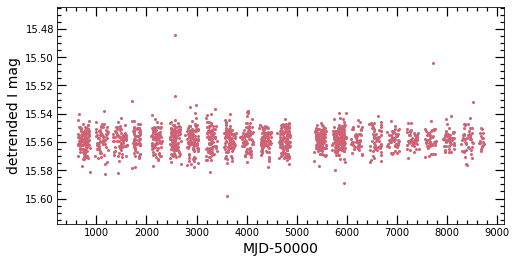

I and V-I correlation: -0.8153045136698245
V and V-I correlation: 0.7684901282287183


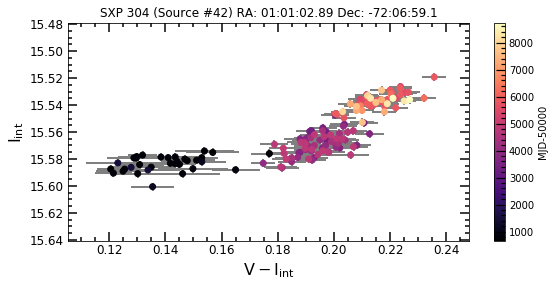

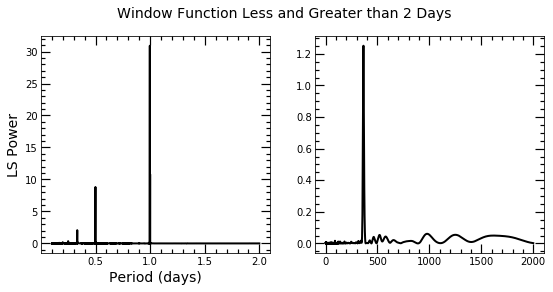

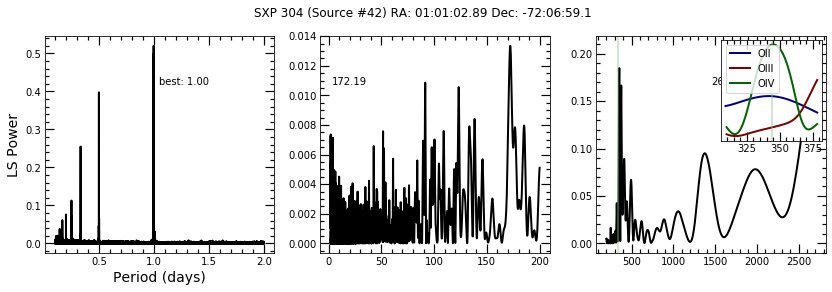

Phase-folding with established orbital period and highest peak within 34.40 days of that value...


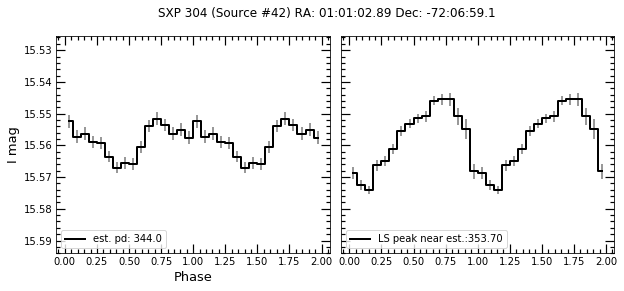

Repeating periodogram and phase-fold after detrending
Window shown in phase-fold: 688


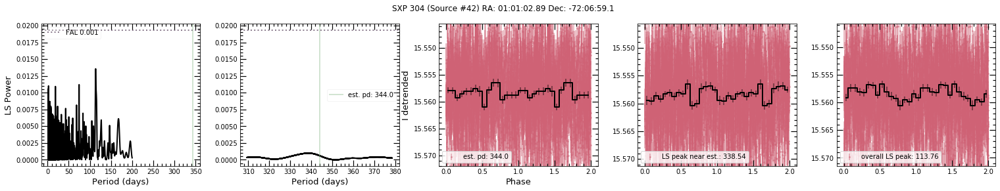

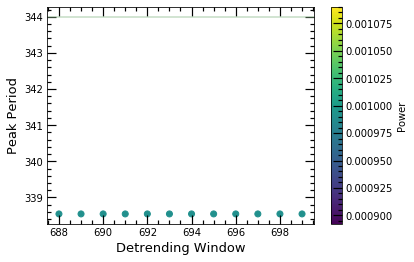

Comparing peaks of 0.1-2 day window function and detrended periodogram...


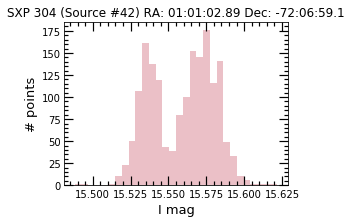



max I band:  15.622
min I band:  15.488
I range:  0.13400000000000034
I stdev:  0.02040542178041749
max V band:  15.783
min V band:  15.706
V range:  0.07699999999999996
V stdev:  0.017455126480298375


In [95]:
basic(38,pbins=16,saveall=save) #check calibration; saves without detrending since period high
#could easily be peak from sampling so be careful in reporting

Original source number: 48
Current source number: 43
RA,Dec (deg): 13.064167, -73.32083
Established period: 1163.0
NS spin period: 305.69
Separation: nan


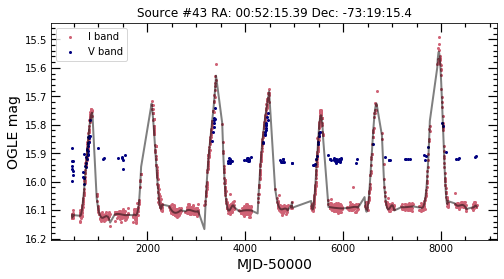

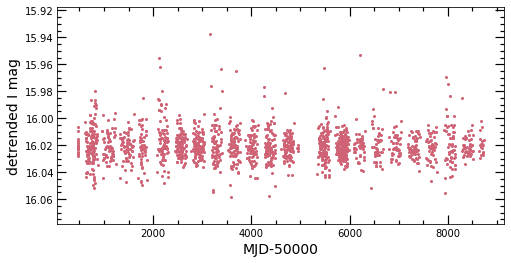

I and V-I correlation: -0.9708981007790428
V and V-I correlation: -0.7540319474968079


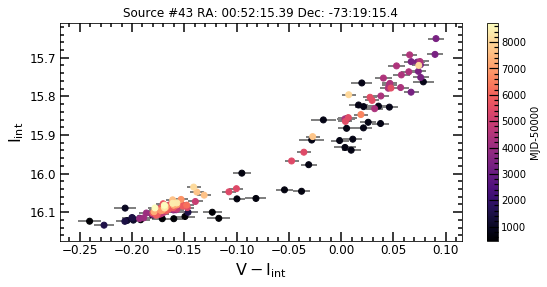

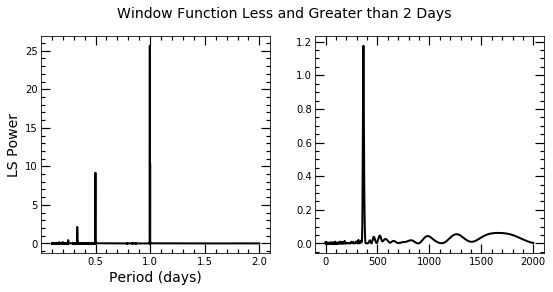

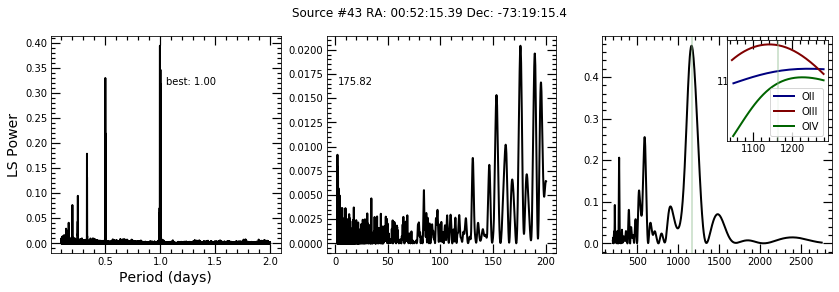

Phase-folding with established orbital period and highest peak within 116.30 days of that value...


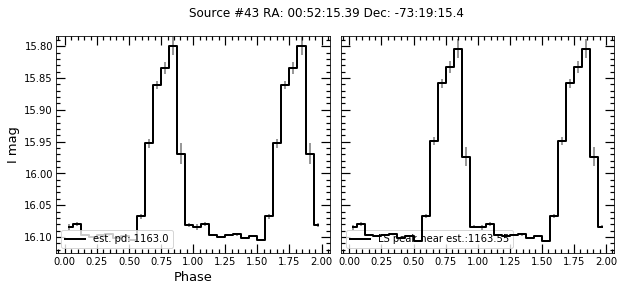

Repeating periodogram and phase-fold after detrending
Window shown in phase-fold: 2326


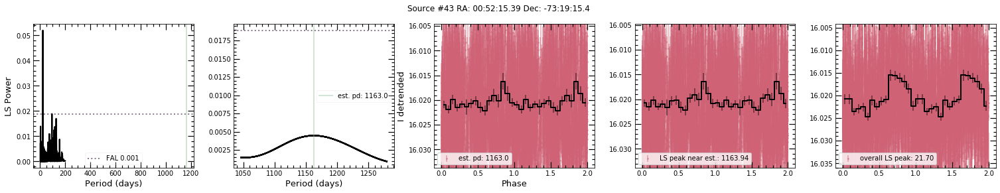

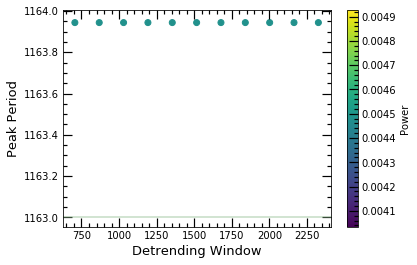

Comparing peaks of 0.1-2 day window function and detrended periodogram...


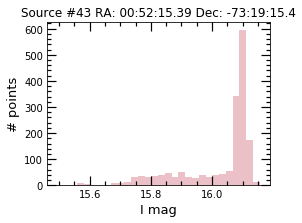



max I band:  16.156
min I band:  15.492
I range:  0.6639999999999979
I stdev:  0.12397650458894773
max V band:  16.008
min V band:  15.741
V range:  0.26699999999999946
V stdev:  0.05122137401081268


In [96]:
basic(39,pbins=16,saveall=save) #look into 175 day period; saves fold without detrending

In [79]:
phase[phase['src_n']==48] #period may be changing from the look of LC, width of peak

,src_n,period,amp,phase diff,phase max,phase min,shape,diff mean,mean,skew,kurtosis,symm sum,mean err
43,48,1170.54,0.310298,0.75,0.53125,0.78125,not FRED,0.0759666,16.0269,-1.19812,-0.258374,0.0165263,0.00456476


Original source number: 49
Current source number: 44
RA,Dec (deg): 12.685833, -73.26806
Established period: 116.6
NS spin period: 323.2
Separation: 0.4671011406475931


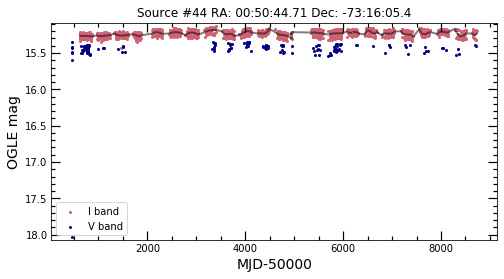

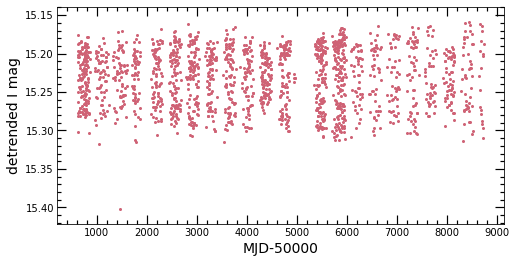

I and V-I correlation: 0.11155486877389752
V and V-I correlation: 0.9805012467253508


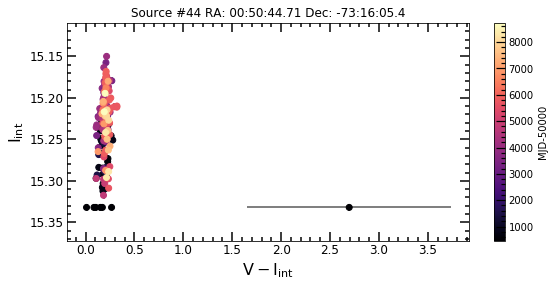

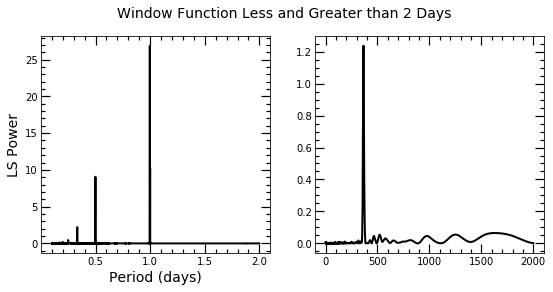

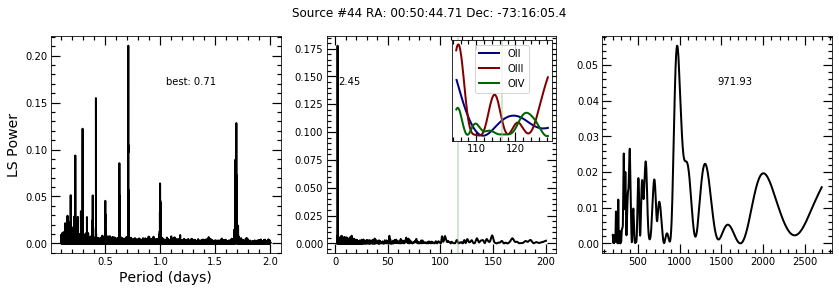

Phase-folding with established orbital period and highest peak within 11.66 days of that value...


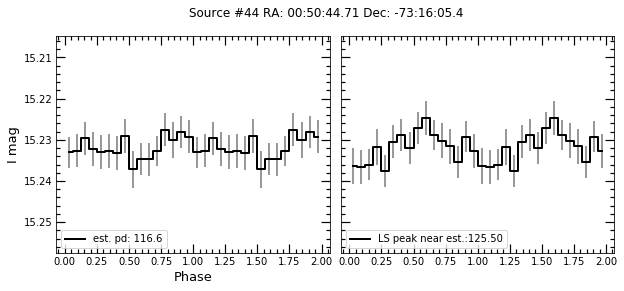

Repeating periodogram and phase-fold after detrending
Window shown in phase-fold: 233


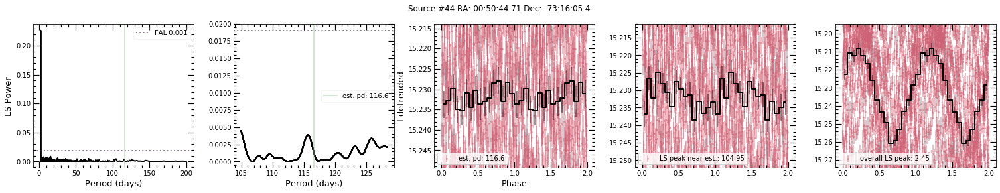

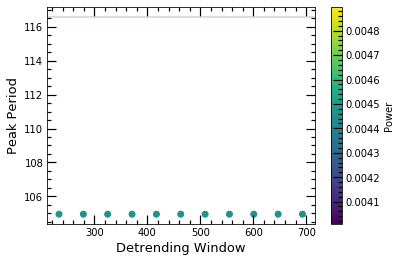

Comparing peaks of 0.1-2 day window function and detrended periodogram...


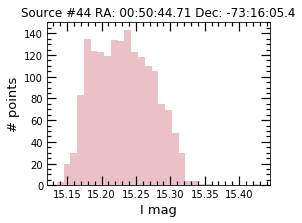



max I band:  15.43
min I band:  15.135
I range:  0.29499999999999993
I stdev:  0.04219818187223118
max V band:  18.028
min V band:  15.342
V range:  2.685999999999998
V stdev:  0.2140718354123578


In [97]:
basic(40,pbins=16,saveall=save) #V outlier should be thrown out if using these figs

Original source number: 50
Current source number: 45
RA,Dec (deg): 13.21725, -72.287445
Established period: 45.9
NS spin period: 325.4
Separation: 0.375829580201356


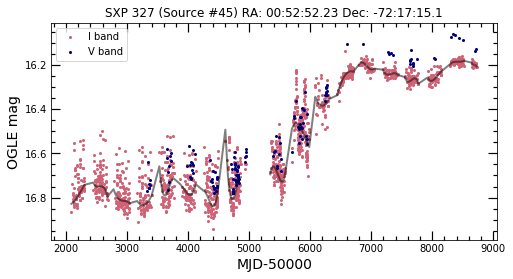

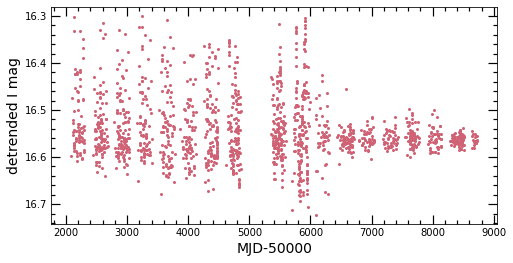

I and V-I correlation: -0.3076089999036358
V and V-I correlation: -0.14108535704213498


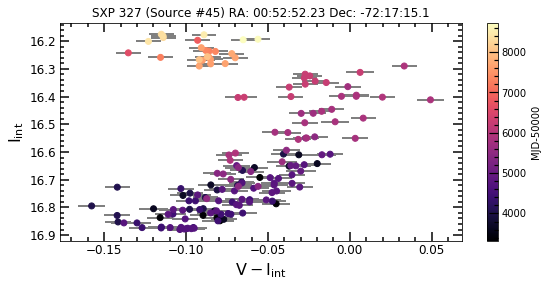

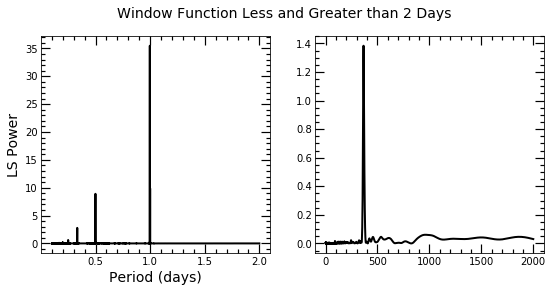

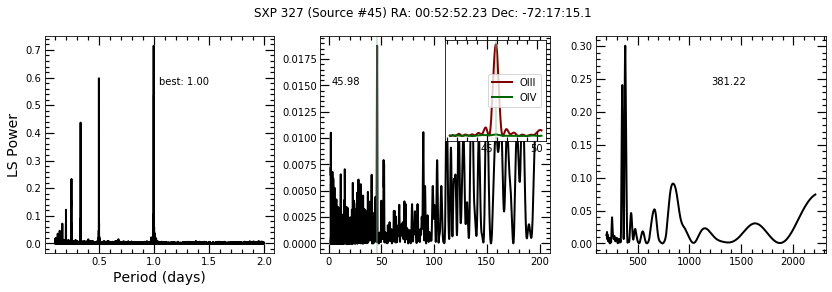

Phase-folding with established orbital period and highest peak within 4.59 days of that value...


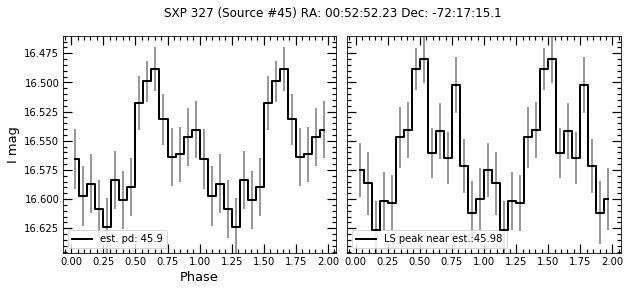

Repeating periodogram and phase-fold after detrending
Window shown in phase-fold: 151


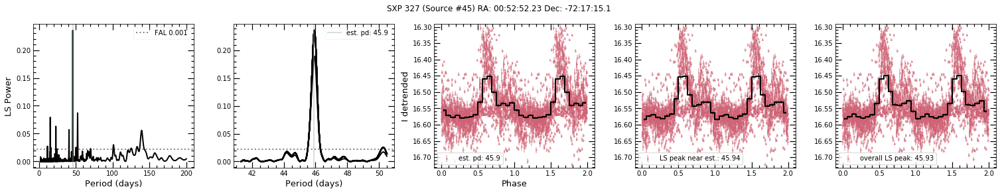

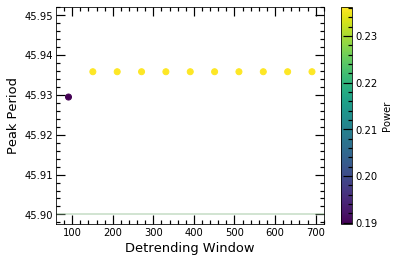

Comparing peaks of 0.1-2 day window function and detrended periodogram...
Beat period of highest peaks is 45.93831426397347.
There is at least one alias of the 0.1-2 day detrended search within a day of the established period.
There is at least one alias of the 0.1-2 day window function within a day of the established period.


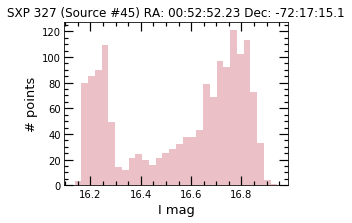



max I band:  16.943
min I band:  16.137
I range:  0.8060000000000009
I stdev:  0.23761270166267262
max V band:  16.78
min V band:  16.06
V range:  0.7200000000000024
V stdev:  0.21121192591284443


In [100]:
basic(41,pbins=16,saveall=save,medlim=False) 

In [74]:
# basic(42,pbins=16,saveall=save) #error here from reading in table --> look into table

Original source number: 52
Current source number: 47
RA,Dec (deg): 15.808084, -72.154
Established period: 94.4
NS spin period: 345.2
Separation: 0.046253789717849166


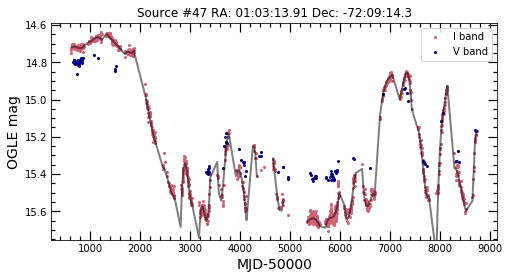

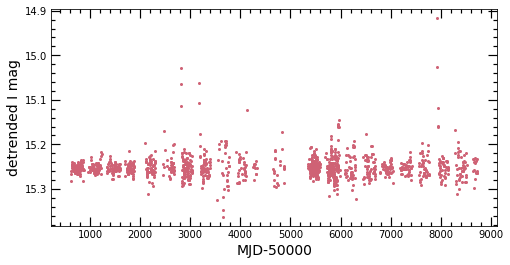

I and V-I correlation: -0.9785549907580339
V and V-I correlation: -0.9517984312008556


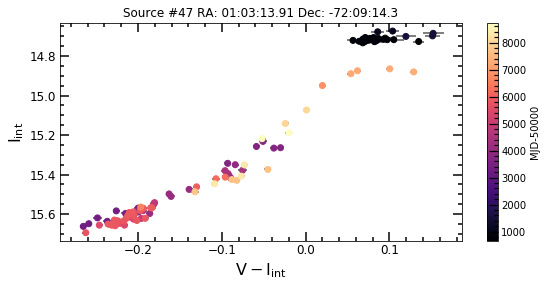

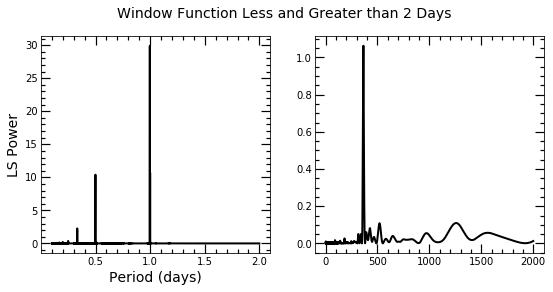

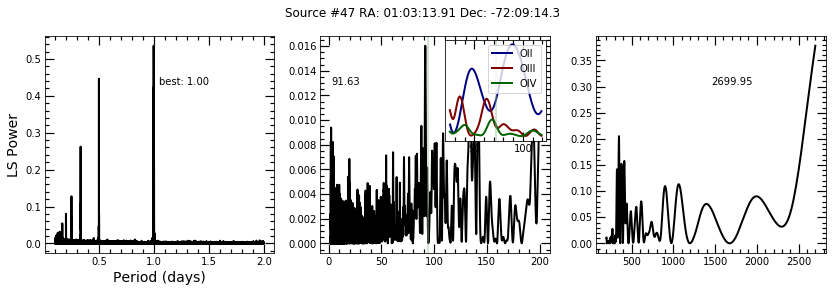

Phase-folding with established orbital period and highest peak within 9.44 days of that value...


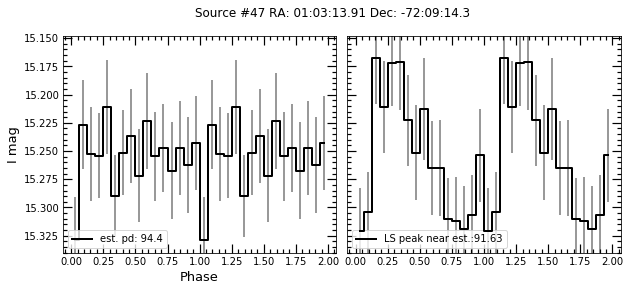

Repeating periodogram and phase-fold after detrending
Window shown in phase-fold: 188


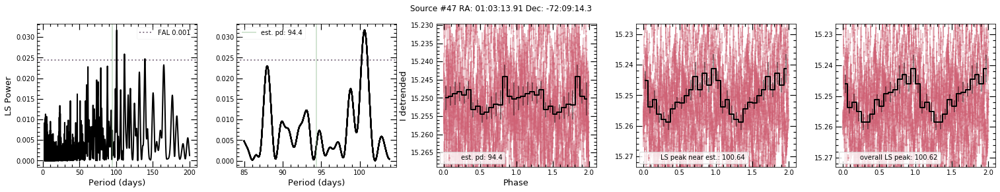

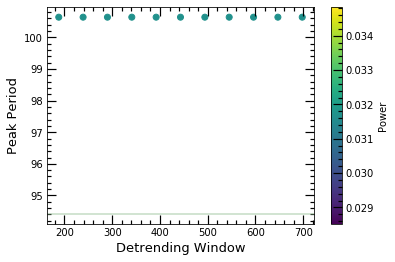

Comparing peaks of 0.1-2 day window function and detrended periodogram...
Beat period of highest peaks is 100.6941726752851.
There is at least one alias of the 0.1-2 day detrended search within a day of the established period.
There is at least one alias of the 0.1-2 day window function within a day of the established period.


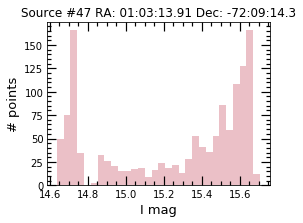



max I band:  15.706
min I band:  14.638
I range:  1.0679999999999996
I stdev:  0.3699604288081181
max V band:  15.44
min V band:  14.763
V range:  0.6769999999999996
V stdev:  0.2626095422555576


In [101]:
basic(43,pbins=16,saveall=save) 

Original source number: 53
Current source number: 48
RA,Dec (deg): 15.336185, -72.188614
Established period: 74.96
NS spin period: 455.0
Separation: 0.022983953412039876


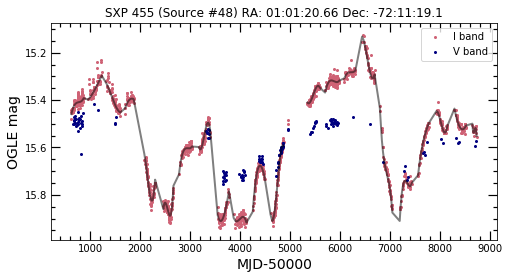

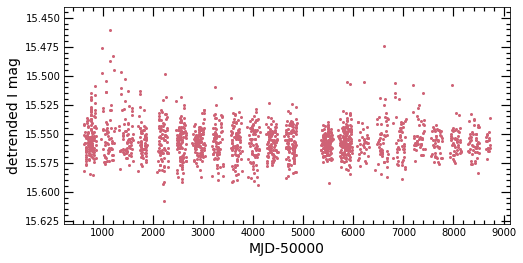

I and V-I correlation: -0.9742088876621257
V and V-I correlation: -0.8733781158456216


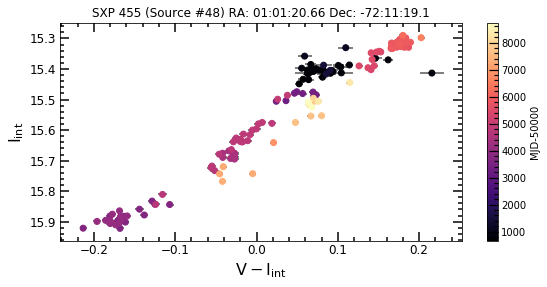

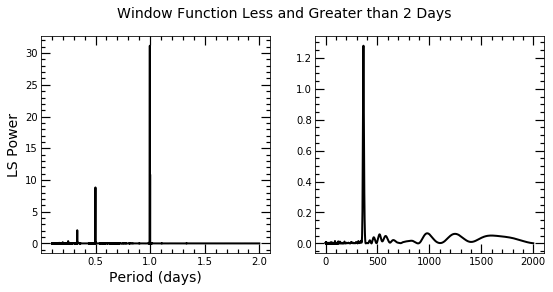

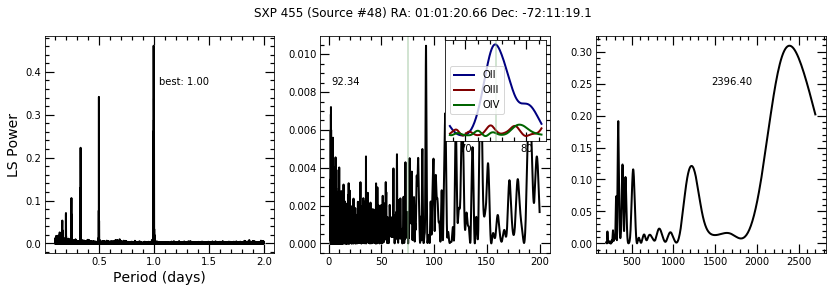

Phase-folding with established orbital period and highest peak within 7.50 days of that value...


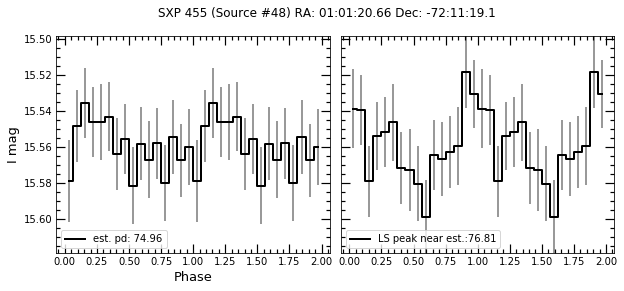

Repeating periodogram and phase-fold after detrending
Window shown in phase-fold: 149


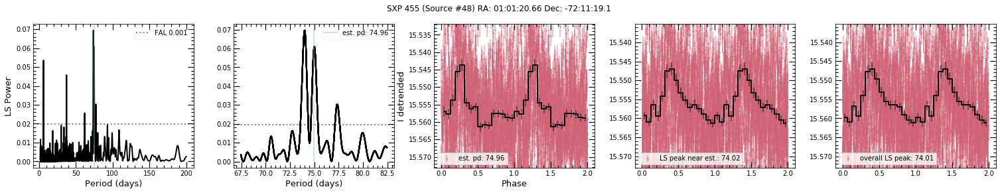

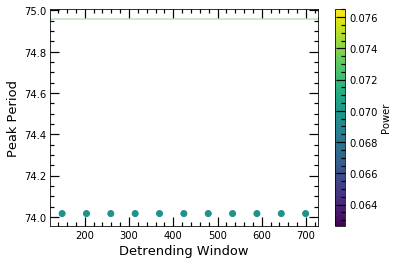

Comparing peaks of 0.1-2 day window function and detrended periodogram...
Beat period of highest peaks is 74.05228789541023.
There is at least one alias of the 0.1-2 day detrended search within a day of the established period.
There is at least one alias of the 0.1-2 day window function within a day of the established period.


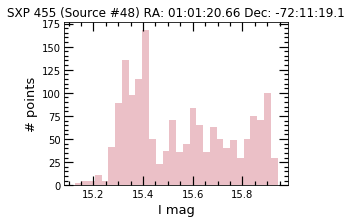



max I band:  15.942
min I band:  15.124
I range:  0.8179999999999996
I stdev:  0.20838471610448372
max V band:  15.754
min V band:  15.417
V range:  0.33699999999999974
V stdev:  0.09185714537016472


In [102]:
basic(44,pbins=16,saveall=save) 

Original source number: 54
Current source number: 49
RA,Dec (deg): 13.733069, -72.75302
Established period: 265.3
NS spin period: 499.2
Separation: 0.4530185028467763


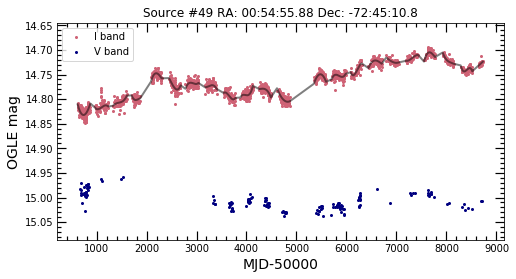

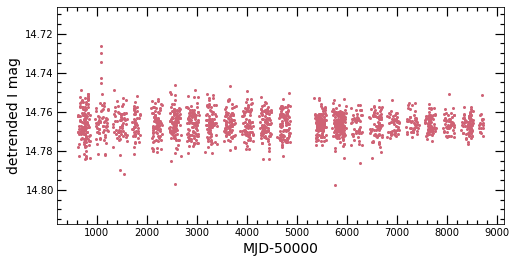

I and V-I correlation: -0.9237937740981867
V and V-I correlation: 0.5490350308625792


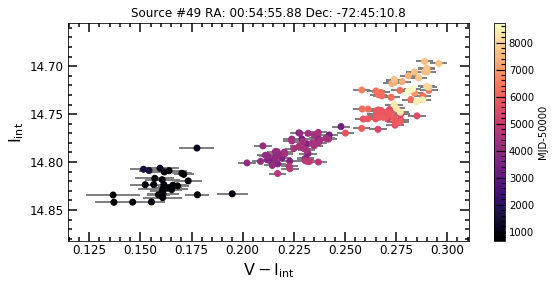

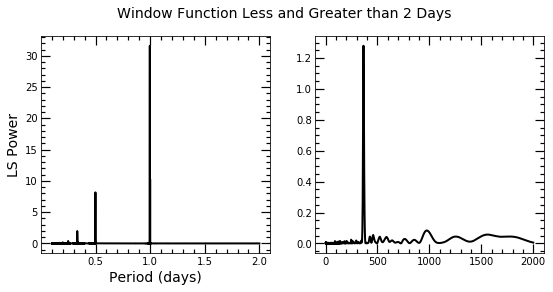

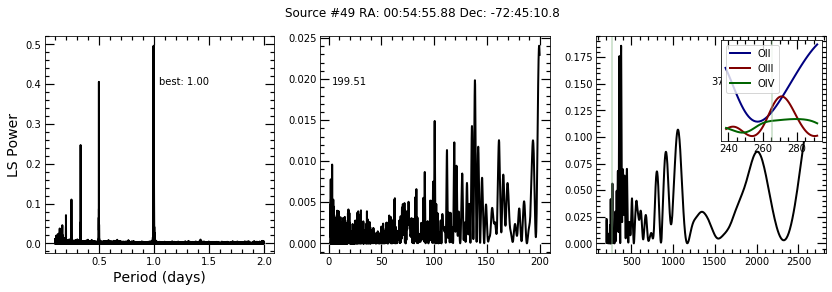

Phase-folding with established orbital period and highest peak within 26.53 days of that value...


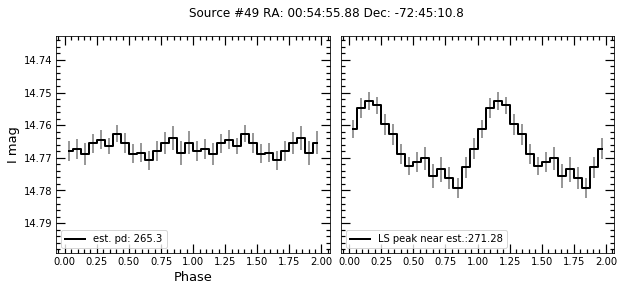

Repeating periodogram and phase-fold after detrending
Window shown in phase-fold: 530


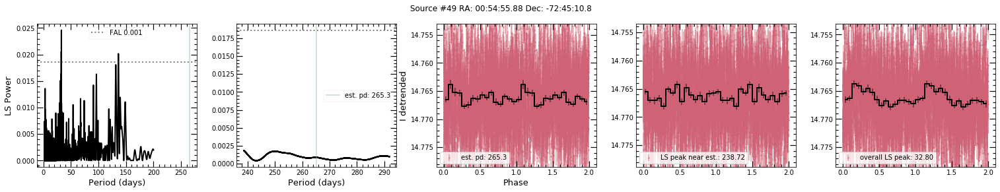

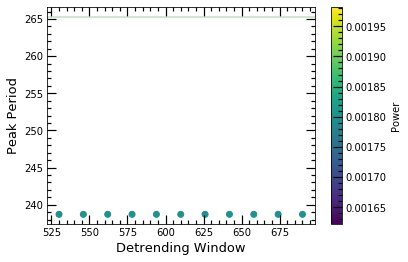

Comparing peaks of 0.1-2 day window function and detrended periodogram...


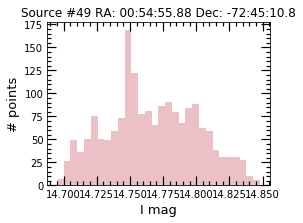



max I band:  14.848
min I band:  14.695
I range:  0.15300000000000047
I stdev:  0.03379515414677893
max V band:  15.037
min V band:  14.959
V range:  0.07800000000000118
V stdev:  0.01693277246566304


In [103]:
basic(45,pbins=16,saveall=save) #look into 199.51

Original source number: 55
Current source number: 50
RA,Dec (deg): 15.697975, -72.0808
Established period: nan
NS spin period: 522.5
Separation: 1.0825526293151113


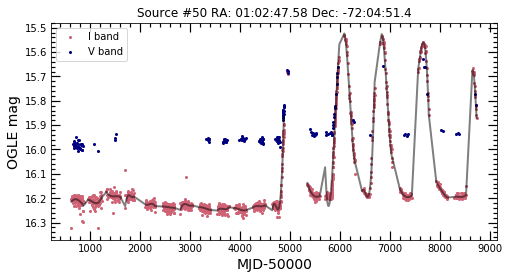

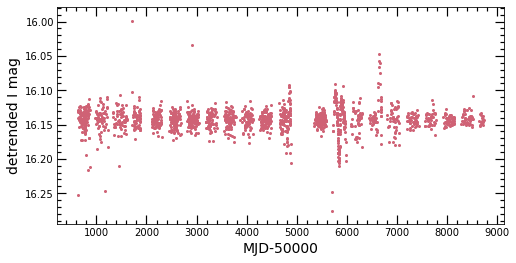

I and V-I correlation: -0.9784986197610509
V and V-I correlation: -0.8992727263873777


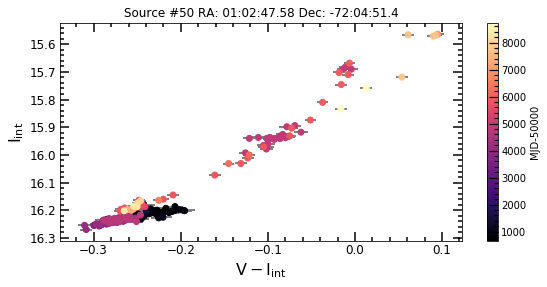

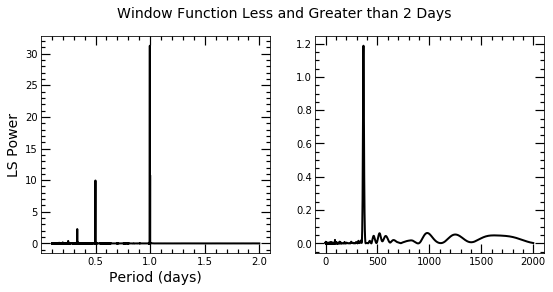

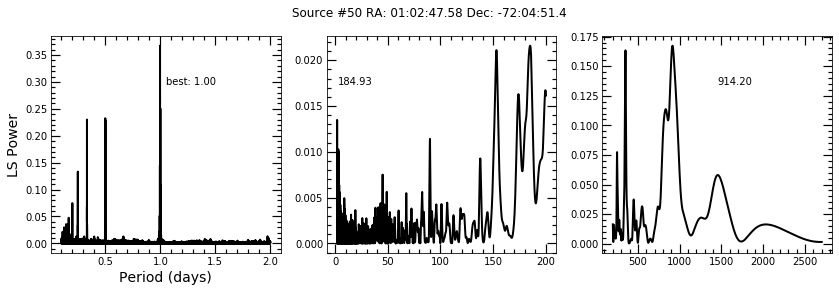

using best period from middle periodogram to phase-fold data, after detrending with 701
running periodogram on detrended data


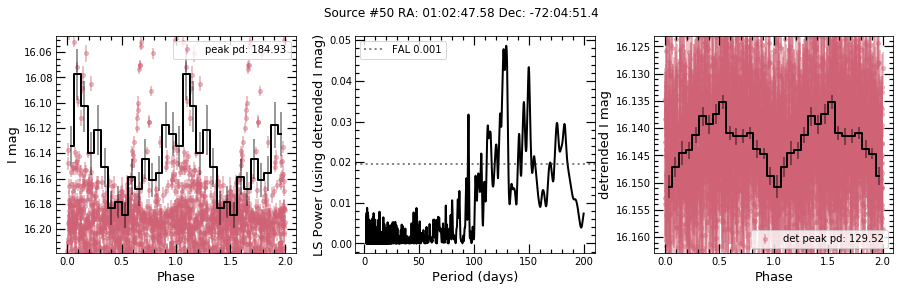

Comparing peaks of 0.1-2 day window function and detrended periodogram...
There is at least one alias of the 0.1-2 day detrended search within a day of 129.51620320831992 days (the detrended peak).
There is at least one alias of the 0.1-2 day window function within a day of 129.51620320831992 days (the detrended peak).


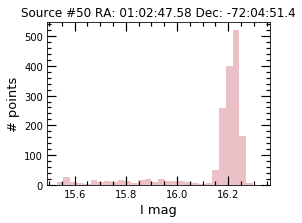



max I band:  16.323
min I band:  15.53
I range:  0.793000000000001
I stdev:  0.16862670513393746
max V band:  16.006
min V band:  15.627
V range:  0.37899999999999956
V stdev:  0.08029740848947102


In [106]:
basic(46,pbins=16,saveall=save) #OGLE IV has most of those Type 1 peaks

Original source number: 56
Current source number: 51
RA,Dec (deg): 14.400833, -72.32611
Established period: 151.0
NS spin period: 565.0
Separation: 0.6676884237679841


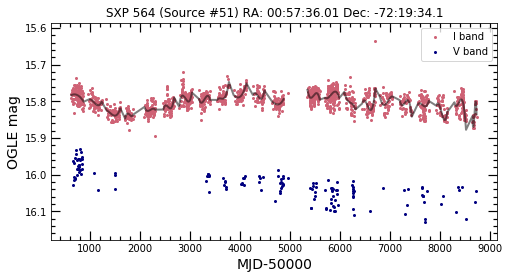

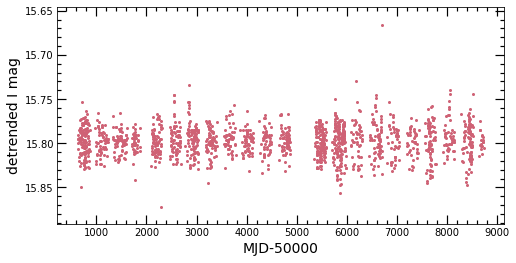

I and V-I correlation: -0.13487099077743647
V and V-I correlation: 0.869350429450435


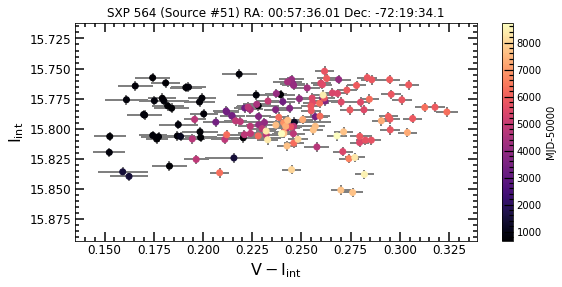

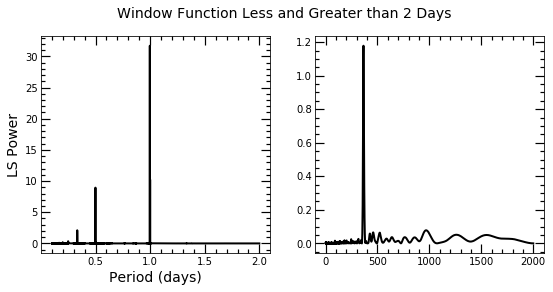

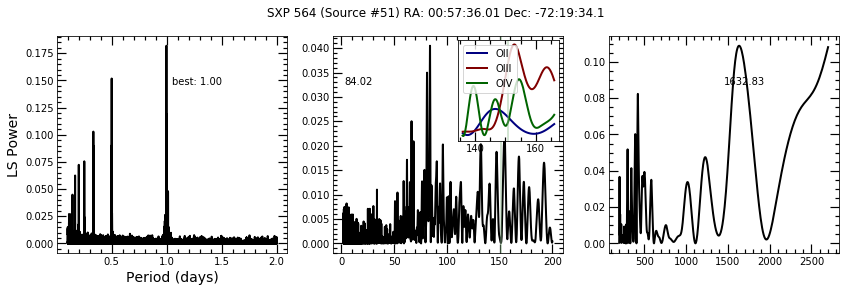

Phase-folding with established orbital period and highest peak within 15.10 days of that value...


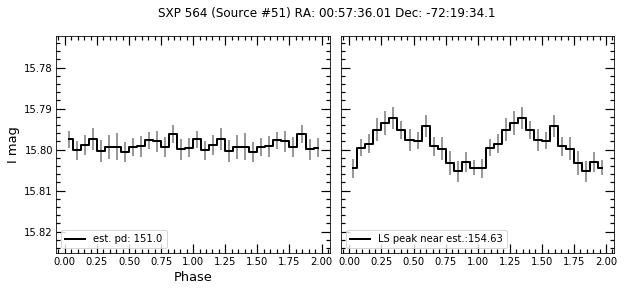

Repeating periodogram and phase-fold after detrending
Window shown in phase-fold: 302


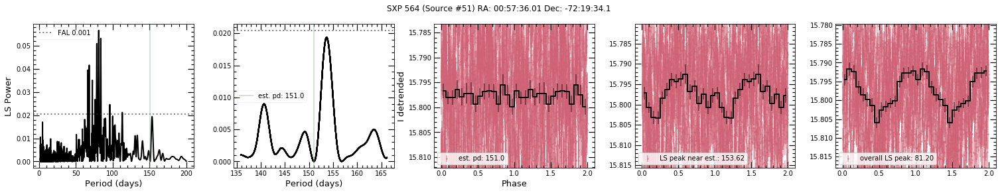

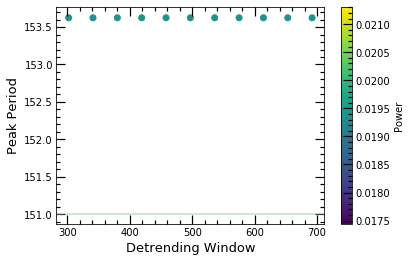

Comparing peaks of 0.1-2 day window function and detrended periodogram...


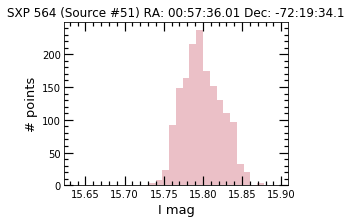



max I band:  15.895
min I band:  15.636
I range:  0.25900000000000034
I stdev:  0.025057228199954144
max V band:  16.129
min V band:  15.93
V range:  0.19900000000000162
V stdev:  0.04143523063444496


In [107]:
basic(47,pbins=16,saveall=save) 

Original source number: 57
Current source number: 52
RA,Dec (deg): 13.897454, -72.485176
Established period: nan
NS spin period: 644.6
Separation: 0.8191807638607439


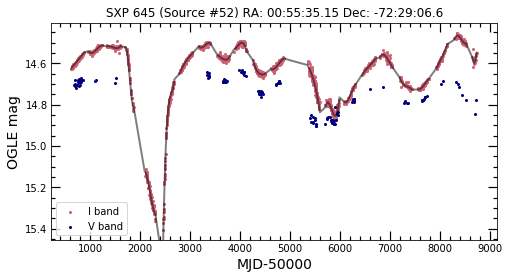

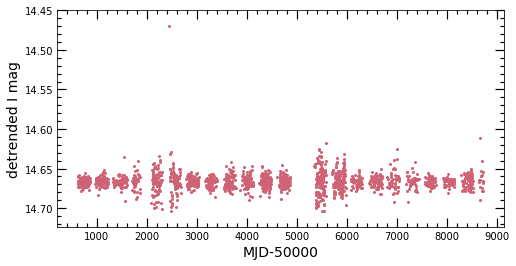

I and V-I correlation: -0.6687374569794301
V and V-I correlation: -0.21199712351210293


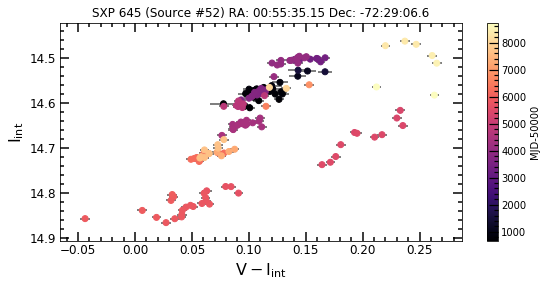

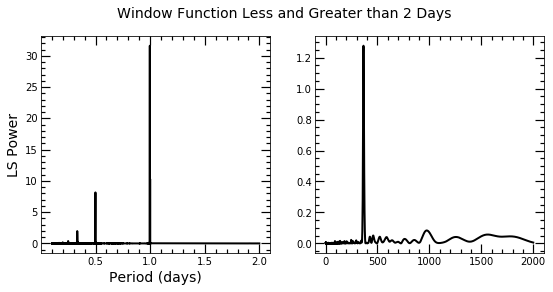

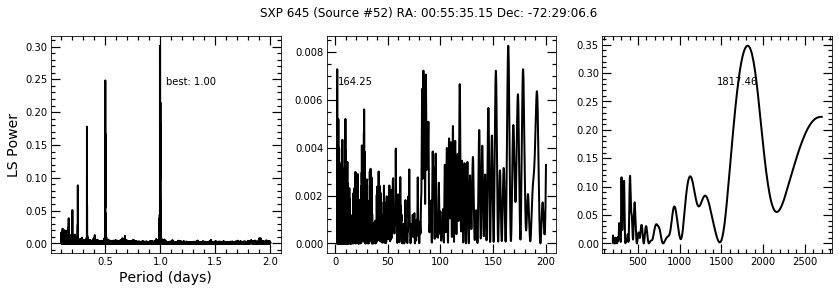

using best period from middle periodogram to phase-fold data, after detrending with 701
running periodogram on detrended data


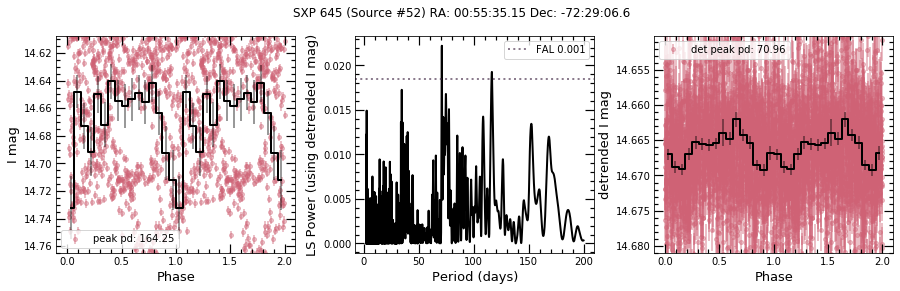

Comparing peaks of 0.1-2 day window function and detrended periodogram...
Beat period of highest peaks is 70.81854962432342.
There is at least one alias of the 0.1-2 day detrended search within a day of 70.96147944141548 days (the detrended peak).
There is at least one alias of the 0.1-2 day window function within a day of 70.96147944141548 days (the detrended peak).


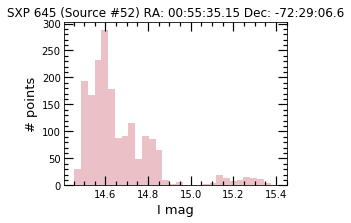



max I band:  15.406
min I band:  14.454
I range:  0.952
I stdev:  0.17340324912036056
max V band:  14.903
min V band:  14.631
V range:  0.27200000000000024
V stdev:  0.07935137696121616


In [108]:
basic(48,pbins=16,saveall=save) 

Original source number: 58
Current source number: 53
RA,Dec (deg): 13.826359, -72.64776
Established period: 412.0
NS spin period: 701.6
Separation: 0.7236213078134346


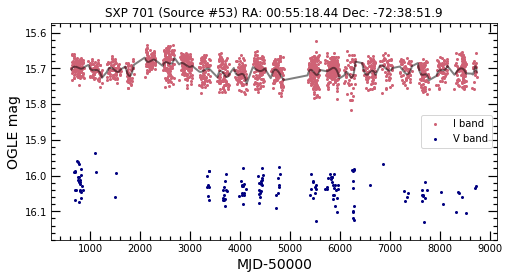

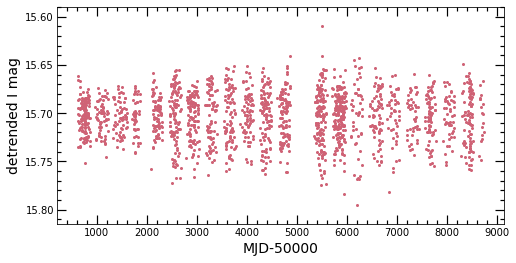

I and V-I correlation: -0.20537467673685186
V and V-I correlation: 0.7572808895955526


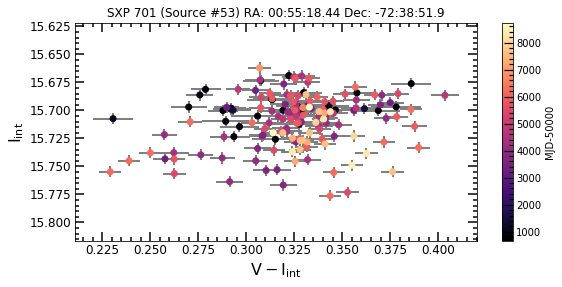

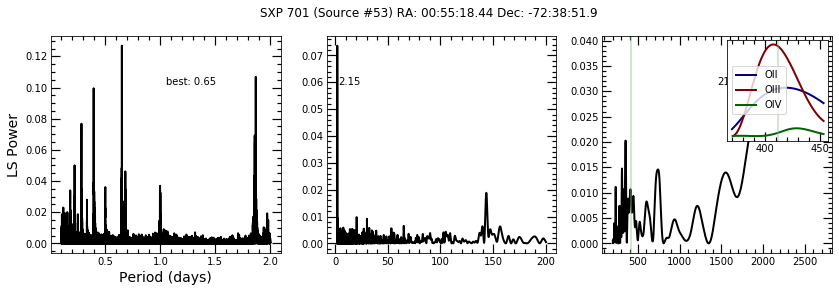

Phase-folding with established orbital period and highest peak within 41.20 days of that value...


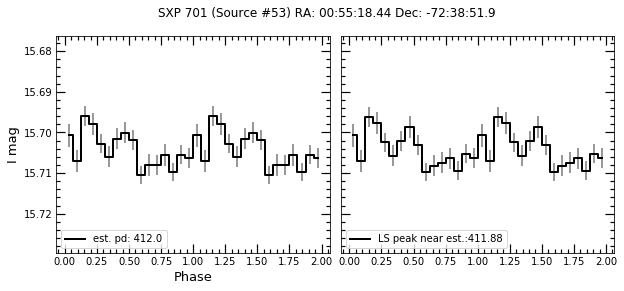

Repeating periodogram and phase-fold after detrending
Window shown in phase-fold: 824


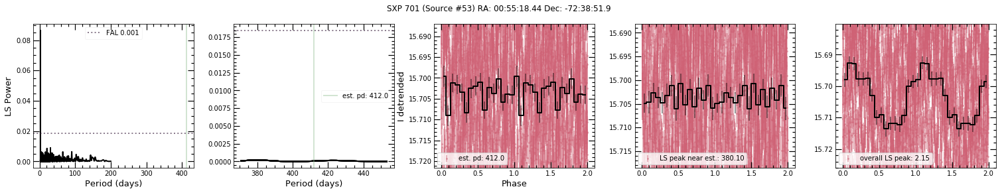

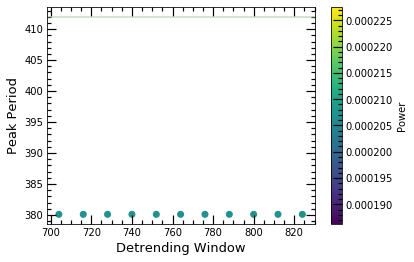

Comparing peaks of 0.1-2 day window function and detrended periodogram...
No peaks found so not searching for beat periods or aliases.


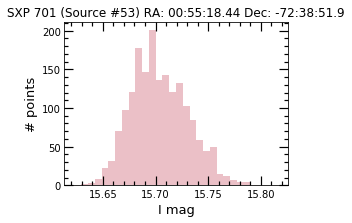



max I band:  15.816
min I band:  15.623
I range:  0.1930000000000014
I stdev:  0.026893917177306874
max V band:  16.131
min V band:  15.938
V range:  0.19299999999999962
V stdev:  0.034855399497007514


In [109]:
basic(49,pbins=16,saveall=save) 

Original source number: 59
Current source number: 54
RA,Dec (deg): 16.480871, -72.06368
Established period: nan
NS spin period: 726.0
Separation: 1.6814697416375097


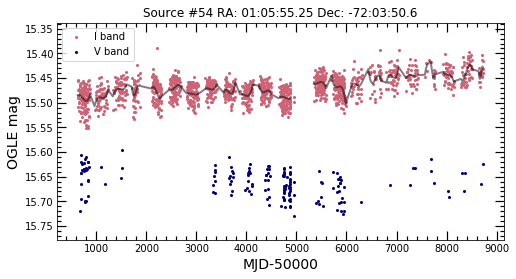

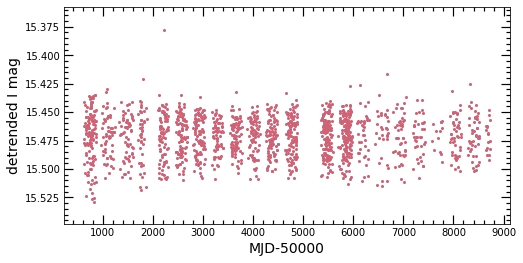

I and V-I correlation: -0.4396991513307721
V and V-I correlation: 0.7398436434797936


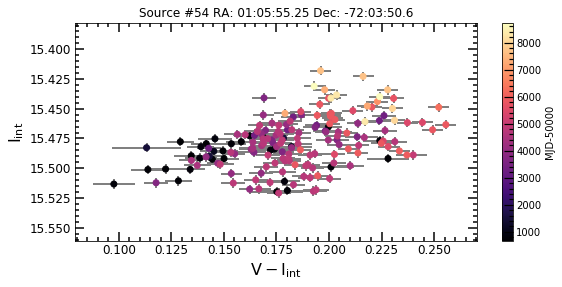

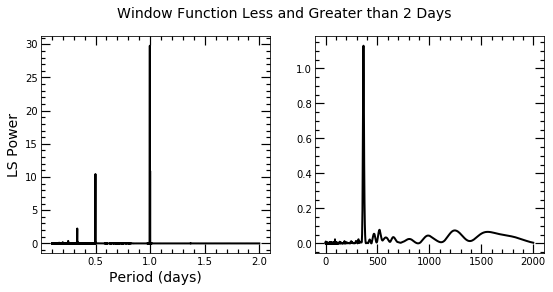

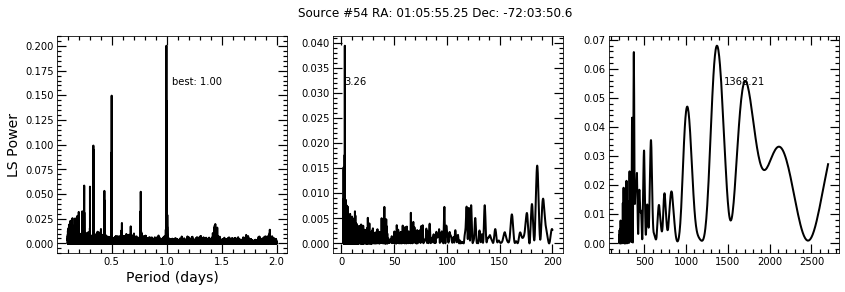

using best period from middle periodogram to phase-fold data, after detrending with 701
running periodogram on detrended data


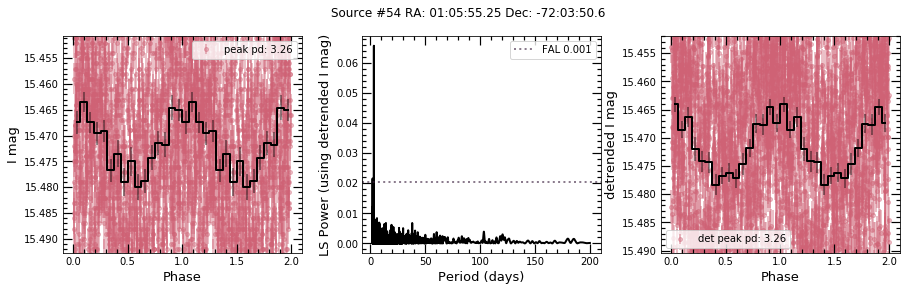

Comparing peaks of 0.1-2 day window function and detrended periodogram...
There is at least one alias of the 0.1-2 day detrended search within a day of 3.2623526378922225 days (the detrended peak).
There is at least one alias of the 0.1-2 day window function within a day of 3.2623526378922225 days (the detrended peak).


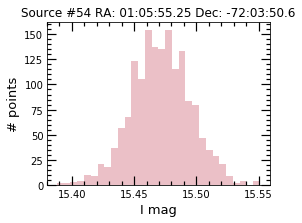



max I band:  15.551
min I band:  15.388
I range:  0.16300000000000026
I stdev:  0.023778889227362994
max V band:  15.729
min V band:  15.596
V range:  0.13299999999999912
V stdev:  0.02805078399400685


In [110]:
basic(50,pbins=16,saveall=save) 

Original source number: 60
Current source number: 55
RA,Dec (deg): 12.425474, -73.38738
Established period: 390.0
NS spin period: 755.5
Separation: 0.5314121167733278


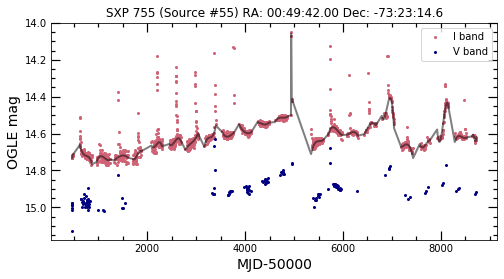

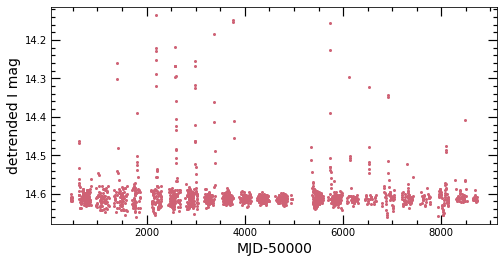

I and V-I correlation: -0.7903821327759735
V and V-I correlation: -0.572353612041409


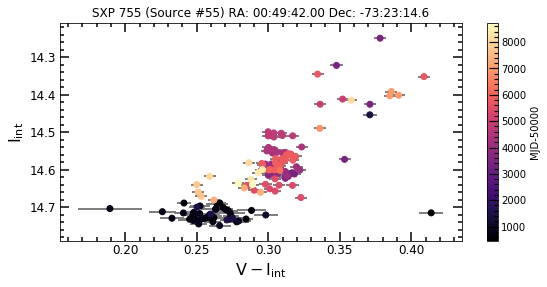

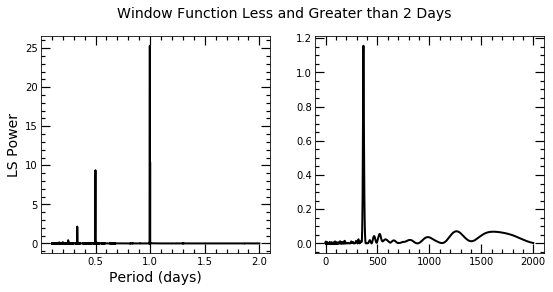

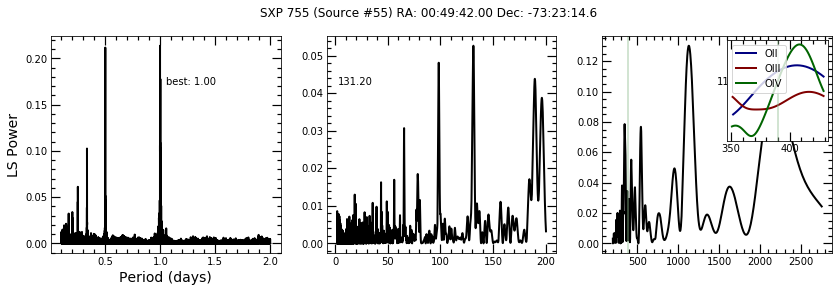

Phase-folding with established orbital period and highest peak within 39.00 days of that value...


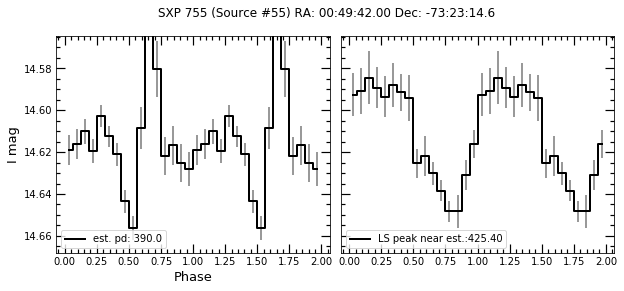

Repeating periodogram and phase-fold after detrending
Window shown in phase-fold: 780


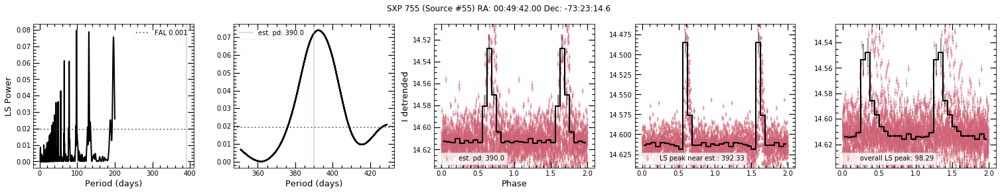

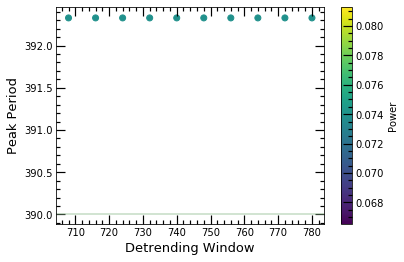

Comparing peaks of 0.1-2 day window function and detrended periodogram...
Beat period of highest peaks is 391.52551990522846.


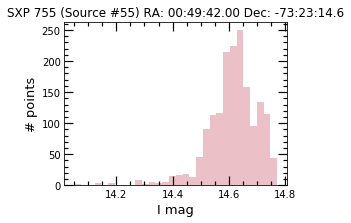



max I band:  14.773
min I band:  14.05
I range:  0.722999999999999
I stdev:  0.09112032412293081
max V band:  15.129
min V band:  14.628
V range:  0.5009999999999994
V stdev:  0.07230441818373819


In [111]:
basic(51,pbins=16,saveall=save) 

Original source number: 62
Current source number: 57
RA,Dec (deg): 15.527875, -71.68772
Established period: 101.94
NS spin period: 967.0
Separation: 0.21500342107582393


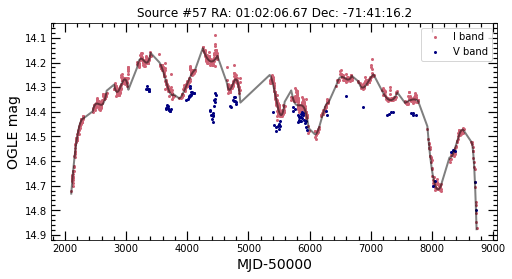

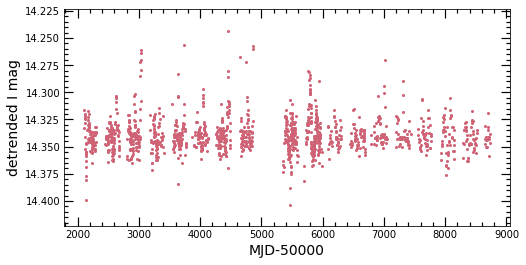

I and V-I correlation: -0.7709091623384245
V and V-I correlation: -0.4095687062907695


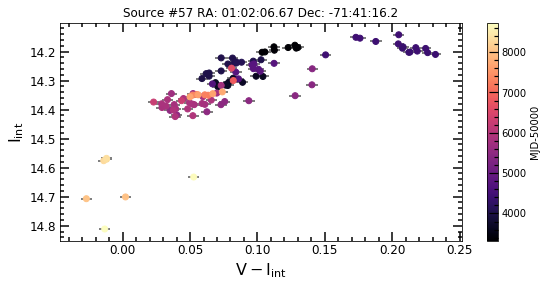

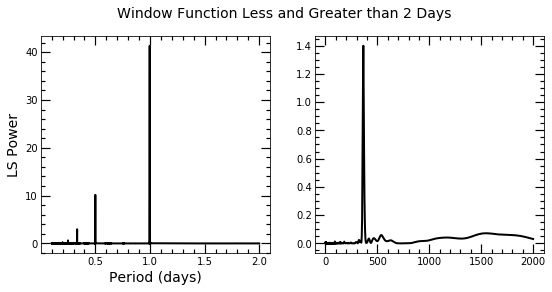

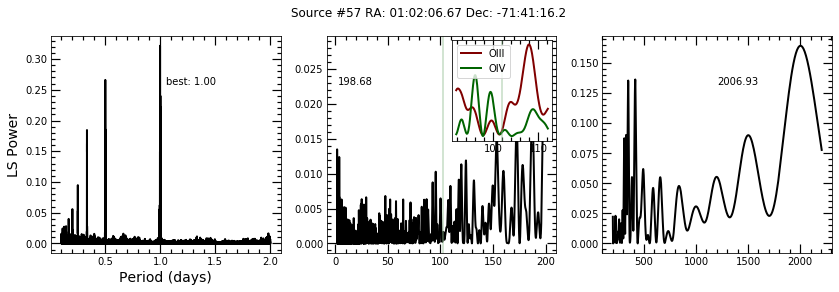

Phase-folding with established orbital period and highest peak within 10.19 days of that value...


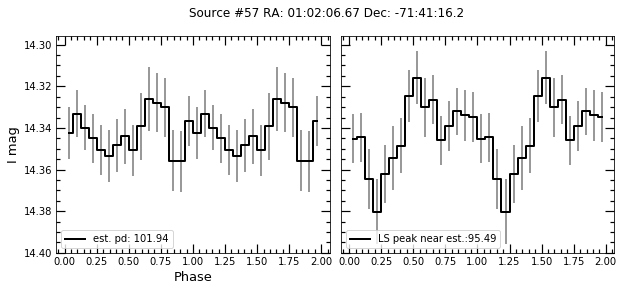

Repeating periodogram and phase-fold after detrending
Window shown in phase-fold: 203


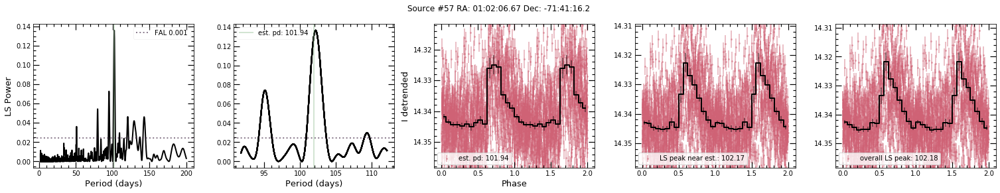

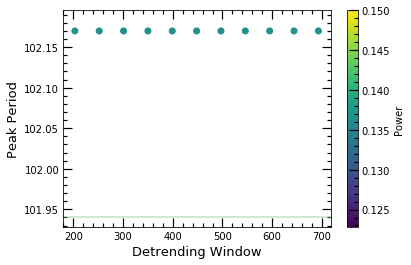

Comparing peaks of 0.1-2 day window function and detrended periodogram...
Beat period of highest peaks is 102.01588493530377.
There is at least one alias of the 0.1-2 day detrended search within a day of the established period.
There is at least one alias of the 0.1-2 day window function within a day of the established period.


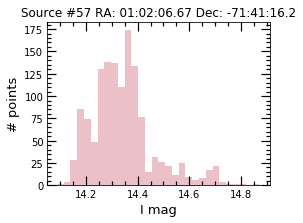



max I band:  14.872
min I band:  14.089
I range:  0.7829999999999995
I stdev:  0.12061247600828501
max V band:  14.798
min V band:  14.295
V range:  0.5030000000000001
V stdev:  0.08240343525619025


In [112]:
basic(52,pbins=16,saveall=save) 

Original source number: 63
Current source number: 58
RA,Dec (deg): 21.941542, -73.54903
Established period: nan
NS spin period: 1062.0
Separation: 0.13478893533990055


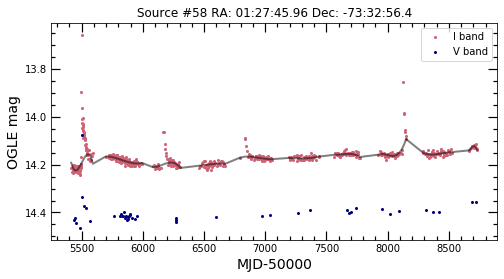

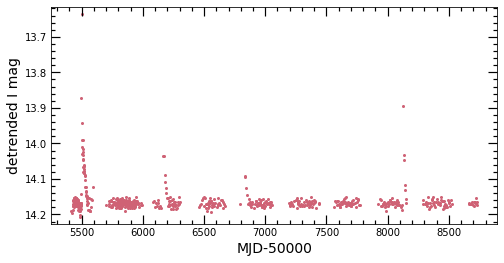

I and V-I correlation: -0.949075347309229
V and V-I correlation: -0.871228200471551


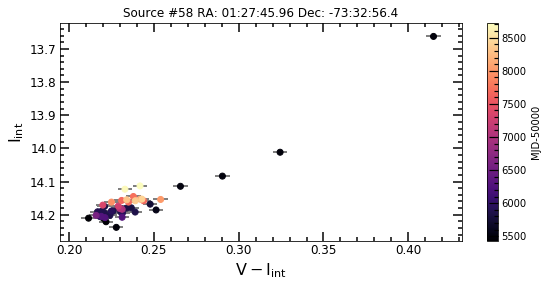

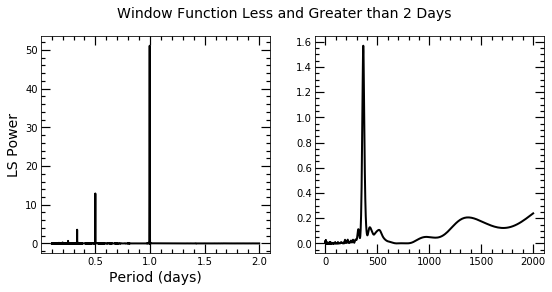

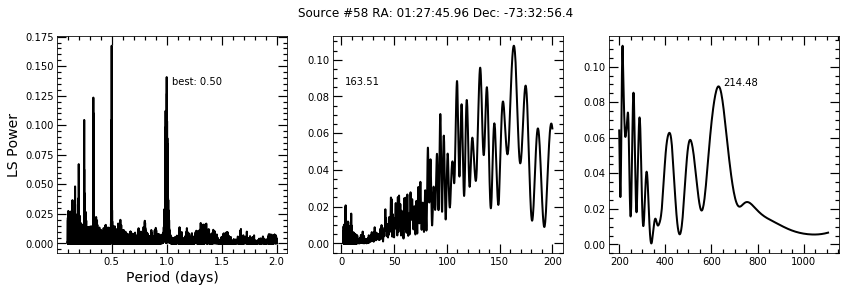

using best period from middle periodogram to phase-fold data, after detrending with 701
running periodogram on detrended data


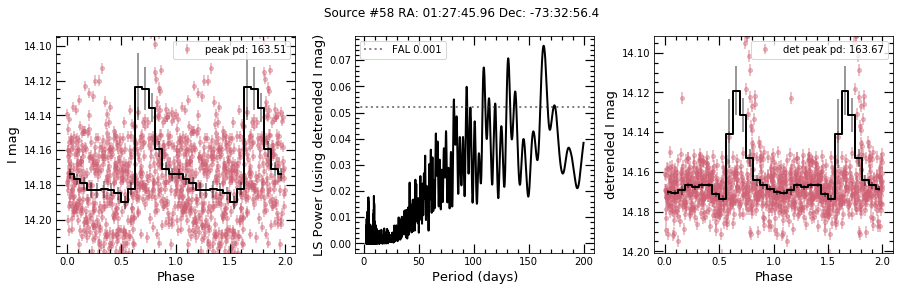

Comparing peaks of 0.1-2 day window function and detrended periodogram...


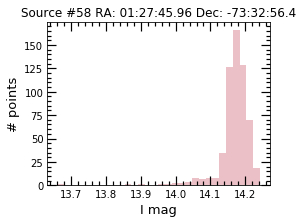



max I band:  14.242
min I band:  13.659
I range:  0.5830000000000002
I stdev:  0.04576946281649492
max V band:  14.466
min V band:  14.077
V range:  0.38899999999999935
V stdev:  0.053669946320042176


In [113]:
basic(53,pbins=16,saveall=save) 

Original source number: 64
Current source number: 59
RA,Dec (deg): 15.906292, -72.0258
Established period: nan
NS spin period: 1323.0
Separation: 0.3875389193454174


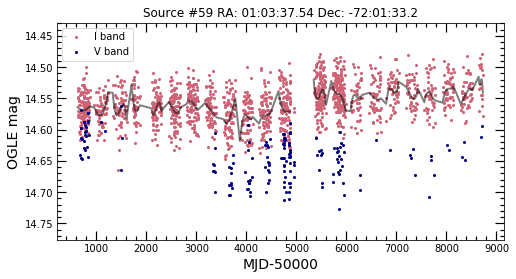

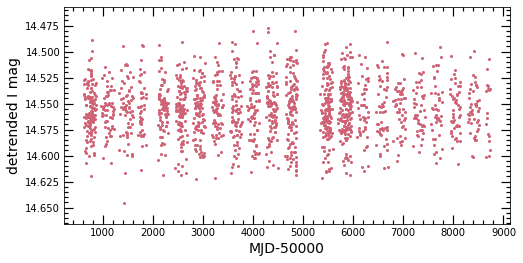

I and V-I correlation: -0.4388904144939015
V and V-I correlation: 0.5195263979783094


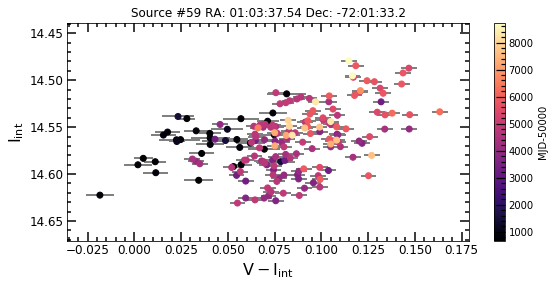

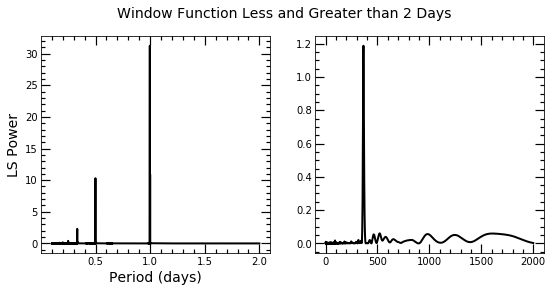

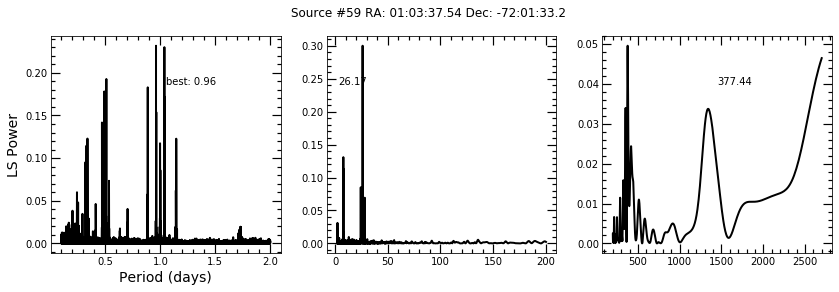

using best period from middle periodogram to phase-fold data, after detrending with 701
running periodogram on detrended data


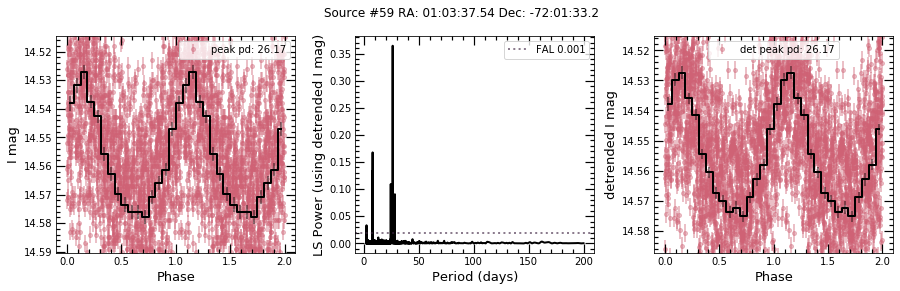

Comparing peaks of 0.1-2 day window function and detrended periodogram...
Beat period of highest peaks is 26.172391204601244.
There is at least one alias of the 0.1-2 day detrended search within a day of 26.17415389617869 days (the detrended peak).
There is at least one alias of the 0.1-2 day window function within a day of 26.17415389617869 days (the detrended peak).


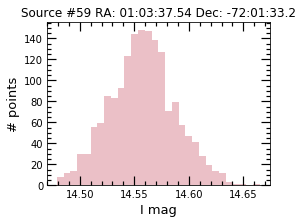



max I band:  14.665
min I band:  14.479
I range:  0.18599999999999994
I stdev:  0.02984407479612393
max V band:  14.727
min V band:  14.562
V range:  0.16500000000000092
V stdev:  0.03415353164324986


In [114]:
basic(54,pbins=16,saveall=save) #this period was found by Carpano et al. 2017

Original source number: 65
Current source number: 60
RA,Dec (deg): 13.692583, -72.42306
Established period: nan
NS spin period: 4693.0
Separation: 1.0349996195972824


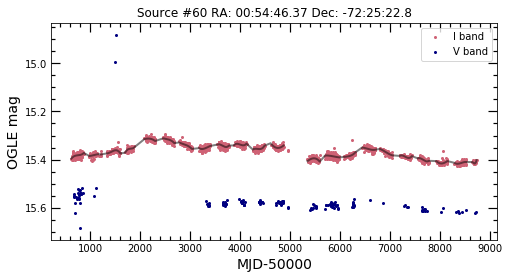

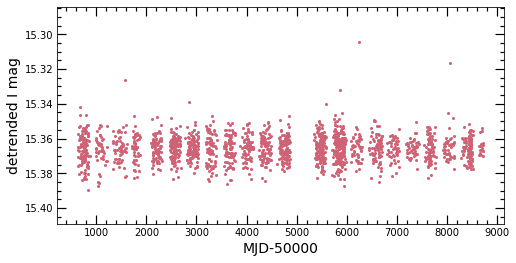

I and V-I correlation: -0.16860135254047037
V and V-I correlation: 0.951775471776383


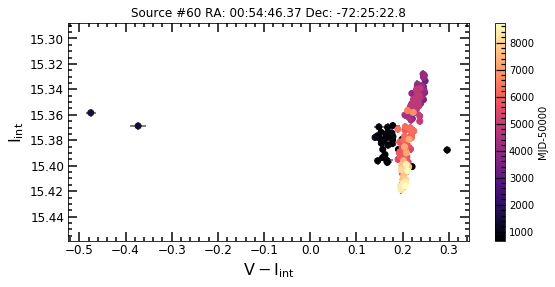

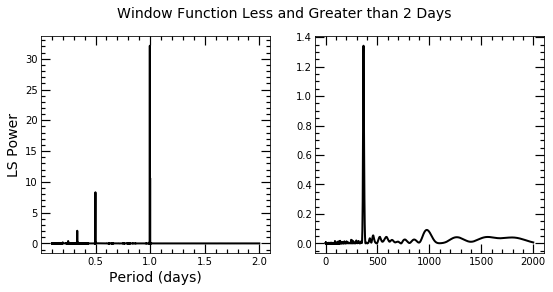

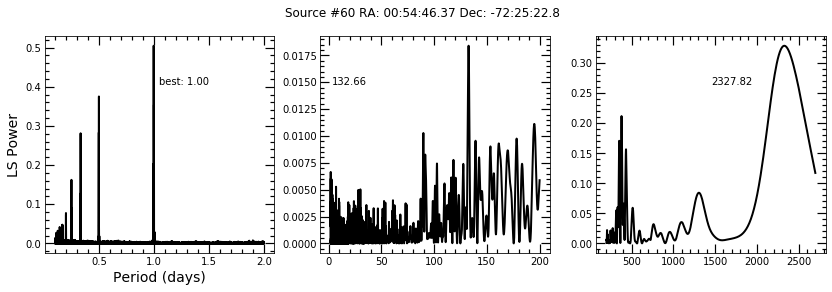

using best period from middle periodogram to phase-fold data, after detrending with 701
running periodogram on detrended data


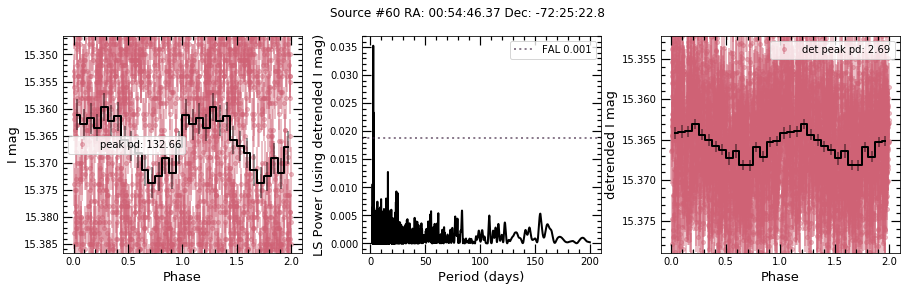

Comparing peaks of 0.1-2 day window function and detrended periodogram...
Beat period of highest peaks is 2.6844490502637797.
There is at least one alias of the 0.1-2 day detrended search within a day of 2.689007801864535 days (the detrended peak).
There is at least one alias of the 0.1-2 day window function within a day of 2.689007801864535 days (the detrended peak).


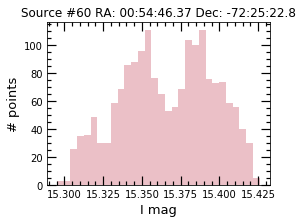



max I band:  15.426
min I band:  15.295
I range:  0.13100000000000023
I stdev:  0.02955587032997475
max V band:  15.684
min V band:  14.883
V range:  0.8010000000000002
V stdev:  0.07328052752461406


In [115]:
basic(55,pbins=16,saveall=save) 

Original source number: 125
Current source number: 98
RA,Dec (deg): 15.482444, -72.54349
Established period: 36.41
NS spin period: nan
Separation: 0.4561186471617218


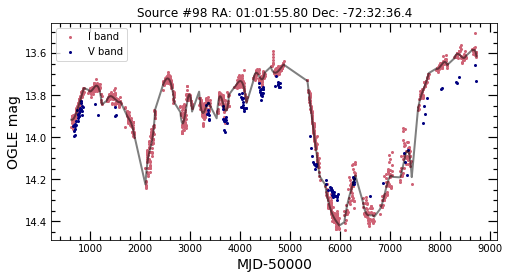

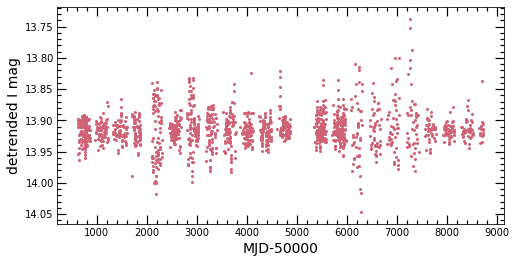

I and V-I correlation: -0.8744251563223343
V and V-I correlation: -0.7590429450237982


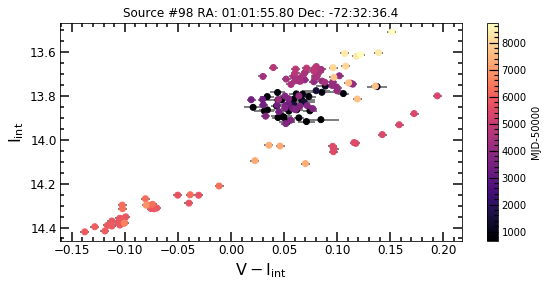

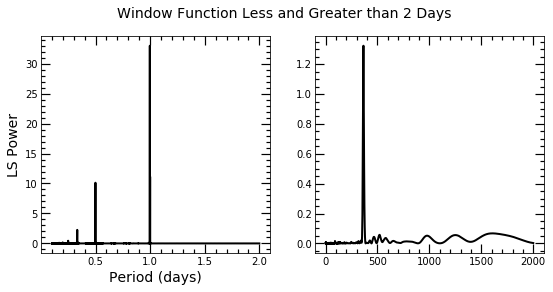

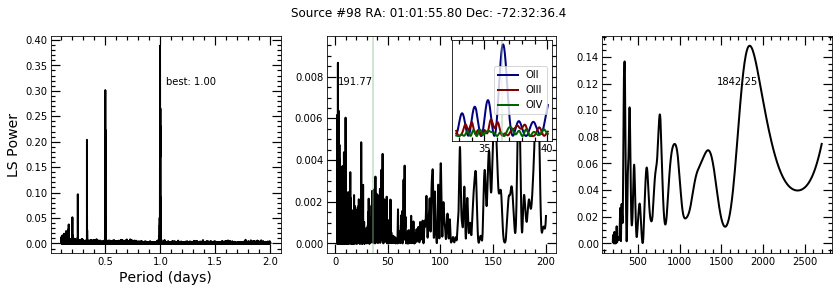

Phase-folding with established orbital period and highest peak within 3.64 days of that value...


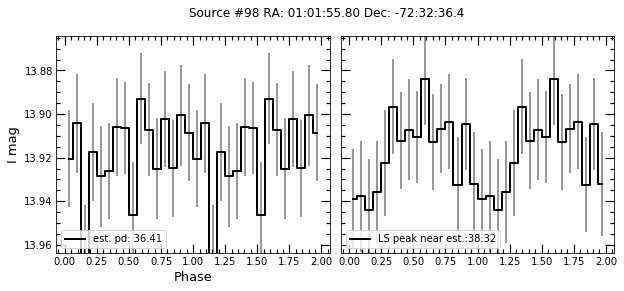

Repeating periodogram and phase-fold after detrending
Window shown in phase-fold: 134


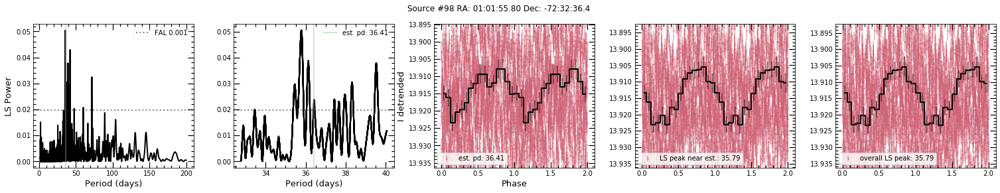

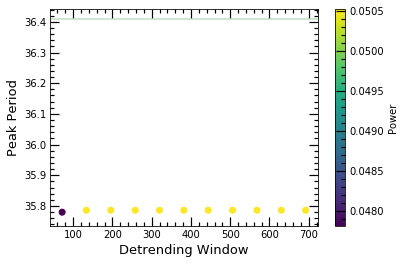

Comparing peaks of 0.1-2 day window function and detrended periodogram...
Beat period of highest peaks is 35.7402575837743.
There is at least one alias of the 0.1-2 day detrended search within a day of the established period.
There is at least one alias of the 0.1-2 day window function within a day of the established period.


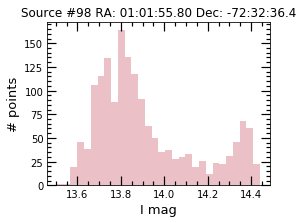



max I band:  14.44
min I band:  13.506
I range:  0.9339999999999993
I stdev:  0.22958150518580372
max V band:  14.297
min V band:  13.658
V range:  0.6390000000000011
V stdev:  0.1798246457259509


In [116]:
basic(56,pbins=16,saveall=save) 

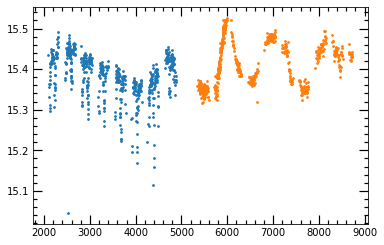

In [119]:
#but still be wary b/c transition happens between OGLE epochs
ilist,vlist = o.getIV(142,cross,stack=False)
for i in ilist:
    plt.scatter(i['MJD-50000'],i['I mag'],s=3)

Original source number: 142
Current source number: 108
RA,Dec (deg): 20.864399, -73.356514
Established period: 119.8
NS spin period: nan
Separation: 1.3645475547581647


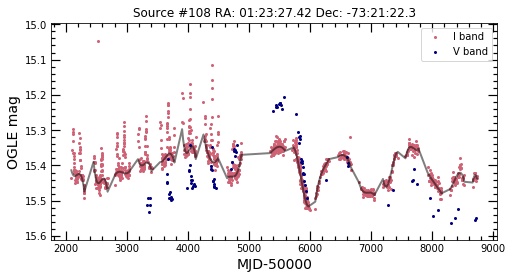

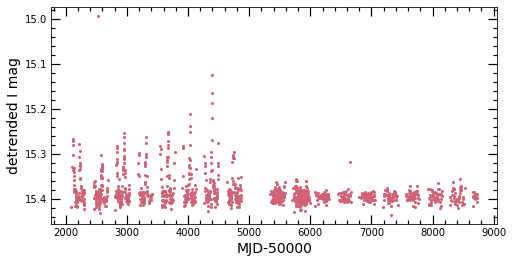

I and V-I correlation: -0.39587280551306564
V and V-I correlation: 0.7707790909498434


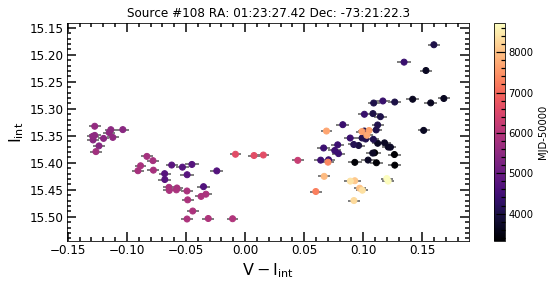

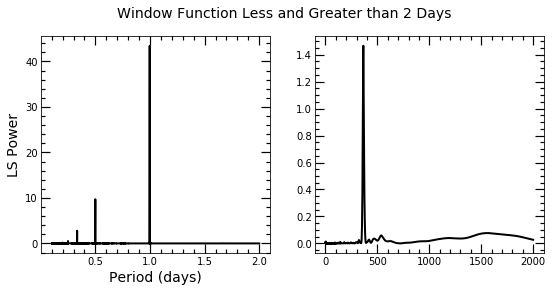

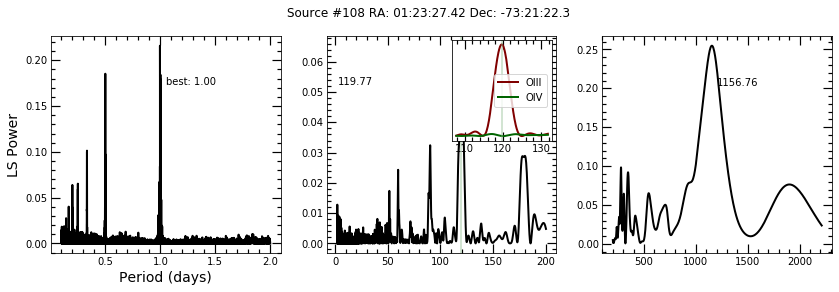

Phase-folding with established orbital period and highest peak within 11.98 days of that value...


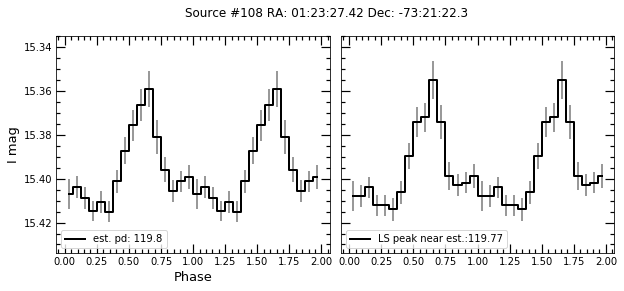

Repeating periodogram and phase-fold after detrending
Window shown in phase-fold: 239


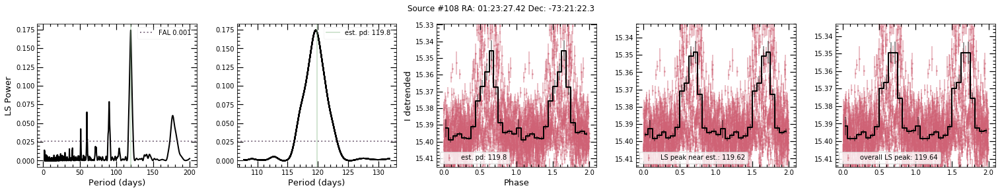

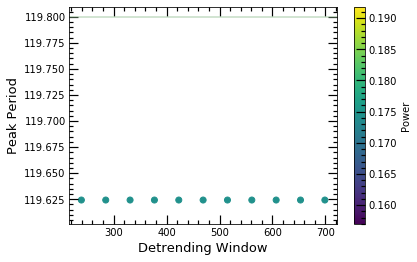

Comparing peaks of 0.1-2 day window function and detrended periodogram...
Beat period of highest peaks is 119.63630180179905.
There is at least one alias of the 0.1-2 day detrended search within a day of the established period.
There is at least one alias of the 0.1-2 day window function within a day of the established period.


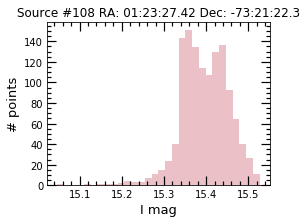



max I band:  15.527
min I band:  15.046
I range:  0.48099999999999987
I stdev:  0.05623848417344712
max V band:  15.562
min V band:  15.205
V range:  0.3569999999999993
V stdev:  0.08736986118639661


In [120]:
basic(57,pbins=16,saveall=save) #confirmed to NOT be different sources... so adding to analysis

## write out summary table and peak dictionary
- only rewrite peak dict if all sources run!

In [121]:
#write table back out
summ.to_csv('Feb23_summtab.csv',index=False)

In [122]:
#write out phase table
phase.to_csv('Feb23_phasetab.csv',index=False)

In [123]:
np.save('Feb23_part1peaks.npy', peak_dict)

# (old) basic analysis of summary table
- doesn't yet include sources that had error before (mostly b/c est. periods above 200 days)

- will continue with this analysis -- can just read tables back in

- write basic code to just check for correlations between all variables

I and V-I correlation: -0.883934340856408
V and V-I correlation: 0.6471296353848744


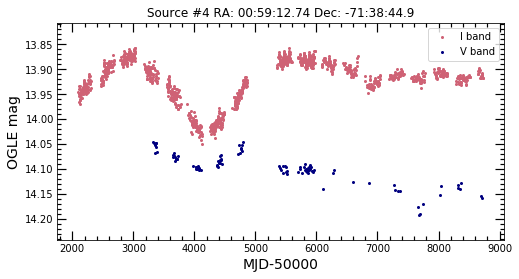

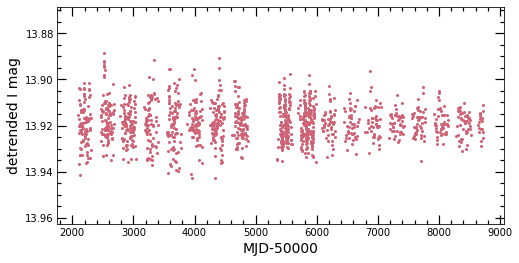

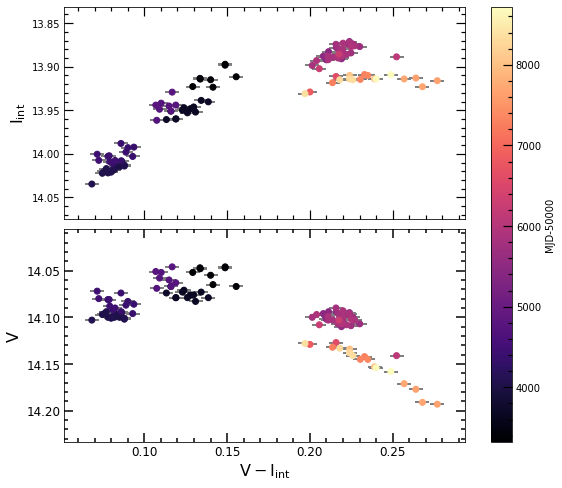

In [124]:
ilist,vlist = o.getIV(4,cross,plot=True,zooms=False,figsize=(8,4),mult=(3,8),offset=10,stack=False,save=False)
iband,vband = vstack(ilist),vstack(vlist)
    
#rspline detrending
flatten, trend = wotan.flatten(iband['MJD-50000'],iband['I mag'],method='rspline',window_length=200,break_tolerance=50,return_trend=True)
        
#add detrended column: original - trend + mean
mean = np.mean(iband['I mag'])
detr = iband['I mag'] - trend + mean
iband['I detrend'] = detr
#for periodogram, use temp table that takes out nan detrended values
itemp = iband[np.isnan(iband['I detrend'])==False]
#also ignore outliers by greater than a mag
plt.figure(figsize=(8,4))
plt.scatter(itemp['MJD-50000'],itemp['I detrend'],color=pink,s=4)
plt.ylabel('detrended I mag',fontsize=14)
plt.xlabel('MJD-50000',fontsize=14)
maxdet,mindet = np.max(itemp['I detrend']),np.min(itemp['I detrend'])
plt.ylim(maxdet+0.02,mindet-0.02)
    
#color-mag plots
interp = o.colormag(iband,vband,ctime=True,retint=True,figsize=(9,8),save=False) 

In [125]:
#fit V vs. V-I and I vs. V-I
i = interp[:700]
v = vband['V mag'][:700]
vi = v-i
mod = np.polyfit(vi,i,1)
mod2 = np.polyfit(vi,v,1)

In [126]:
mod[0]-mod2[0]

-1.0000000000000213

In [127]:
mod2[0]

0.3098876903070841

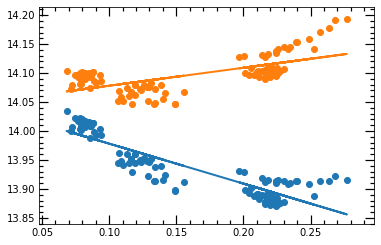

In [128]:
plt.scatter(vi,i)
plt.plot(vi,mod[0]*vi+mod[1])
plt.plot(vi,mod2[0]*vi+mod2[1])

plt.scatter(vi,v)

In [129]:
full[:4]

src_n,OGLE,RA_OGLE,DEC_OGLE,ra_deg,dec_deg,perr,period,Porb,_RAJ2000_1,_DEJ2000_1,__M2002_,Vmag_1,Separation_1,_RAJ2000_2,_DEJ2000_2,Vmag_2,recno,Separation
int64,str38,str11,str11,float64,float64,float64,float64,float64,float64,float64,int64,float64,float64,float64,float64,float64,int64,float64
1,OGLE,RA,DEC,19.271511,-73.443405,0.5,0.717,3.892,19.27120833333333,-73.44333333333334,77458,13.15,0.4041071611446303,19.271369999999997,-73.44318999999999,13.152,5068334,0.7879504646408463
2,SMC732.03 \#3540,01:21:40.61,-72:57:30.9,20.41893,-72.95907,2.0,2.165,84.0,20.418999999999993,-72.95847222222221,80352,14.28,2.147142505236131,--,--,--,--,--
3,SMC720.17 \#50,00:54:33.44,-73:41:01.3,13.639167,-73.68364,0.8,2.37,18.38,13.639333333333331,-73.68369444444444,30492,14.51,0.2597014565010407,13.639544999999995,-73.68356999999999,14.729,2675272,0.4570936647419033
4,SMC718.01 \#10792 & SMC725.25 \#11632,00:59:12.74,-71:38:44.9,14.797429,-71.64596,7.5,2.763,82.37,--,--,--,--,--,14.799299999999997,-71.64715999999999,20.381,3324857,4.819137958736795


In [130]:
len(summ)

109

In [131]:
summ.columns

Index(['src_n', 'ra_deg', 'dec_deg', 'spin period', 'perr', 'est. period',
       'sep', 'name', 'mean I', 'stdev I', 'max I', 'min I', 'I range',
       'mean V', 'stdev V', 'max V', 'min V', 'V range', 'est. period method',
       'best period', 'best superorbital', 'other period', 'period shape',
       'big dip', 'orbital cont', 'superorbital cont', 'mult superorbital',
       'changing superorbital amp', 'redder when brighter', 'I V-I corr',
       'V V-I corr', 'I V-I slope', 'I V-I int', 'V V-I slope', 'V V-I int',
       'V-I transition', 'Type II amp', 'note', 'I skew', 'I kurtosis',
       'V skew', 'V kurtosis', 'best auto det pd', 'Part', 'I IQR',
       'aperiodic quiescence', 'abs mean I vs. V-I residual',
       'mean abs faint residual', 'mean abs bright residual',
       'residual slope diff', 'bright res monotonic frac',
       'bright - faint slope'],
      dtype='object')

for sources that already had established period, compare to best period post-detrending (with max power from various windows)

In [132]:
def sf(file,dpi=200,fdir='Figs/'):
    plt.savefig(fdir+file+'.png',dpi=dpi,bbox_inches='tight')

Text(0, 0.5, 'Best Pd Post-Detrending')

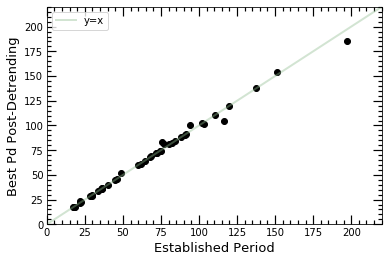

In [133]:
xs = np.arange(220)
nonzero = summ[summ['est. period']!=0]
nonzero = nonzero[nonzero['best auto det pd']!=0]

plt.scatter(nonzero['est. period'],nonzero['best auto det pd'],color='black')
plt.plot(xs,xs,color='darkseagreen',alpha=0.4,label='y=x')
plt.legend()
plt.ylim(0,220)
plt.xlim(0,220)
plt.xlabel('Established Period',fontsize=13)
plt.ylabel('Best Pd Post-Detrending',fontsize=13)
# sf('new_old_pds')

In [134]:
np.max(summ['est. period'])

1163.0

Text(0.5, 0, 'Established Period')

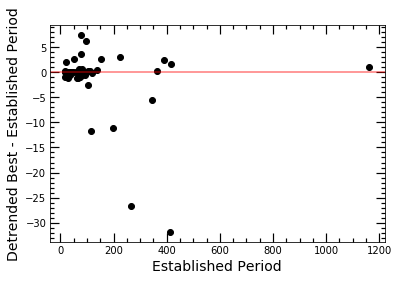

In [135]:
#residual plot (remember, though, that there's a restriction on how much it CAN change)
plt.scatter(nonzero['est. period'],nonzero['best auto det pd']-nonzero['est. period'],color='black')
plt.axhline(0,color='red',alpha=0.4)
plt.ylabel('Detrended Best - Established Period',fontsize=14)
plt.xlabel('Established Period',fontsize=14)

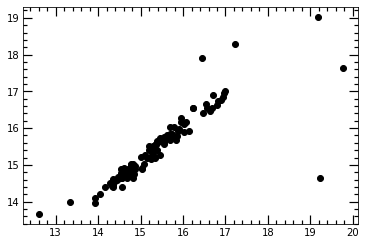

In [136]:
plt.scatter(summ['mean I'],summ['mean V'],color='black')

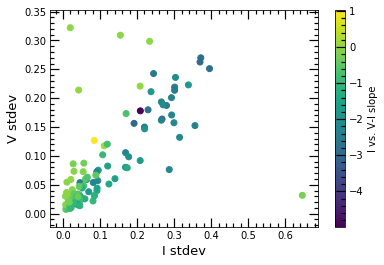

In [137]:
plt.scatter(summ['stdev I'],summ['stdev V'],c=summ['I V-I slope'])
plt.colorbar(label='I vs. V-I slope')
plt.ylabel('V stdev',fontsize=13)
plt.xlabel('I stdev',fontsize=13)
sf('I_V_stdev')

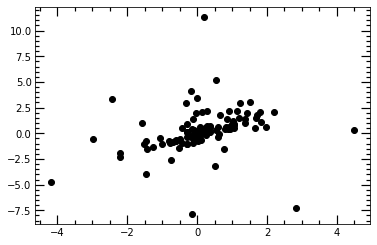

In [138]:
plt.scatter(summ['I skew'],summ['V skew'],color='black')

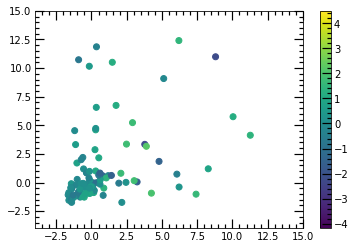

In [139]:
plt.scatter(summ['I kurtosis'],summ['V kurtosis'],c=summ['I skew'])
plt.ylim(-4,15)
plt.xlim(-4,15)
plt.colorbar()

Corbet

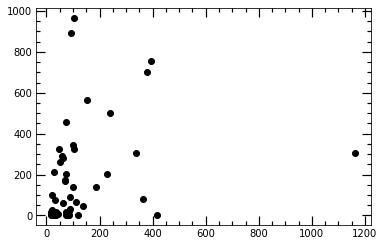

In [140]:
plt.scatter(nonzero['best auto det pd'],nonzero['spin period'],color='black')
